## Table of Content

1. **[Cleaning the data](#clean)**
2. **[Dropping the columns](#drop)**
3. **[Changing datatypes of columns](#change)**
4. **[Missing Value Imputation](#miss)**
5. **[Dividing Location in to Latitude and Longitutude](#long)**
6. **[Checking for duplicates](#dup)**
7. **[Treating Outliers](#out)**
8. **[Handling Skewness](#skew)**
9. **[Variance Threshold](#var)**
10. **[Uni-variate Analysis](#uni)**
11. **[Bi-variate Analysis](#biv)**
12. **[Multi-variate Analysis](#mul)**
13. **[Statistics](#stats)**
14. **[Checking Correlation](#corr)**
15. **[Pairplot](#pair)**
16. **[Label Encoding](#lab)**
17. **[Scaling](#scale)**
18. **[Clustering](#clus)**
19. **[Undersampling](#und)**
20. **[Performing Train Test split](#split)**
21. **[Building Base Models](#base)**
    - 21.1 - **[Logistic Regression](#lr)**
    - 21.2 - **[Decision Tree Classifier](#dt)**
    - 21.3 - **[Random Forest Classifier](#rf)**
    - 21.4 - **[K Nearest Neighbors](#knn)**
    - 21.5 - **[Naive Bayes Algorithm](#gnb)**
    - 21.6 - **[AdaBoost](#ada)**
    - 21.7 - **[Gradient Boosting](#gbs)**
    - 21.8 - **[XGBoost](#xgb)**
22. **[Performing Feature Selection](#fs)**
    - 22.1 - **[Removing Multi-collinearity](#vif)**
    - 22.2 - **[Forward Selection](#for)**
    - 22.3 - **[Backward Elimination](#back)**
    - 22.4 - **[Recursive Feature Elimination](#rfe)**
    - 22.5 - **[Feature Importances](#feat)**
23. **[Tuning the hyperparameters using all features](#tuneall)**
    - 23.1 - **[Logistic Regression](#lra)**
    - 23.2 - **[Decision Tree Classifier](#dta)**
    - 23.3 - **[Random Forest Classifier](#rfa)**
    - 23.4 - **[K Nearest Neighbors](#knna)**
    - 23.5 - **[AdaBoost](#adaa)**
    - 23.6 - **[Gradient Boosting](#gbsa)**
    - 23.7 - **[XGBoost](#xgba)**
24. **[Tuning the hyperparameters with Feature Selection](#tune)**
    - 23.1 - **[Logistic Regression](#lrt)**
    - 23.2 - **[Decision Tree Classifier](#dtt)**
    - 23.3 - **[Random Forest Classifier](#rft)**
    - 23.4 - **[K Nearest Neighbors](#knnt)**
    - 23.5 - **[AdaBoost](#adat)**
    - 23.6 - **[Gradient Boosting](#gbst)**
    - 23.7 - **[XGBoost](#xgbt)**
25. **[All scores](#scores)**
26. **[Final Model Selection](#final)**
27. **[Summarizing the Final Model](#summ)**
28. **[Business Interpretation](#buss)**
29. **[Changes done in Base Model to achieve Final Model](#change)**
30. **[Key Risks in interpreting Final Model](#key)**

In [1]:
### importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from warnings import filterwarnings
filterwarnings('ignore')
from sklearn.preprocessing import PowerTransformer
from sklearn.feature_selection import VarianceThreshold, RFECV
pd.set_option('display.max_columns', None)
import plotly
import plotly.express as px
import statsmodels.api as sm
from sklearn.decomposition import PCA,KernelPCA
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split , cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler, PowerTransformer
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier, StackingClassifier
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.cm as cm
from sklearn.cluster import AgglomerativeClustering 
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import pdist
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report , accuracy_score , roc_auc_score , roc_curve , confusion_matrix,f1_score
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from statsmodels.stats.outliers_influence import variance_inflation_factor
from mlxtend.feature_selection import SequentialFeatureSelector as sfs
from imblearn.under_sampling import OneSidedSelection
from collections import Counter
from imblearn.under_sampling import TomekLinks
from imblearn.under_sampling import NeighbourhoodCleaningRule
from imblearn.under_sampling import NearMiss
from imblearn.under_sampling import CondensedNearestNeighbour
from imblearn.under_sampling import EditedNearestNeighbours

In [2]:
### reading the dataset
df = pd.read_csv('Updated_Building_Permits.csv')
df.head()

,Unnamed: 0,Permit Number,Permit Type,Permit Type Definition,Permit Creation Date,Block,Lot,Street Number,Street Number Suffix,Street Name,Street Suffix,Unit,Unit Suffix,Description,Current Status,Current Status Date,Filed Date,Issued Date,Completed Date,First Construction Document Date,Structural Notification,Number of Existing Stories,Number of Proposed Stories,Voluntary Soft-Story Retrofit,Fire Only Permit,Permit Expiration Date,Estimated Cost,Revised Cost,Existing Use,Existing Units,Proposed Use,Proposed Units,Plansets,TIDF Compliance,Existing Construction Type,Existing Construction Type Description,Proposed Construction Type,Proposed Construction Type Description,Site Permit,Supervisor District,Neighborhoods - Analysis Boundaries,Zipcode,Location,Record ID
0,0,201505065519,4,sign - erect,05/06/2015,0326,023,140,NaN,Ellis,St,NaN,NaN,"ground fl facade: to erect illuminated, electr...",expired,12/21/2017,05/06/2015,11/09/2015,NaN,11/09/2015,NaN,6.0,NaN,NaN,NaN,11/03/2016,4000.0,4000.0,tourist hotel/motel,143.0,NaN,NaN,2.0,NaN,3.0,constr type 3,NaN,NaN,Y,3.0,Tenderloin,94102.0,"(37.785719256680785, -122.40852313194863)",1380611233945
1,1,201604195146,4,sign - erect,04/19/2016,0306,007,440,NaN,Geary,St,0.0,NaN,remove (e) awning and associated signs.,issued,08/03/2017,04/19/2016,08/03/2017,NaN,08/03/2017,NaN,7.0,NaN,NaN,NaN,12/03/2017,1.0,500.0,tourist hotel/motel,NaN,NaN,NaN,2.0,NaN,3.0,constr type 3,NaN,NaN,Y,3.0,Tenderloin,94102.0,"(37.78733980600732, -122.41063199757738)",1420164406718
2,2,201605278609,3,additions alterations or repairs,05/27/2016,0595,203,1647,NaN,Pacific,Av,NaN,NaN,installation of separating wall,withdrawn,09/26/2017,05/27/2016,NaN,NaN,NaN,NaN,6.0,6.0,NaN,NaN,NaN,20000.0,NaN,retail sales,39.0,retail sales,39.0,2.0,NaN,1.0,constr type 1,1.0,constr type 1,N,3.0,Russian Hill,94109.0,"(37.7946573324287, -122.42232562979227)",1424856504716
3,3,201611072166,8,otc alterations permit,11/07/2016,0156,011,1230,NaN,Pacific,Av,0.0,NaN,repair dryrot & stucco at front of bldg.,complete,07/24/2017,11/07/2016,07/18/2017,07/24/2017,07/18/2017,NaN,2.0,2.0,NaN,NaN,07/13/2018,2000.0,2000.0,1 family dwelling,1.0,1 family dwelling,1.0,2.0,NaN,5.0,wood frame (5),5.0,wood frame (5),Y,3.0,Nob Hill,94109.0,"(37.79595867909168, -122.41557405519474)",1443574295566
4,4,201611283529,6,demolitions,11/28/2016,0342,001,950,NaN,Market,St,NaN,NaN,demolish retail/office/commercial 3-story buil...,issued,12/01/2017,11/28/2016,12/01/2017,NaN,11/20/2017,NaN,3.0,NaN,NaN,NaN,12/01/2018,100000.0,100000.0,retail sales,NaN,NaN,NaN,2.0,NaN,3.0,constr type 3,NaN,NaN,Y,6.0,Tenderloin,94102.0,"(37.78315261897309, -122.40950883997789)",144548169992


<a id="clean"></a>
## 1. Cleaning the data

### Permit Number

In [3]:
df['Permit Number'].value_counts()

201602179765    101
201602179758     66
201602179775     30
201702239990      9
201409166451      9
               ... 
201612074328      1
M856287           1
201707273041      1
201601066437      1
201311121633      1
Name: Permit Number, Length: 181495, dtype: int64

<b> Inference: </b>
1. As we can see, there are many records with duplicate Permit Numbers.
2. So, we are keeping only those records where the data is recent for that Permit Number. 
3. The recentness of the data for the mentioned Permit Number is decided on the basis of Record ID

In [4]:
## creating a list of all recent Record IDs for all Permit Numbers
list_record = []
for i in df['Permit Number'].unique():
    list_record.append(df[(df['Permit Number'] == i)]['Record ID'].max())

#### Since, above code takes much time, directly download List_record.csv
df_list = pd.DataFrame(list_record,columns=['List_record'])

df_list.to_csv('List_record.csv')

df_list_2 = pd.read_csv('List_record.csv')

list_record_2 = list(df_list_2['List_record'])

In [4]:
len(list_record)

181495

In [5]:
df = df[df['Record ID'].isin(list_record)]

In [6]:
df.shape

(181495, 44)

<a id="drop"></a>
## 2. Dropping the columns

In [10]:
((df.isnull().sum() /len(df)) * 100).sort_values(ascending=False)

TIDF Compliance                           99.998898
Voluntary Soft-Story Retrofit             99.986226
Unit Suffix                               99.034684
Street Number Suffix                      98.999972
Structural Notification                   96.612579
Fire Only Permit                          90.320395
Unit                                      85.484449
Completed Date                            50.995344
Existing Units                            26.339018
Proposed Units                            26.243698
Permit Expiration Date                    26.107055
Proposed Construction Type Description    22.108598
Proposed Construction Type                22.108598
Number of Proposed Stories                21.954875
Existing Construction Type Description    21.943855
Existing Construction Type                21.943855
Proposed Use                              21.730075
Number of Existing Stories                21.654040
Existing Use                              20.840795
Estimated Co

<b> Inference: </b>
1. The columns TIDF Compliance, Street Number Prefix , Unit, Structural Notification, Voluntary Soft-Story Retrofit, Fire Only Permit and Unit Suffix have null values greater than 85%. Also, they don't have much relevance. Hence, those columns can be deleted
2. The columns Permit Number, Description and Record ID are unique. So, those columns will not contribute in classification. Hence, those columns can be deleted
3. The columns Description, Existing Construction Type Description and Proposed Construction Type Description have already have their relevant label encoded columns. So, those columns can also be deleted.
4. All the date columns are irrelevant for our classification problem. Hence, dropping those columns as well
5. Dropping columns Block, Lot, Street Number, Street Name and Zipcode as well, since we have all other required details related to address and location

In [11]:
df = df.drop(['Unnamed: 0','Permit Number' , 'Permit Type Definition','Description','TIDF Compliance',
              'Existing Construction Type Description','Proposed Construction Type Description','Record ID',
             'Street Number Suffix','Unit','Unit Suffix','Issued Date','First Construction Document Date',
              'Permit Expiration Date','Structural Notification','Voluntary Soft-Story Retrofit','Fire Only Permit',
             'Permit Creation Date','Completed Date','Current Status Date','Filed Date','Block','Lot','Street Number',
             'Street Name','Zipcode'],axis=1)
df.shape

(181495, 18)

<a id="change"></a>
## 3. Changing datatypes of columns

In [12]:
## other columns
df['Permit Type'] = df['Permit Type'].astype('object')
df['Existing Construction Type'] = df['Existing Construction Type'].astype('object')
df['Proposed Construction Type'] = df['Proposed Construction Type'].astype('object')
df['Plansets'] = df['Plansets'].astype('object')

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 181495 entries, 0 to 198899
Data columns (total 18 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   Permit Type                          181495 non-null  object 
 1   Street Suffix                        178840 non-null  object 
 2   Current Status                       181495 non-null  object 
 3   Number of Existing Stories           142194 non-null  float64
 4   Number of Proposed Stories           141648 non-null  float64
 5   Estimated Cost                       146305 non-null  float64
 6   Revised Cost                         176155 non-null  float64
 7   Existing Use                         143670 non-null  object 
 8   Existing Units                       133691 non-null  float64
 9   Proposed Use                         142056 non-null  object 
 10  Proposed Units                       133864 non-null  float64
 11  Plansets     

<a id="miss"></a>
## 4. Missing Value Imputation

In [7]:
# your turn! Find out what percent of the sf_permits dataset is missing
sf_col_missing_count = df.isnull().sum()
sf_col_nomissing_count = df.notnull().sum()
sf_col_count = pd.DataFrame({"Valid":sf_col_nomissing_count,"Missing":sf_col_missing_count})

Text(0.5, 1.0, 'Dataset Missing numbers - San Francisco Building Permits ')

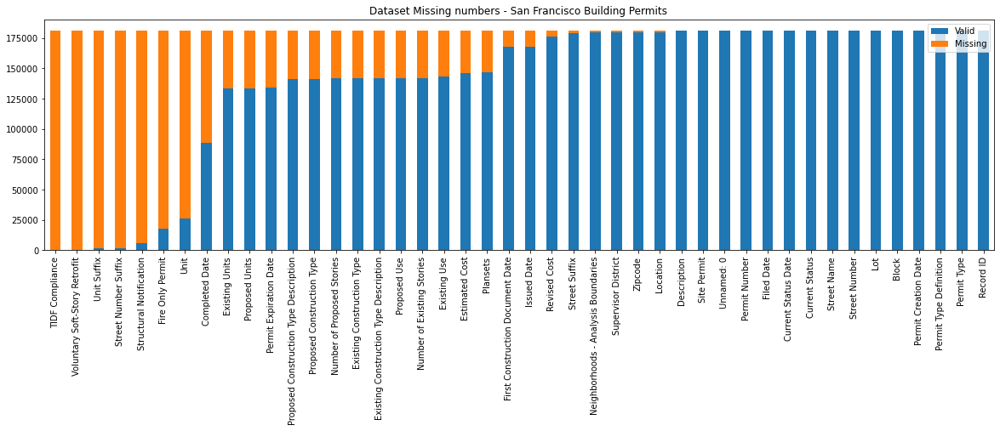

In [8]:
ax = sf_col_count.sort_values(by="Missing",ascending =False).plot.bar(stacked=True,figsize = (20,5),rot=90)
ax.set_title("Dataset Missing numbers - San Francisco Building Permits ")

In [14]:
((df.isnull().sum() /len(df)) * 100).sort_values(ascending=False)

Existing Units                         26.339018
Proposed Units                         26.243698
Proposed Construction Type             22.108598
Number of Proposed Stories             21.954875
Existing Construction Type             21.943855
Proposed Use                           21.730075
Number of Existing Stories             21.654040
Existing Use                           20.840795
Estimated Cost                         19.388964
Plansets                               18.990606
Revised Cost                            2.942230
Street Suffix                           1.462850
Neighborhoods - Analysis Boundaries     0.889832
Supervisor District                     0.885424
Location                                0.876057
Current Status                          0.000000
Site Permit                             0.000000
Permit Type                             0.000000
dtype: float64

In [15]:
df[df['Permit Type'] == 1]['Existing Use'].value_counts().values.size

0

There are no values of Existing Use in Permit Type  0
There are no values of Existing Use in Permit Type  1


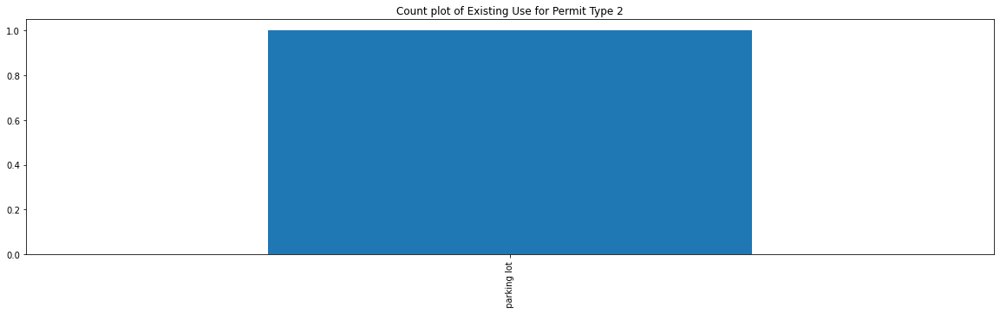

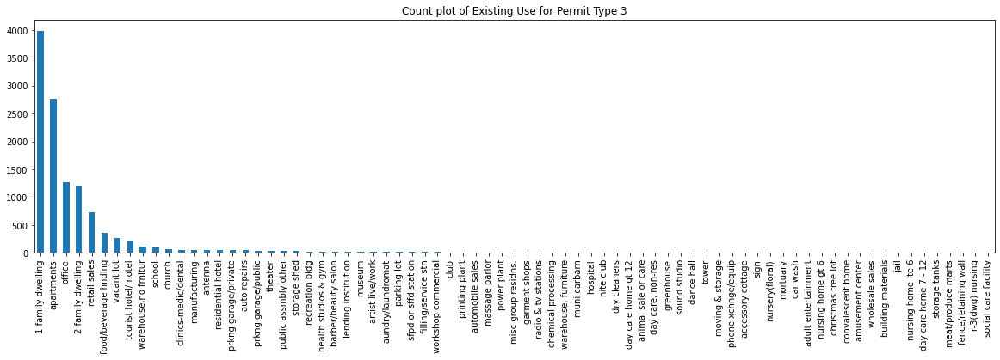

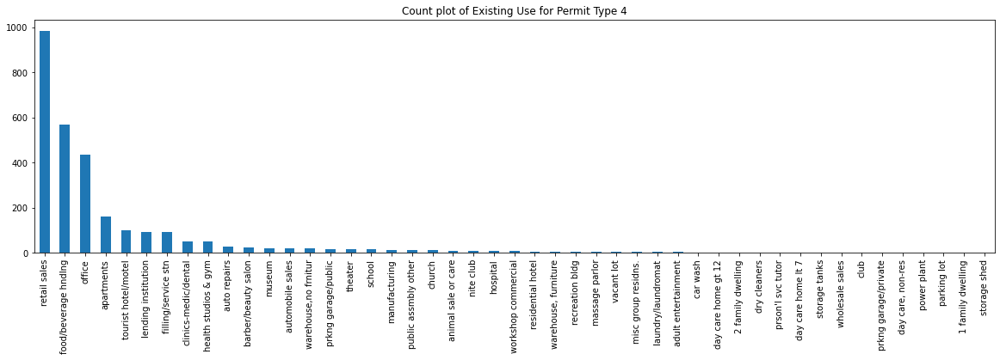

There are no values of Existing Use in Permit Type  5


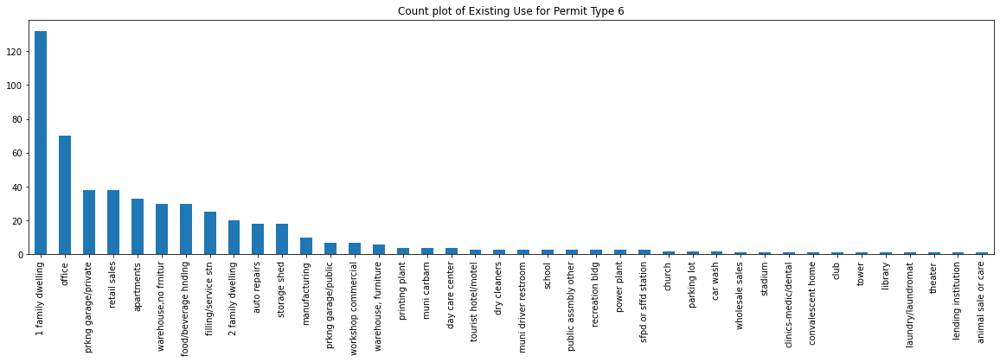

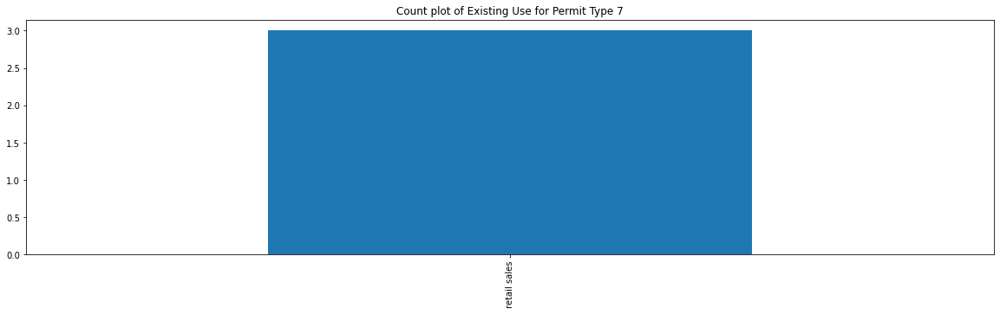

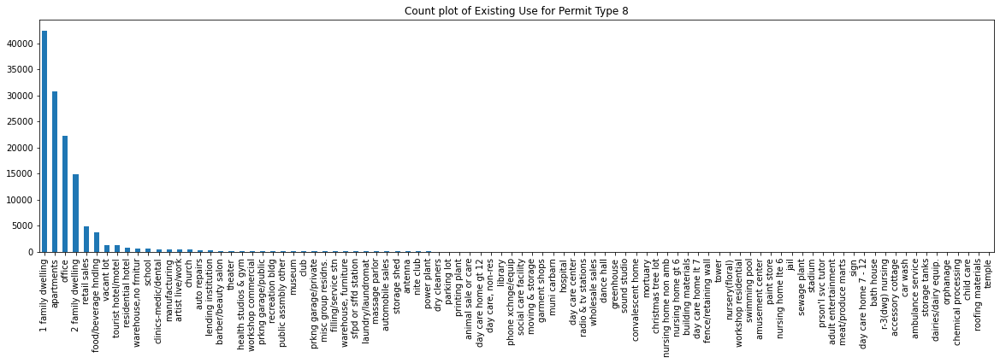

In [18]:
for i in range(9):
    if df[df['Permit Type'] == i]['Existing Use'].value_counts().values.size != 0 :
        plt.figure(figsize=(20,5))
        df[df['Permit Type'] == i]['Existing Use'].value_counts().plot(kind='bar')
        title_c = 'Count plot of Existing Use for Permit Type ' + str(i)
        plt.title(title_c)
        plt.show()
    else:
        print("There are no values of Existing Use in Permit Type ",i)

### 1. Existing Use

1. Existing Use is a categorical variable with around 93 unique values.
2. So, instead of simply updating it with it's mode value directly, we found an approach to update it's null value with the mode value of it's mentioned Permit Type`

In [16]:
## getting mode of Existing Use based on Permit type
dict1 = {}
for i in range(9):
    if df[(df['Permit Type'] == i)]['Existing Use'].mode().values.size != 0 :
        dict1[i] = df[(df['Permit Type'] == i)]['Existing Use'].mode().values[0]
    else:
        dict1[i] = df['Existing Use'].mode().values[0]
dict1

{0: '1 family dwelling',
 1: '1 family dwelling',
 2: 'parking lot',
 3: '1 family dwelling',
 4: 'retail sales',
 5: '1 family dwelling',
 6: '1 family dwelling',
 7: 'retail sales',
 8: '1 family dwelling'}

In [17]:
df['Existing Use'].isnull().sum()

37825

In [18]:
## Creating a list containing all valid values of Existing Use
list_use=[]
for permit_type,exist_use in df[['Permit Type' , 'Existing Use']].values:
    if pd.isnull(exist_use):
        list_use.append(dict1[permit_type])
    else:
        list_use.append(exist_use)

In [19]:
df['Existing Use'] = list_use   ## Updating the Existing Use column with the newly created list

In [20]:
df['Existing Use'].isnull().sum()

0

Null values in Existing Use column are handled

### 2. Number of Existing Storeys

In [21]:
df['Number of Existing Stories'].min()

0.0

In [22]:
df['Number of Existing Stories'].max()

78.0

1. Number of Existing Stories is a numeric variable with discrete values ranging from 0 to 78.
2. So, instead of simply updating it with it's mode value directly, we found an approach to update it's null value with the mode value of it's mentioned Existing Use

In [23]:
## getting mode of Number of Existing Storeys based on Existing Use
dict2 = {}
for i in df['Existing Use'].unique():
    if df[(df['Existing Use'] == i)]['Number of Existing Stories'].mode().values.size != 0 :
        dict2[i] = df[(df['Existing Use'] == i)]['Number of Existing Stories'].mode().values[0]
    else:
        dict2[i] = df['Number of Existing Stories'].mode().values[0]

In [24]:
df['Number of Existing Stories'].isnull().sum()

39301

In [25]:
## Creating a list containing all valid values of Number of Existing Stories
list_storey=[]
for exist_use,no_of_storey in df[['Existing Use' , 'Number of Existing Stories']].values:
    if pd.isnull(no_of_storey):
        list_storey.append(dict2[exist_use])
    else:
        list_storey.append(no_of_storey)

In [26]:
df['Number of Existing Stories'] = list_storey   ## Updating the Number of Existing Stories column with the newly created list

In [27]:
df['Number of Existing Stories'].isnull().sum()

0

Null values in Number of Existing Stories column are handled

### 3. Proposed Use

1. Proposed Use is a categorical variable with around 93 unique values.
2. So, instead of simply updating it with it's mode value directly, we found an approach to update it's null value with the mode value of it's mentioned Permit Type

In [28]:
## getting mode of Proposed Use based on Permit type
dict1p = {}
for i in range(9):
    if df[(df['Permit Type'] == i)]['Proposed Use'].mode().values.size != 0 :
        dict1p[i] = df[(df['Permit Type'] == i)]['Proposed Use'].mode().values[0]
    else:
        dict1p[i] = df['Proposed Use'].mode().values[0]
dict1

{0: '1 family dwelling',
 1: '1 family dwelling',
 2: 'parking lot',
 3: '1 family dwelling',
 4: 'retail sales',
 5: '1 family dwelling',
 6: '1 family dwelling',
 7: 'retail sales',
 8: '1 family dwelling'}

In [29]:
df['Proposed Use'].isnull().sum()

39439

In [30]:
## Creating a list containing all valid values of Proposed Use
list_puse=[]
for permit_type,pro_use in df[['Permit Type' , 'Proposed Use']].values:
    if pd.isnull(pro_use):
        list_puse.append(dict1p[permit_type])
    else:
        list_puse.append(pro_use)

In [31]:
df['Proposed Use'] = list_puse   ## Updating the Proposed Use column with the newly created list

In [32]:
df['Proposed Use'].isnull().sum()

0

Null values in Proposed Use column are handled

### 4. Number of Proposed Storeys

In [33]:
df['Number of Proposed Stories'].min()

0.0

In [34]:
df['Number of Proposed Stories'].max()

78.0

1. Number of Proposed Stories is a numeric variable with discrete values ranging from 0 to 78.
2. So, instead of simply updating it with it's mode value directly, we found an approach to update it's null value with the mode value of it's mentioned Proposed Use

In [35]:
## getting mode of Number of Proposed Storeys based on Proposed Use
dict2p = {}
for i in df['Proposed Use'].unique():
    if df[(df['Proposed Use'] == i)]['Number of Proposed Stories'].mode().values.size != 0 :
        dict2p[i] = df[(df['Proposed Use'] == i)]['Number of Proposed Stories'].mode().values[0]
    else:
        dict2p[i] = df['Number of Proposed Stories'].mode().values[0]

In [36]:
df['Number of Proposed Stories'].isnull().sum()

39847

In [37]:
## Creating a list containing all valid values of Number of Proposed Stories
list_pstorey=[]
for pro_use,no_of_storey in df[['Proposed Use' , 'Number of Proposed Stories']].values:
    if pd.isnull(no_of_storey):
        list_pstorey.append(dict2p[pro_use])
    else:
        list_pstorey.append(no_of_storey)

In [38]:
df['Number of Proposed Stories'] = list_pstorey   ## Updating the Number of Proposed Stories column with the newly created list

In [39]:
df['Number of Proposed Stories'].isnull().sum()

0

Null values in Number of Proposed Stories column are handled

### 5. Estimated Cost

1. Estimated Cost is a numeric variable with continuous values.
2. So, instead of simply updating it with it's median value directly, we found an approach to update it's null value with the median value of Esimated Cost for it's mentioned Existing Use

In [40]:
## getting Median of Estimated cost based on Existing Use
dict3 = {}
for i in df['Existing Use'].unique():
    dict3[i] = df[(df['Existing Use'] == i)]['Estimated Cost'].median()  ## taking mean because the data is highly skewed

In [41]:
df['Estimated Cost'].isnull().sum()

35190

In [42]:
## Creating a list containing all valid values of Estimated Cost
list_cost=[]
for exist_use,est_cost in df[['Existing Use' , 'Estimated Cost']].values:
    if pd.isnull(est_cost):
        list_cost.append(dict3[exist_use])
    else:
        list_cost.append(est_cost)

In [43]:
df['Estimated Cost'] = list_cost   ## Updating the Estimated cost column with the newly created list

In [44]:
df['Estimated Cost'].isnull().sum()

0

Null values in column Estimated Cost column are handled

### 6. Revised Cost

In [45]:
df.corr()['Revised Cost'].sort_values(ascending=False)

Revised Cost                  1.000000
Estimated Cost                0.975779
Proposed Units                0.054275
Number of Proposed Stories    0.045895
Existing Units                0.016752
Supervisor District           0.006150
Number of Existing Stories    0.005433
Name: Revised Cost, dtype: float64

1. According to the observation, Revised cost is only highly positively correlated with column Estimated Cost. It seems that, there exists no relation between the Revised cost and any other columns in the dataset(even the non-numeric column)
2. So, it must be safe to update the null values in Revised Cost column with it's Estimated Cost value 

In [46]:
df['Revised Cost'].isnull().sum()

5340

In [47]:
## Creating a list containing all valid values of Revised Cost
list_cost_rev=[]
for rev_cost,est_cost in df[['Revised Cost' , 'Estimated Cost']].values:
    if pd.isnull(rev_cost):
        list_cost_rev.append(est_cost)
    else:
        list_cost_rev.append(rev_cost)

In [48]:
df['Revised Cost'] = list_cost_rev   ## Updating the Revised cost column with the newly created list

In [49]:
df['Revised Cost'].isnull().sum()

0

Null values in Revised Cost column are handled

### 7. Existing Units

In [50]:
df['Existing Units'].min()

0.0

In [51]:
df['Existing Units'].max()

1907.0

1. Existing Units is a numeric variable with discrete values ranging from 0 to 1907.
2. So, instead of simply updating it with it's mode value directly, we found an approach to update it's null value with the mode value of it's mentioned Existing Use

In [52]:
## getting mode of Existing Units based on Existing Use
dict4 = {}
for i in df['Existing Use'].unique():
    if df[(df['Existing Use'] == i)]['Existing Units'].mode().values.size != 0 :
        dict4[i] = df[(df['Existing Use'] == i)]['Existing Units'].mode().values[0]
    else:
        dict4[i] = df['Existing Units'].mode().values[0]

In [53]:
df['Existing Units'].isnull().sum()

47804

In [54]:
## Creating a list containing all valid values of Existing Units
list_units=[]
for exist_use,exist_units in df[['Existing Use' , 'Existing Units']].values:
    if pd.isnull(exist_units):
        list_units.append(dict4[exist_use])
    else:
        list_units.append(exist_units)

In [55]:
df['Existing Units'] = list_units   ## Updating the Existing Units column with the newly created list

In [56]:
df['Existing Units'].isnull().sum()

0

Null values in Existing Units column are handled

### 8. Proposed Units

In [57]:
df['Proposed Units'].min()

0.0

In [58]:
df['Proposed Units'].max()

1911.0

1. Proposed Units is a numeric variable with discrete values ranging from 0 to 1911.
2. So, instead of simply updating it with it's mode value directly, we found an approach to update it's null value with the mode value of it's mentioned Proposed Use

In [59]:
## getting mode of Proposed Units based on Proposed Use
dict4p = {}
for i in df['Proposed Use'].unique():
    if df[(df['Proposed Use'] == i)]['Proposed Units'].mode().values.size != 0 :
        dict4p[i] = df[(df['Proposed Use'] == i)]['Proposed Units'].mode().values[0]
    else:
        dict4p[i] = df['Proposed Units'].mode().values[0]

In [60]:
df['Proposed Units'].isnull().sum()

47631

In [61]:
## Creating a list containing all valid values of Proposed Units
list_punits=[]
for pro_use,pro_units in df[['Proposed Use' , 'Proposed Units']].values:
    if pd.isnull(pro_units):
        list_punits.append(dict4p[pro_use])
    else:
        list_punits.append(pro_units)

In [62]:
df['Proposed Units'] = list_punits   ## Updating the Proposed Units column with the newly created list

In [63]:
df['Proposed Units'].isnull().sum()

0

Null values in Proposed Units column are handled

### 9. Existing Construction Type

In [64]:
df['Existing Construction Type'].min()

1.0

In [65]:
df['Existing Construction Type'].max()

5.0

1. Existing Construction Type is a numeric variable with discrete values ranging from 1 to 5.
2. So, instead of simply updating it with it's mode value directly, we found an approach to update it's null value with the mode value of it's mentioned Existing Use

In [66]:
## getting mode of Existing Construction Type based on Existing Use
dict5 = {}
for i in df['Existing Use'].unique():
    if df[(df['Existing Use'] == i)]['Existing Construction Type'].mode().values.size != 0 :
        dict5[i] = df[(df['Existing Use'] == i)]['Existing Construction Type'].mode().values[0]
    else:
        dict5[i] = df['Existing Construction Type'].mode().values[0]

In [67]:
df['Existing Construction Type'].isnull().sum()

39827

In [68]:
## Creating a list containing all valid values of Existing Construction Type
list_type=[]
for exist_use,exist_type in df[['Existing Use' , 'Existing Construction Type']].values:
    if pd.isnull(exist_type):
        list_type.append(dict5[exist_use])
    else:
        list_type.append(exist_type)

In [69]:
df['Existing Construction Type'] = list_type   ## Updating the Existing Construction Type column with the newly created list

In [70]:
df['Existing Construction Type'].isnull().sum()

0

Null values in Existing Construction Type column are handled

### 10. Proposed Construction Type

In [71]:
df['Proposed Construction Type'].min()

1.0

In [72]:
df['Proposed Construction Type'].max()

5.0

1. Proposed Construction Type is a numeric variable with discrete values ranging from 1 to 5.
2. So, instead of simply updating it with it's mode value directly, we found an approach to update it's null value with the mode value of it's mentioned Proposed Use

In [73]:
## getting mode of Proposed Construction Type based on Proposed Use
dict5p = {}
for i in df['Proposed Use'].unique():
    if df[(df['Proposed Use'] == i)]['Proposed Construction Type'].mode().values.size != 0 :
        dict5p[i] = df[(df['Proposed Use'] == i)]['Proposed Construction Type'].mode().values[0]
    else:
        dict5p[i] = df['Proposed Construction Type'].mode().values[0]

In [74]:
df['Proposed Construction Type'].isnull().sum()

40126

In [75]:
## Creating a list containing all valid values of Proposed Construction Type
list_ptype=[]
for pro_use,pro_type in df[['Proposed Use' , 'Proposed Construction Type']].values:
    if pd.isnull(pro_type):
        list_ptype.append(dict5p[pro_use])
    else:
        list_ptype.append(pro_type)

In [76]:
df['Proposed Construction Type'] = list_ptype   ## Updating the Proposed Construction Type column with the newly created list

In [77]:
df['Proposed Construction Type'].isnull().sum()

0

Null values in Proposed Construction Type column are handled

### 11. Street Suffix

Since, for Street Suffix column, the percentage of null values is very less, we are updating them with it's mode value

In [78]:
df['Street Suffix'].mode()

0    St
dtype: object

In [79]:
df['Street Suffix'].isnull().sum()

2655

In [80]:
df['Street Suffix'] = df['Street Suffix'].fillna(df['Street Suffix'].mode().values[0])

In [81]:
df['Street Suffix'].isnull().sum()

0

Null values in column Street Suffix are handled

### 12. Neighborhoods - Analysis Boundaries

Since, for Neighborhoods - Analysis Boundaries column, the percentage of null values is very less, we are updating them with it's mode value

In [82]:
df['Neighborhoods - Analysis Boundaries'].mode().values[0]

'Financial District/South Beach'

In [83]:
df['Neighborhoods - Analysis Boundaries'].isnull().sum()

1615

In [84]:
df['Neighborhoods - Analysis Boundaries'] = df['Neighborhoods - Analysis Boundaries'].fillna(df['Neighborhoods - Analysis Boundaries'].mode().values[0])

In [85]:
df['Neighborhoods - Analysis Boundaries'].isnull().sum()

0

Null values in column Neighborhoods - Analysis Boundaries are handled

### 13. Supervisor District

Since, for Supervisor District column, the percentage of null values is very less, we are updating them with it's mode value

In [86]:
df['Supervisor District'].mode().values[0]

3.0

In [87]:
df['Supervisor District'].isnull().sum()

1607

In [88]:
df['Supervisor District'] = df['Supervisor District'].fillna(df['Supervisor District'].mode().values[0])

In [89]:
df['Supervisor District'].isnull().sum()

0

Null values in column Supervisor District are handled

### 14.Location

Since, for Location column, the percentage of null values is very less, we are updating them with it's mode value

In [90]:
df['Location'].mode().values[0]

'(37.79226164705184, -122.4034859571375)'

In [91]:
df['Location'].isnull().sum()

1590

In [92]:
df['Location'] = df['Location'].fillna(df['Location'].mode().values[0])

In [93]:
df['Location'].isnull().sum()

0

Null values in column Location are handled

### 15. Plansets

Since, the column Plansets has no such correlation with any other features, we will replace it's null values with the mode of that column

In [94]:
df['Plansets'].mode().values[0]

2.0

In [95]:
df['Plansets'].isnull().sum()

34467

In [96]:
df['Plansets'] = df['Plansets'].fillna(df['Plansets'].mode().values[0])

In [97]:
df['Plansets'].isnull().sum()

0

Null values in column Plansets are handled

#### Checking the null values again

In [98]:
((df.isnull().sum() / len(df)) * 100).sort_values(ascending=False)

Location                               0.0
Neighborhoods - Analysis Boundaries    0.0
Street Suffix                          0.0
Current Status                         0.0
Number of Existing Stories             0.0
Number of Proposed Stories             0.0
Estimated Cost                         0.0
Revised Cost                           0.0
Existing Use                           0.0
Existing Units                         0.0
Proposed Use                           0.0
Proposed Units                         0.0
Plansets                               0.0
Existing Construction Type             0.0
Proposed Construction Type             0.0
Site Permit                            0.0
Supervisor District                    0.0
Permit Type                            0.0
dtype: float64

#### All the missing values are imputed

<a id="long"></a>
## 5. Dividing Location in to Latitude and Longitutude

In [100]:
df['Location'] =  df['Location'].str[1:-2]
df[["Latitude",'Longitude']] = df["Location"].str.split(",",expand=True)

In [101]:
df = df.drop('Location',axis=1)
df['Latitude'] = df['Latitude'].astype('float64')
df['Longitude'] = df['Longitude'].astype('float64')

In [103]:
((df.isnull().sum() / len(df)) * 100).sort_values(ascending=False)

Longitude                              0.0
Existing Units                         0.0
Street Suffix                          0.0
Current Status                         0.0
Number of Existing Stories             0.0
Number of Proposed Stories             0.0
Estimated Cost                         0.0
Revised Cost                           0.0
Existing Use                           0.0
Proposed Use                           0.0
Latitude                               0.0
Proposed Units                         0.0
Plansets                               0.0
Existing Construction Type             0.0
Proposed Construction Type             0.0
Site Permit                            0.0
Supervisor District                    0.0
Neighborhoods - Analysis Boundaries    0.0
Permit Type                            0.0
dtype: float64

In [105]:
df.to_csv("After_null_imputation.csv")

In [26]:
#df = pd.read_csv("After_null_imputation.csv")
#df.drop('Unnamed: 0',axis=1,inplace=True)

<a id="dup"></a>
## 6. Checking for duplicates

In [161]:
df_copy2 = df.copy()

In [27]:
df.shape

(181495, 19)

In [28]:
df = df[df.duplicated(keep = 'first') == False ]  ## keeping only unique values

In [29]:
df.shape

(161803, 19)

In [30]:
df

,Permit Type,Street Suffix,Current Status,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Use,Existing Units,Proposed Use,Proposed Units,Plansets,Existing Construction Type,Proposed Construction Type,Site Permit,Supervisor District,Neighborhoods - Analysis Boundaries,Latitude,Longitude
0,4,St,expired,6.0,2.0,4000.0,4000.0,tourist hotel/motel,143.0,1 family dwelling,1.0,2.0,3.0,5.0,Y,3.0,Tenderloin,37.785719,-122.408523
1,4,St,issued,7.0,2.0,1.0,500.0,tourist hotel/motel,350.0,1 family dwelling,1.0,2.0,3.0,5.0,Y,3.0,Tenderloin,37.787340,-122.410632
2,3,Av,withdrawn,6.0,6.0,20000.0,20000.0,retail sales,39.0,retail sales,39.0,2.0,1.0,1.0,N,3.0,Russian Hill,37.794657,-122.422326
3,8,Av,complete,2.0,2.0,2000.0,2000.0,1 family dwelling,1.0,1 family dwelling,1.0,2.0,5.0,5.0,Y,3.0,Nob Hill,37.795959,-122.415574
4,8,St,issued,5.0,5.0,4000.0,4000.0,apartments,326.0,apartments,326.0,2.0,1.0,1.0,Y,10.0,Potrero Hill,37.759223,-122.391704
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181486,8,St,complete,9.0,9.0,18000.0,30000.0,apartments,78.0,apartments,78.0,0.0,1.0,1.0,Y,3.0,Financial District/South Beach,37.792262,-122.403486
181487,8,Av,complete,1.0,1.0,20000.0,20000.0,1 family dwelling,1.0,1 family dwelling,1.0,0.0,5.0,5.0,Y,3.0,Financial District/South Beach,37.792262,-122.403486
181488,8,St,issued,3.0,3.0,55000.0,38000.0,apartments,5.0,apartments,5.0,2.0,5.0,5.0,Y,3.0,Financial District/South Beach,37.792262,-122.403486
181489,8,St,complete,3.0,3.0,2800.0,2800.0,apartments,3.0,apartments,3.0,0.0,5.0,5.0,Y,3.0,Financial District/South Beach,37.792262,-122.403486


In [31]:
df.isnull().sum()

Permit Type                            0
Street Suffix                          0
Current Status                         0
Number of Existing Stories             0
Number of Proposed Stories             0
Estimated Cost                         0
Revised Cost                           0
Existing Use                           0
Existing Units                         0
Proposed Use                           0
Proposed Units                         0
Plansets                               0
Existing Construction Type             0
Proposed Construction Type             0
Site Permit                            0
Supervisor District                    0
Neighborhoods - Analysis Boundaries    0
Latitude                               0
Longitude                              0
dtype: int64

<a id="out"></a>
## 7. Treating Outliers

In [32]:
df['Permit Type'] = df['Permit Type'].astype('object')
df['Existing Construction Type'] = df['Existing Construction Type'].astype('object')
df['Proposed Construction Type'] = df['Proposed Construction Type'].astype('object')
df['Plansets'] = df['Plansets'].astype('object')

In [169]:
df_copy4 = df.copy()

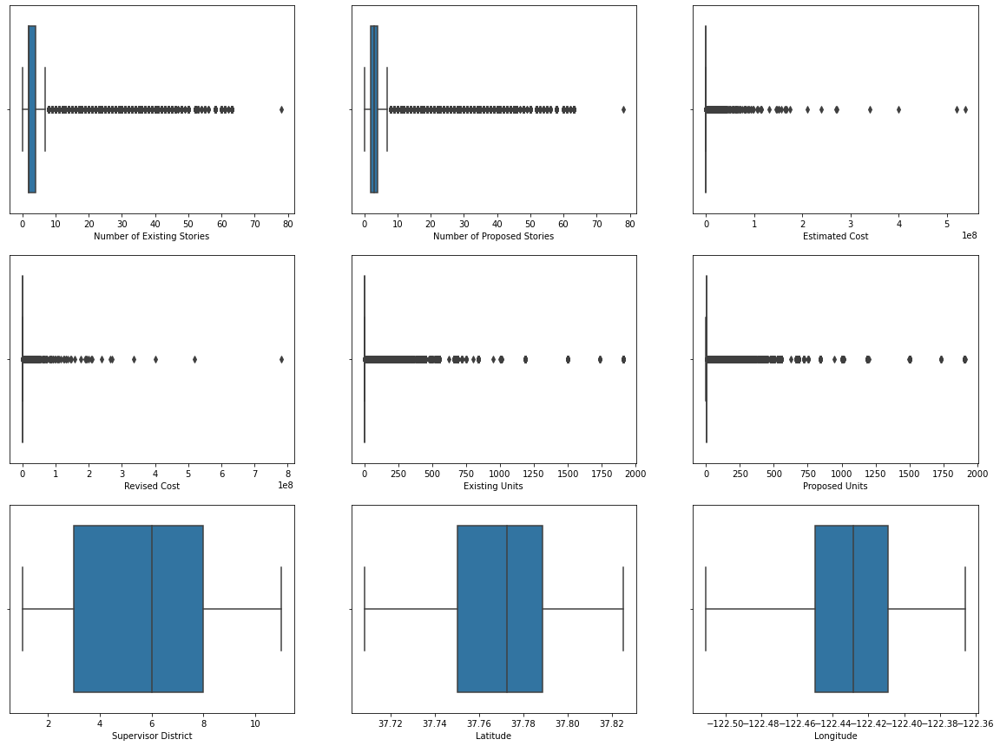

In [33]:
k = 1
plt.figure(figsize=(20,15))
for i in df.select_dtypes(include=np.number):
    plt.subplot(3,3,k)
    sns.boxplot(df[i])
    k = k + 1

plt.show()

In [34]:
for i in df.select_dtypes(include=np.number) :
    q1 = df[i].quantile(0.25)
    q3 = df[i].quantile(0.75)
    IQR = q3 - q1
    UL = q3 + (1.5 * IQR)
    LL = q1 - (1.5 * IQR)
    uc = df[i].quantile(0.99)
    lc = df[i].quantile(0.01)
    for ind1 in df[i].index:
        if df.loc[ind1,i] > UL :
            df.loc[ind1,i] = uc
        if df.loc[ind1,i] < LL :
            df.loc[ind1,i] = lc

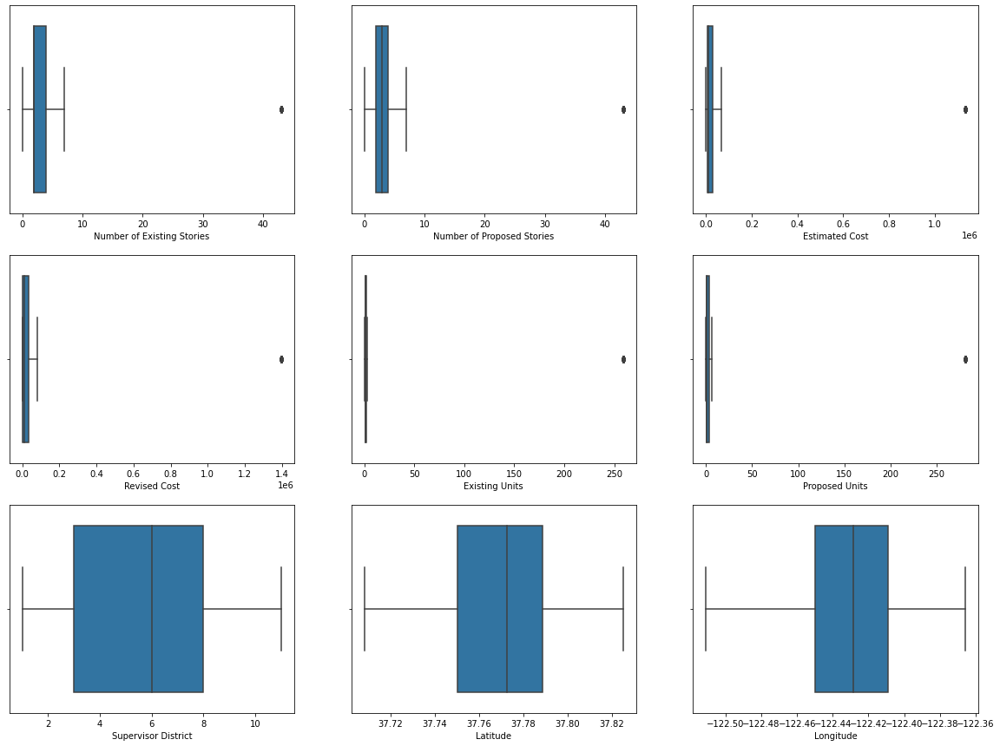

In [35]:
k = 1
plt.figure(figsize=(20,15))
for i in df.select_dtypes(include=np.number):
    plt.subplot(3,3,k)
    sns.boxplot(df[i])
    k = k + 1
    
plt.show()

<b> Inference: </b>
As we can see, the outliers are treated by performing capping method using IQR technique on the dataset

<a id="skew"></a>
## 8. Handling Skewness

In [36]:
## again changing the datatypes
df['Permit Type'] = df['Permit Type'].astype('object')
df['Existing Construction Type'] = df['Existing Construction Type'].astype('object')
df['Proposed Construction Type'] = df['Proposed Construction Type'].astype('object')
df['Plansets'] = df['Plansets'].astype('object')

In [174]:
df_copy3 = df.copy()

In [37]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 161803 entries, 0 to 181491
Data columns (total 19 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   Permit Type                          161803 non-null  object 
 1   Street Suffix                        161803 non-null  object 
 2   Current Status                       161803 non-null  object 
 3   Number of Existing Stories           161803 non-null  float64
 4   Number of Proposed Stories           161803 non-null  float64
 5   Estimated Cost                       161803 non-null  float64
 6   Revised Cost                         161803 non-null  float64
 7   Existing Use                         161803 non-null  object 
 8   Existing Units                       161803 non-null  float64
 9   Proposed Use                         161803 non-null  object 
 10  Proposed Units                       161803 non-null  float64
 11  Plansets     

In [38]:
df.shape

(161803, 19)

In [39]:
df_num = df.select_dtypes(include=np.number)

In [40]:
df_num.skew()

Number of Existing Stories    2.292169
Number of Proposed Stories    2.298883
Estimated Cost                2.143705
Revised Cost                  2.205633
Existing Units                1.451341
Proposed Units                1.957115
Supervisor District           0.107564
Latitude                     -0.490737
Longitude                    -0.631650
dtype: float64

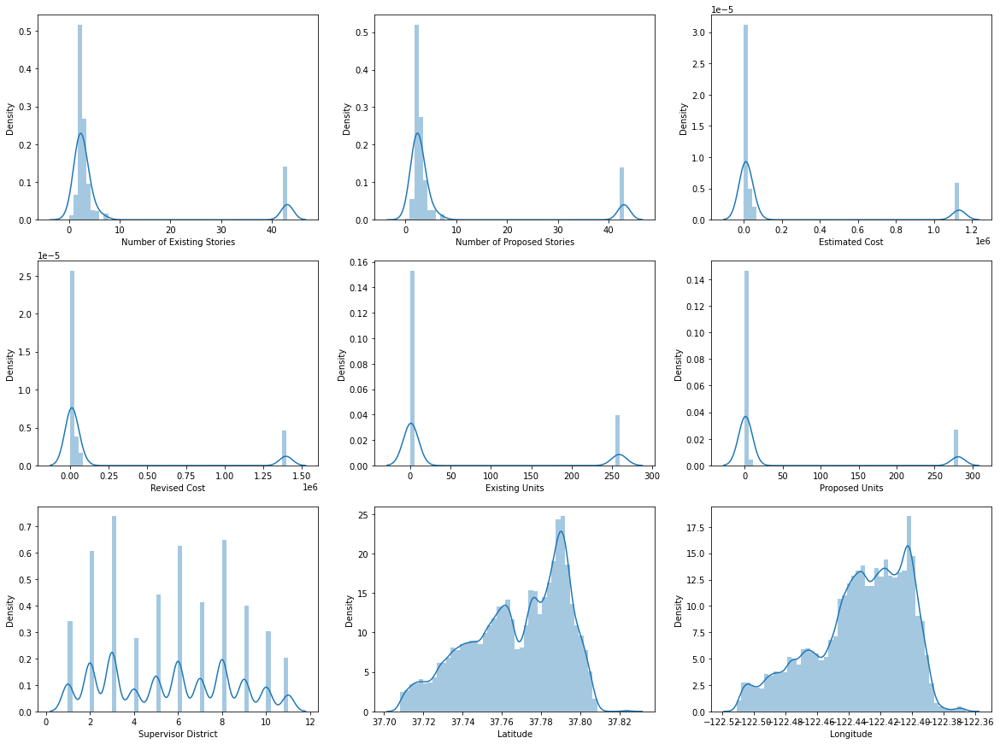

In [41]:
k = 1
plt.figure(figsize=(20,15))
for i in df_num.columns:
    plt.subplot(3,3,k)
    sns.distplot(df[i])
    k = k + 1
    
plt.show()

### Square Root transformation

In [42]:
df_sqrt = np.sqrt(df_num)
df_sqrt.head()

,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Units,Proposed Units,Supervisor District,Latitude,Longitude
0,2.449490,1.414214,63.245553,63.245553,16.092856,1.000000,1.732051,6.147009,NaN
1,2.645751,1.414214,1.000000,22.360680,16.092856,1.000000,1.732051,6.147141,NaN
2,2.449490,2.449490,141.421356,141.421356,16.092856,16.763055,1.732051,6.147736,NaN
3,1.414214,1.414214,44.721360,44.721360,1.000000,1.000000,1.732051,6.147842,NaN
4,2.236068,2.236068,63.245553,63.245553,16.092856,16.763055,3.162278,6.144853,NaN


In [43]:
df_sqrt.skew()

Number of Existing Stories    2.131281
Number of Proposed Stories    2.169271
Estimated Cost                2.030936
Revised Cost                  2.052947
Existing Units                1.428949
Proposed Units                1.914638
Supervisor District          -0.284971
Latitude                     -0.491227
Longitude                          NaN
dtype: float64

### Log Transformation

In [44]:
df_log = np.log(df_num)
df_log.head()

,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Units,Proposed Units,Supervisor District,Latitude,Longitude
0,1.791759,0.693147,8.294050,8.294050,5.556751,0.000000,1.098612,3.631931,NaN
1,1.945910,0.693147,0.000000,6.214608,5.556751,0.000000,1.098612,3.631974,NaN
2,1.791759,1.791759,9.903488,9.903488,5.556751,5.638355,1.098612,3.632168,NaN
3,0.693147,0.693147,7.600902,7.600902,0.000000,0.000000,1.098612,3.632202,NaN
4,1.609438,1.609438,8.294050,8.294050,5.556751,5.638355,2.302585,3.631230,NaN


In [45]:
df_log.skew()

Number of Existing Stories         NaN
Number of Proposed Stories         NaN
Estimated Cost               -1.258843
Revised Cost                       NaN
Existing Units                     NaN
Proposed Units                     NaN
Supervisor District          -0.771520
Latitude                     -0.491717
Longitude                          NaN
dtype: float64

In [46]:
df_log.shape

(161803, 9)

### Power Transformation

In [47]:
pt = PowerTransformer()
df_pt = pd.DataFrame(pt.fit_transform(df_num), columns = df_num.columns)
df_pt.head()

,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Units,Proposed Units,Supervisor District,Latitude,Longitude
0,0.907671,-0.581928,-0.414727,-0.086628,1.721509,-0.241913,-0.846558,0.735283,0.822947
1,1.053253,-0.581928,-2.246285,-0.564517,1.721509,-0.241913,-0.846558,0.806464,0.751011
2,0.907671,0.998882,0.146537,0.338957,1.721509,1.874726,-0.846558,1.131473,0.353925
3,-0.490369,-0.581928,-0.634037,-0.254451,-0.252262,-0.241913,-0.846558,1.189895,0.584119
4,0.718908,0.800657,-0.414727,-0.086628,1.721509,1.874726,1.425849,-0.388752,1.398434


In [48]:
df_pt.skew()

Number of Existing Stories   -0.147903
Number of Proposed Stories   -0.031199
Estimated Cost                0.070319
Revised Cost                 -0.080226
Existing Units                0.609978
Proposed Units                0.490139
Supervisor District          -0.124612
Latitude                     -0.399869
Longitude                    -0.629020
dtype: float64

In [49]:
df_pt.shape

(161803, 9)

In [50]:
df_pt

,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Units,Proposed Units,Supervisor District,Latitude,Longitude
0,0.907671,-0.581928,-0.414727,-0.086628,1.721509,-0.241913,-0.846558,0.735283,0.822947
1,1.053253,-0.581928,-2.246285,-0.564517,1.721509,-0.241913,-0.846558,0.806464,0.751011
2,0.907671,0.998882,0.146537,0.338957,1.721509,1.874726,-0.846558,1.131473,0.353925
3,-0.490369,-0.581928,-0.634037,-0.254451,-0.252262,-0.241913,-0.846558,1.189895,0.584119
4,0.718908,0.800657,-0.414727,-0.086628,1.721509,1.874726,1.425849,-0.388752,1.398434
...,...,...,...,...,...,...,...,...,...
161798,2.009894,2.004752,0.107431,0.454641,1.721509,1.874726,-0.846558,1.024417,0.995593
161799,-1.582628,-1.958873,0.146537,0.338957,-0.252262,-0.241913,-0.846558,1.024417,0.995593
161800,0.094352,0.108447,0.540116,0.523749,1.721509,0.839190,-0.846558,1.024417,0.995593
161801,0.094352,0.108447,-0.529175,-0.174093,0.425848,0.520635,-0.846558,1.024417,0.995593


<b> Inference: </b>
1. As we can see, the skewness is drasctically reduced when Power transformation was applied on the dataset
2. So, based on all above results, performing Power transformation on our final model

### On final model

In [51]:
df_pt.isnull().sum()

Number of Existing Stories    0
Number of Proposed Stories    0
Estimated Cost                0
Revised Cost                  0
Existing Units                0
Proposed Units                0
Supervisor District           0
Latitude                      0
Longitude                     0
dtype: int64

In [52]:
df_num.columns

Index(['Number of Existing Stories', 'Number of Proposed Stories',
       'Estimated Cost', 'Revised Cost', 'Existing Units', 'Proposed Units',
       'Supervisor District', 'Latitude', 'Longitude'],
      dtype='object')

In [53]:
df_pt = df_pt.reset_index()
df = df.reset_index()

In [192]:
df_skew = df.copy()

In [54]:
df['Number of Existing Stories'] = df_pt['Number of Existing Stories']
df['Number of Proposed Stories'] = df_pt['Number of Proposed Stories']
df['Estimated Cost'] = df_pt['Estimated Cost']
df['Revised Cost'] = df_pt['Revised Cost']
df['Existing Units'] = df_pt['Existing Units']
df['Proposed Units'] = df_pt['Proposed Units']
df['Supervisor District'] = df_pt['Supervisor District']
df['Latitude'] = df_pt['Latitude']
df['Longitude'] = df_pt['Longitude']

In [55]:
df.shape

(161803, 20)

In [56]:
df

,index,Permit Type,Street Suffix,Current Status,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Use,Existing Units,Proposed Use,Proposed Units,Plansets,Existing Construction Type,Proposed Construction Type,Site Permit,Supervisor District,Neighborhoods - Analysis Boundaries,Latitude,Longitude
0,0,4,St,expired,0.907671,-0.581928,-0.414727,-0.086628,tourist hotel/motel,1.721509,1 family dwelling,-0.241913,2,3,5,Y,-0.846558,Tenderloin,0.735283,0.822947
1,1,4,St,issued,1.053253,-0.581928,-2.246285,-0.564517,tourist hotel/motel,1.721509,1 family dwelling,-0.241913,2,3,5,Y,-0.846558,Tenderloin,0.806464,0.751011
2,2,3,Av,withdrawn,0.907671,0.998882,0.146537,0.338957,retail sales,1.721509,retail sales,1.874726,2,1,1,N,-0.846558,Russian Hill,1.131473,0.353925
3,3,8,Av,complete,-0.490369,-0.581928,-0.634037,-0.254451,1 family dwelling,-0.252262,1 family dwelling,-0.241913,2,5,5,Y,-0.846558,Nob Hill,1.189895,0.584119
4,4,8,St,issued,0.718908,0.800657,-0.414727,-0.086628,apartments,1.721509,apartments,1.874726,2,1,1,Y,1.425849,Potrero Hill,-0.388752,1.398434
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161798,181486,8,St,complete,2.009894,2.004752,0.107431,0.454641,apartments,1.721509,apartments,1.874726,0,1,1,Y,-0.846558,Financial District/South Beach,1.024417,0.995593
161799,181487,8,Av,complete,-1.582628,-1.958873,0.146537,0.338957,1 family dwelling,-0.252262,1 family dwelling,-0.241913,0,5,5,Y,-0.846558,Financial District/South Beach,1.024417,0.995593
161800,181488,8,St,issued,0.094352,0.108447,0.540116,0.523749,apartments,1.721509,apartments,0.839190,2,5,5,Y,-0.846558,Financial District/South Beach,1.024417,0.995593
161801,181489,8,St,complete,0.094352,0.108447,-0.529175,-0.174093,apartments,0.425848,apartments,0.520635,0,5,5,Y,-0.846558,Financial District/South Beach,1.024417,0.995593


In [57]:
df.drop('index',axis=1,inplace=True)

In [58]:
df.isnull().sum()

Permit Type                            0
Street Suffix                          0
Current Status                         0
Number of Existing Stories             0
Number of Proposed Stories             0
Estimated Cost                         0
Revised Cost                           0
Existing Use                           0
Existing Units                         0
Proposed Use                           0
Proposed Units                         0
Plansets                               0
Existing Construction Type             0
Proposed Construction Type             0
Site Permit                            0
Supervisor District                    0
Neighborhoods - Analysis Boundaries    0
Latitude                               0
Longitude                              0
dtype: int64

In [59]:
df.select_dtypes(include=np.number).skew()

Number of Existing Stories   -0.147903
Number of Proposed Stories   -0.031199
Estimated Cost                0.070319
Revised Cost                 -0.080226
Existing Units                0.609978
Proposed Units                0.490139
Supervisor District          -0.124612
Latitude                     -0.399869
Longitude                    -0.629020
dtype: float64

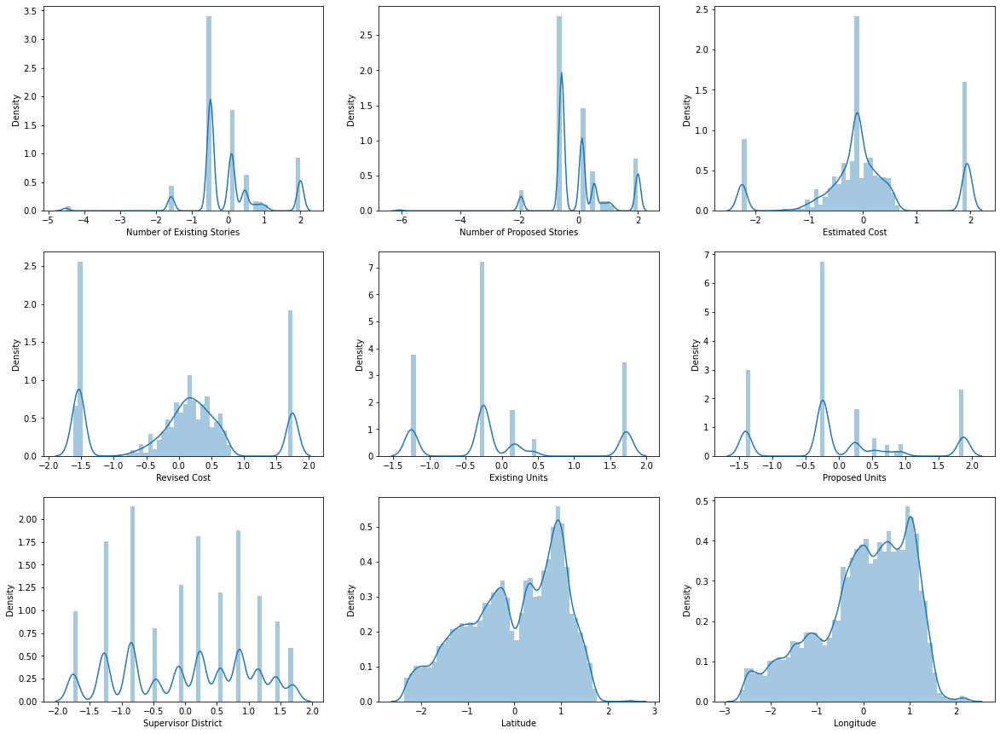

In [60]:
k = 1
plt.figure(figsize=(20,15))
for i in df.select_dtypes(include=np.number):
    plt.subplot(3,3,k)
    sns.distplot(df[i])
    k = k + 1

plt.show()

<b> Inference: </b>
As we can see, the skewness is highly reduced after performing Power Transformation on the dataset

<a id="var"></a>
## 9. Variance Threshold

In [200]:
vthresh = VarianceThreshold(threshold = 0)
vthresh.fit(df.select_dtypes(include=np.number))
vthresh.get_support()

## The get_support returns a Boolean vector where True means that the variable does not have zero variance.

array([ True,  True,  True,  True,  True,  True,  True,  True,  True])

<a id="uni"></a>
## 10. Uni-variate Analysis

### Site Permit - Target Column

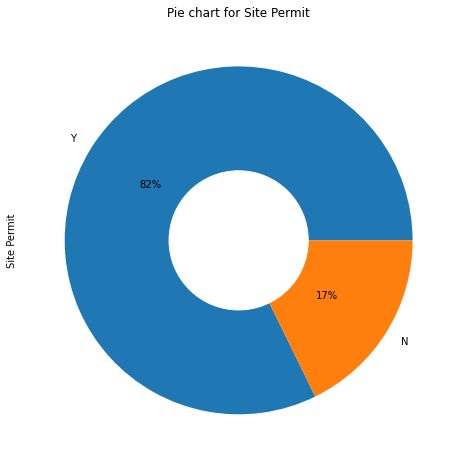

In [201]:
plt.figure(figsize=(10,8))
circle=plt.Circle((0,0) , radius=0.4,color='white')
(df['Site Permit'].value_counts(normalize=True) * 100).plot(kind='pie', autopct = '%.i%%')
donut = plt.gcf()
donut.gca().add_artist(circle)
plt.title("Pie chart for Site Permit")
plt.show()

<b> Inference: </b>
1. As we can see from above graph, the distribution of target column  is quite imbalanced.
2. The Issued permits where Site Permit status is 'Y' is 82% and for the permits which are not yet issued, the distribution is around 17%

### Existing Construction Type

#### Existing Construction Type Description
i. 1 - constr type 1 <br>
ii. 2 - constr type 2 <br>
iii. 3 - constr type 3 <br>
iv. 4 - constr type 4 <br>
v. 5 - wood frame (5)

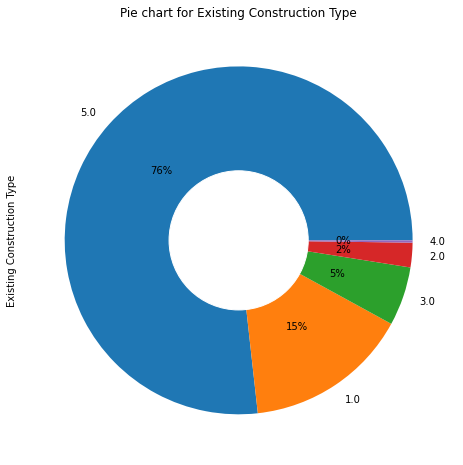

In [202]:
plt.figure(figsize=(10,8))
circle=plt.Circle((0,0) , radius=0.4,color='white')
(df['Existing Construction Type'].value_counts(normalize=True) * 100).plot(kind='pie', autopct = '%.i%%')
donut = plt.gcf()
donut.gca().add_artist(circle)
plt.title("Pie chart for Existing Construction Type")
plt.show()

<b> Inference: </b>
1. As we can see from above graph, majority of the distribution is for the construction type 5, i.e., Wood Frame constructions.
2. Almost 76% records have Existing Construction Type as Woodframe constructions.
3. The distribution of Construction Type 4 is almost equal to 0. 

### Proposed Construction Type

#### Proposed Construction Type Description
i. 1 - constr type 1 <br>
ii. 2 - constr type 2 <br>
iii. 3 - constr type 3 <br>
iv. 4 - constr type 4 <br>
v. 5 - wood frame (5)

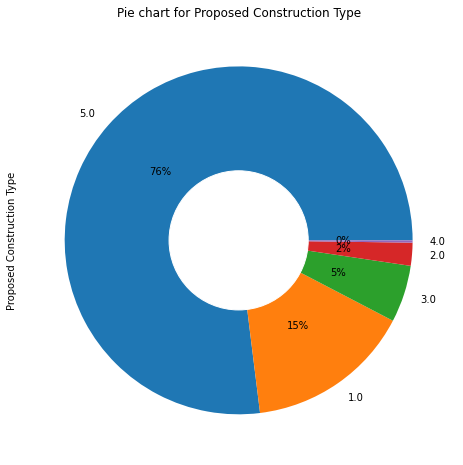

In [203]:
plt.figure(figsize=(10,8))
circle=plt.Circle((0,0) , radius=0.4,color='white')
(df['Proposed Construction Type'].value_counts(normalize=True) * 100).plot(kind='pie', autopct = '%.i%%')
donut = plt.gcf()
donut.gca().add_artist(circle)
plt.title("Pie chart for Proposed Construction Type")
plt.show()

<b> Inference: </b>
1. As we can see from above graph, majority of the distribution is for the construction type 5, i.e., Wood Frame constructions.
2. Almost 76% records have Proposed Construction Type as Woodframe constructions.
3. The distribution of Construction Type 4 is almost equal to 0. 
4. The distribution of Existing Construction Type is almost equal to the distribution of Proposed Construction Type

### Plansets

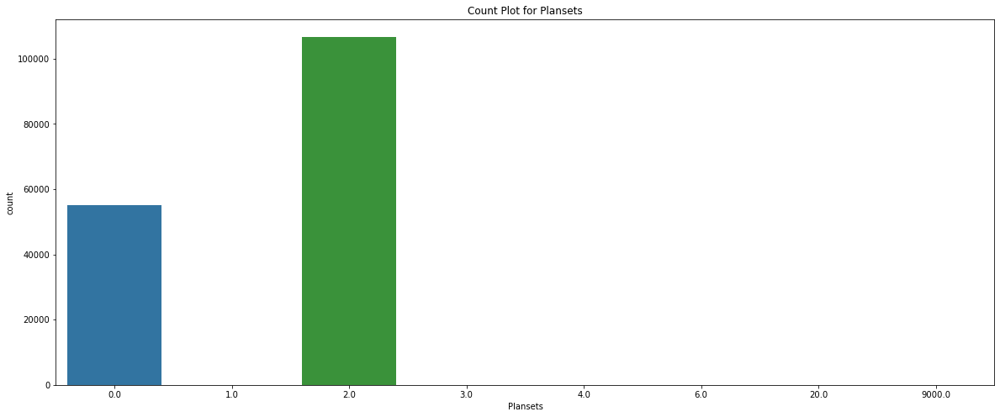

In [204]:
plt.figure(figsize=(20,8))
sns.countplot(df['Plansets'])
plt.title("Count Plot for Plansets")
plt.show()

<b> Inference: </b>
1. Maximum percentage of records in the dataset has Planset values as 2
2. The next majority records in the dataset is for Planset 0
3. For all other Plansets, the percentage of records in the dataset is almost equal to zero

### Current Status

In [205]:
df['Current Status'].nunique()

14

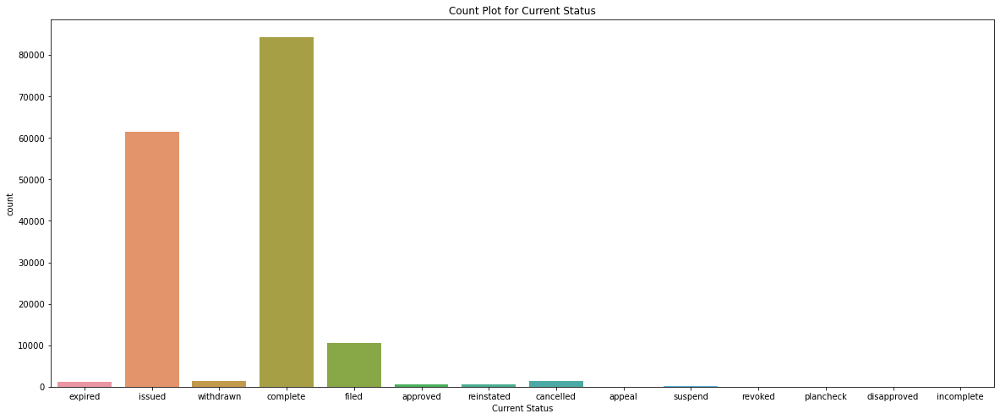

In [206]:
plt.figure(figsize=(20,8))
sns.countplot(df['Current Status'])
plt.title("Count Plot for Current Status")
plt.show()

<b> Inference: </b>
1. The 'Complete' Current Status has the highest number of records. It implies that the process of issuing Building Permits is completed most of the times
2. The same is applicable for the status 'Issued'. It implies that, most of the Building Permits have their current status as issued
3. The other statuses have very low number of records in the dataset. It implies that most of the records are either in Completed or in Issued status.

### Permit Type

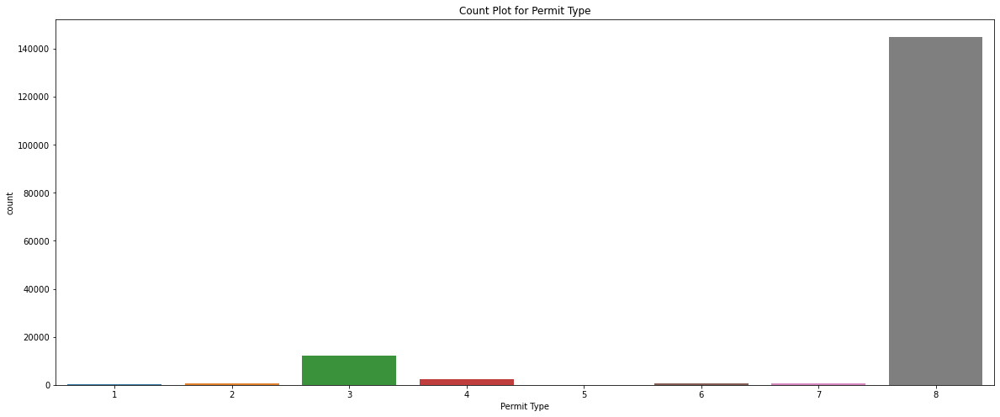

In [207]:
plt.figure(figsize=(20,8))
sns.countplot(df['Permit Type'])
plt.title("Count Plot for Permit Type")
plt.show()

<b> Inference: </b>
1. The Permit type 8 has very high number of records in the dataset. It indicates that most of the Building Permits are applied for the constructions having Permit type as 8
2. The Permit type 3 has next highest number of records, but is very less as compared to Permit type 8. 
3. For records with Permit types other than 8 and 3, the percentage of records is very low.

### Other Categorical Columns

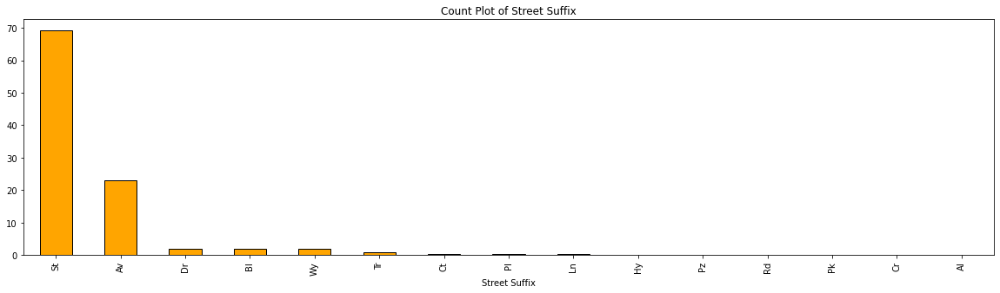

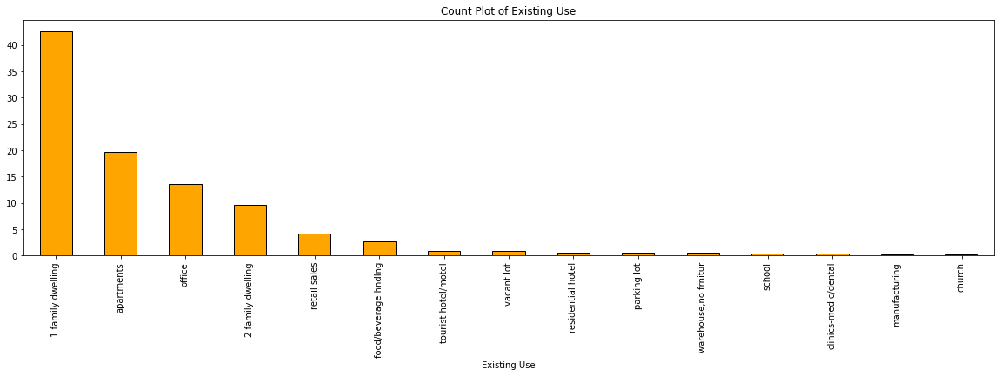

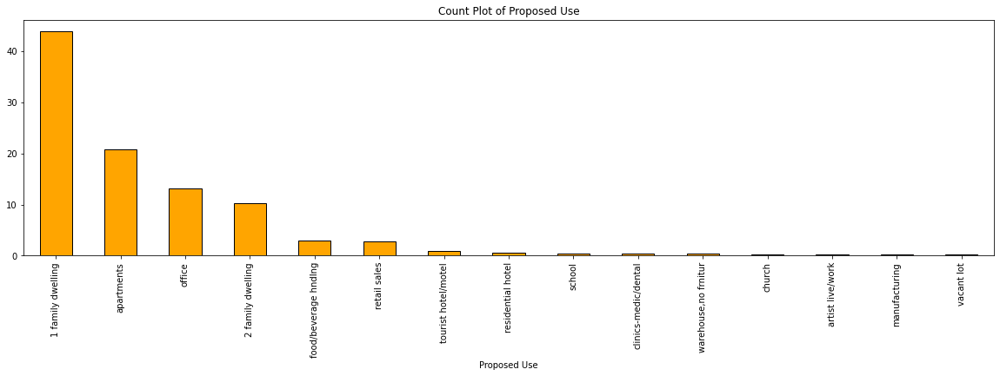

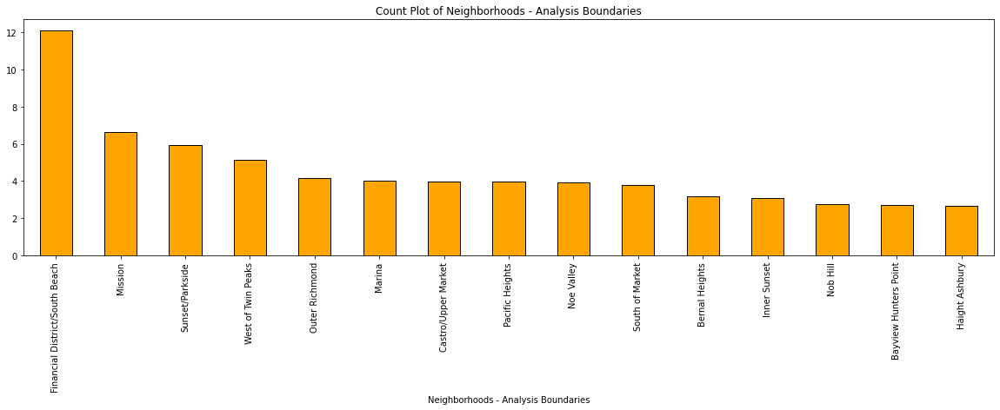

In [208]:
cat_columns = ['Street Suffix','Existing Use','Proposed Use', 'Neighborhoods - Analysis Boundaries']

for i in cat_columns:
    plt.figure(figsize=(20,5))
    (df[i].value_counts(1) * 100).sort_values(ascending=False).head(15).plot(kind='bar',color='orange',edgecolor='black')
    plt.xlabel(i)
    title1 = 'Count Plot of ' + i
    plt.title(title1)
    plt.show()

<b> Inference: </b>
1. Above graphs represents the top 10 categories having highest counts in columns 'Street Suffix','Existing Use','Proposed Use','Neighborhoods - Analysis Boundaries' and 'Location'
2. The St Street Suffix has high number of records in the dataset
3. The distribution of records for different Use is almost same for both Existing and Proposed use. For both the features, the count of record is high for 1 family dwelling use
4. Most of the records have their Neighborhoods as Financial District/South Beach.

### Location

In [153]:
px.scatter(data_frame=df, x='Latitude',y='Longitude',title='Geography Location')

<b> Inference: </b>
The Scatter Plot Shows <br> the Latitude and Longitude of <br> the locations in the dataset.

<a id="biv"></a>
## 11. Bi-variate Analysis

### Current Status and Site Permit

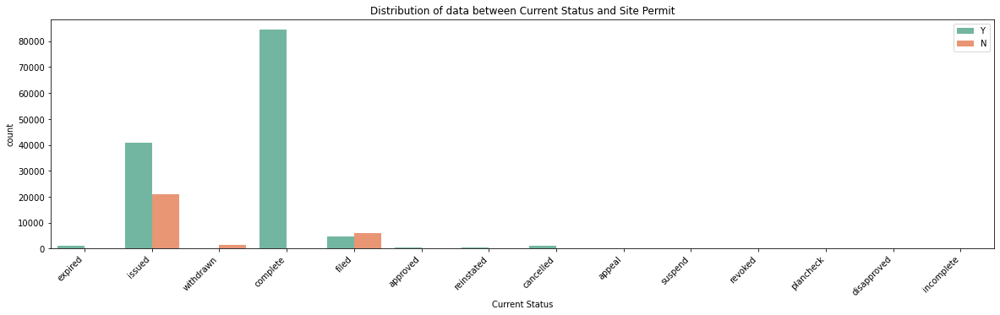

In [210]:
plt.figure(figsize=(20,5))
sns.countplot(x=df['Current Status'],hue=df['Site Permit'],palette='Set2')
plt.xticks(rotation = 45, ha = 'right')
plt.title("Distribution of data between Current Status and Site Permit")
plt.legend(loc='upper right')
plt.show()

<b> Inference: </b>
1. From above graphs, we can interpret that, the records which have Site Permit value 'Y' have mostly the Current Status of the application as Issued, filed or completed.
2. For the rest of the current statuses, mostly the Site Permit status is 'N'

### Permit Type and Site Permit

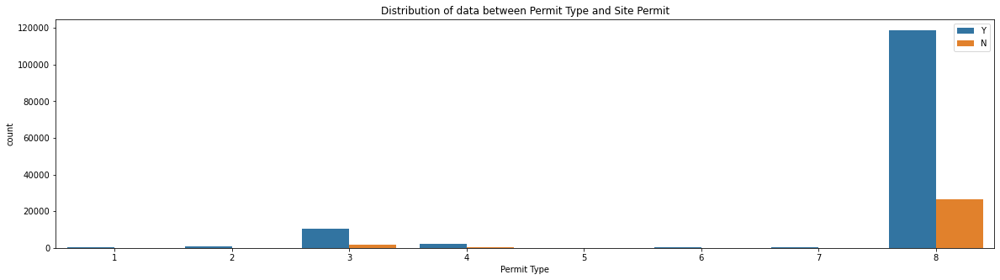

In [211]:
plt.figure(figsize=(20,5))
sns.countplot(x=df['Permit Type'],hue=df['Site Permit'])
plt.legend(loc='upper right')
plt.title("Distribution of data between Permit Type and Site Permit")
plt.show()

<b> Inference: </b>
1. The above graph interprets that, the constructions are permitted mostly for Permit types 3 and 8.
2. There are few records in Permit types 1,2 and 4, where Site Permit status is 'Y'
3. For other Permit types, the applications are not usually permitted or their status is 'N'

<a id="mul"></a>
## 12. Multi-variate Analysis

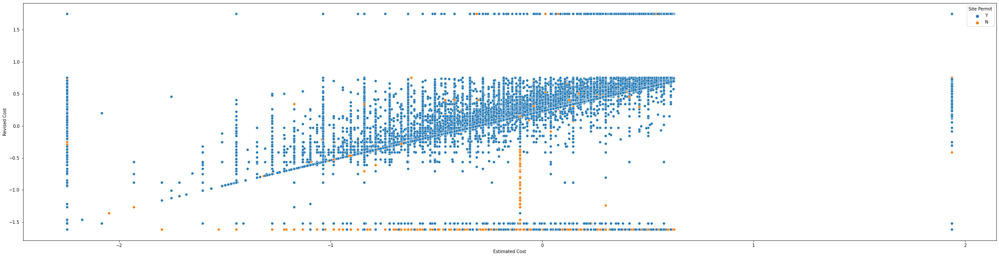

In [212]:
plt.figure(figsize=(40,10))
sns.scatterplot(x=df['Estimated Cost'],y=df['Revised Cost'],hue=df['Site Permit'])
plt.show()

<b> Inference: </b>
1. Since, the class data is imbalanced, we can see that most of the scatter points are the records where the Site Permit value is Y
2. Also, there seems a relation between the Estimated cost and Revised Cost

### Current Status and Permit Type for both Site Permit Status

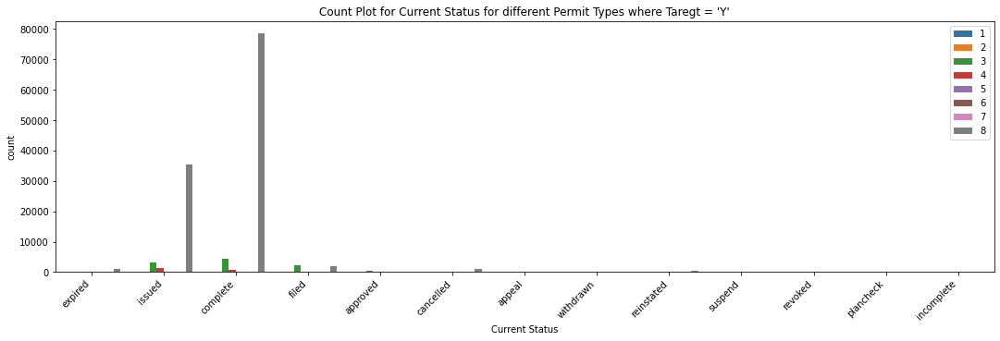

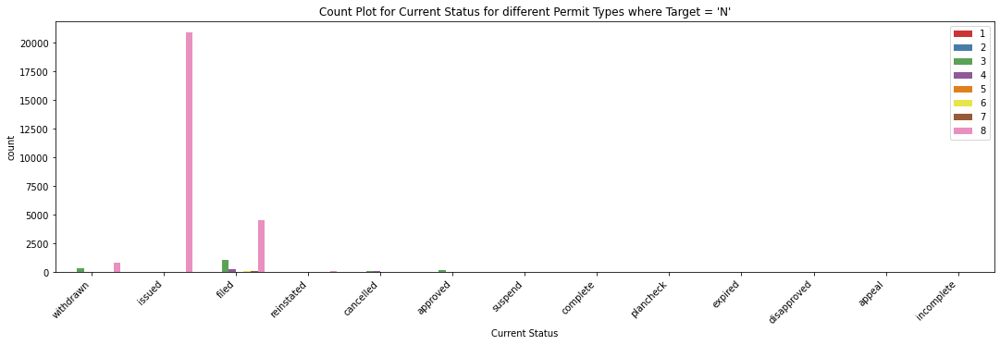

In [215]:
plt.figure(figsize=(40,5))
plt.subplot(1, 2, 1)
plt.title("Count Plot for Current Status for different Permit Types where Target = 'Y'")
sns.countplot(x = df[df['Site Permit'] == 'Y']['Current Status'],hue = df[df['Site Permit'] == 'Y']['Permit Type'])
plt.xticks(rotation = 45, ha = 'right')
plt.legend(loc='upper right')
plt.show()


plt.figure(figsize=(40,5))
plt.subplot(1, 2, 2)
plt.title("Count Plot for Current Status for different Permit Types where Target = 'N'")
sns.countplot(x = df[df['Site Permit'] == 'N']['Current Status'],hue = df[df['Site Permit'] == 'N']['Permit Type'],palette='Set1')
plt.xticks(rotation = 45, ha = 'right')
plt.legend(loc='upper right')
plt.show()

<b> Inference : </b>
1. As we can see in above graphs, where Site Permit is 'Y', the data is highly distributed for current statuses Issued, Filed and Completed. 
2. Almost for all statuses, the data is quite high for Permit type 8
3. Also, there is no data for Site Permit as 'Y' and for Permit Type 0
4. Where Site Permit status is 'N', the data distribution is high for status Filed and Issued. Along with these statuses, the data is more for Permit Type 8.

### Current Status and Existing Construction Type for both Site Permit Status

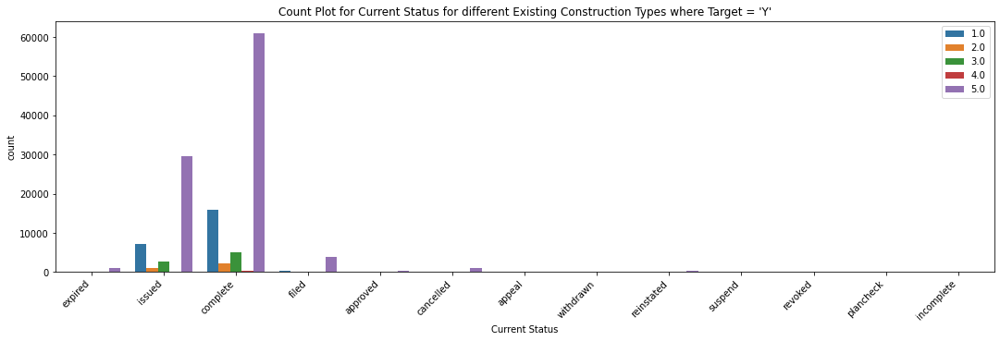

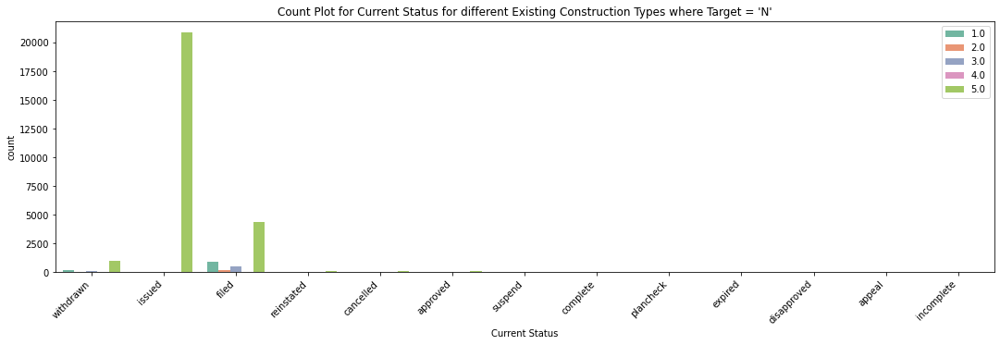

In [216]:
plt.figure(figsize=(40,5))
plt.subplot(1, 2, 1)
plt.title("Count Plot for Current Status for different Existing Construction Types where Target = 'Y'")
sns.countplot(x = df[df['Site Permit'] == 'Y']['Current Status'],hue = df[df['Site Permit'] == 'Y']['Existing Construction Type'])
plt.xticks(rotation = 45, ha = 'right')
plt.legend(loc='upper right')
plt.show()


plt.figure(figsize=(40,5))
plt.subplot(1, 2, 2)
plt.title("Count Plot for Current Status for different Existing Construction Types where Target = 'N'")
sns.countplot(x = df[df['Site Permit'] == 'N']['Current Status'],hue = df[df['Site Permit'] == 'N']['Existing Construction Type'],
             palette='Set2')
plt.xticks(rotation = 45, ha = 'right')
plt.legend(loc='upper right')
plt.show()

<b> Inference : </b>
1. From above graphs, we can infer that, for Site Permit 'Y', the data is more for current statuses Issued, Filed and Completed and for Existing Construction Type 5
2. Almost for all other statuses, the data is comparatively high for Existing Construction Type 1. 
3. The data distribution for Site Permit status as 'N', is high for current statuses Issued and Completed. Almost for all other statuses, the data is comparatively high for Existing Construction Type 5. 

### Current Status and Proposed Construction Type for both Site Permit Status

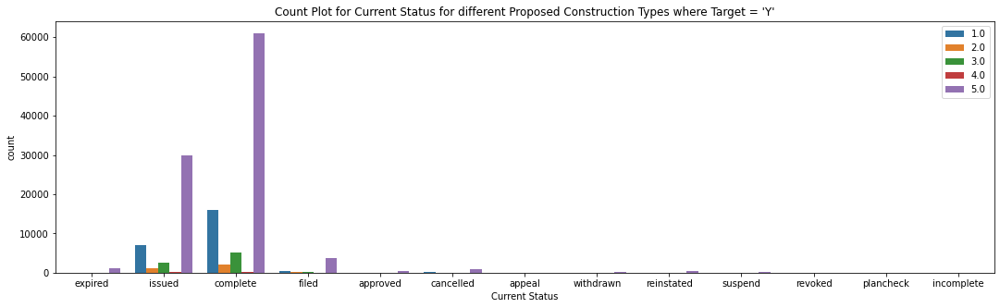

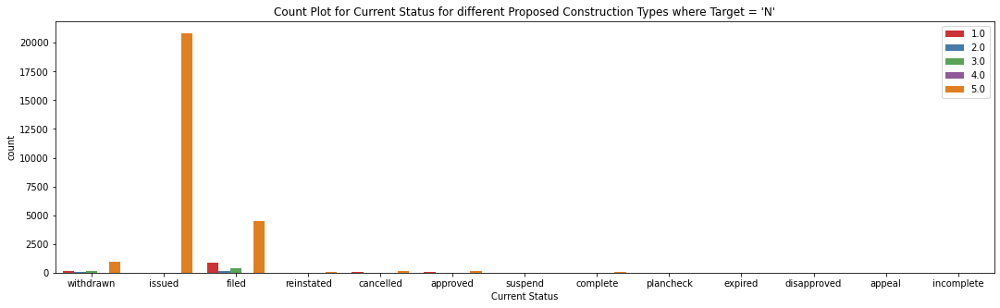

In [217]:
plt.figure(figsize=(40,5))
plt.subplot(1, 2, 1)
plt.title("Count Plot for Current Status for different Proposed Construction Types where Target = 'Y'")
sns.countplot(x = df[df['Site Permit'] == 'Y']['Current Status'],hue = df[df['Site Permit'] == 'Y']['Proposed Construction Type'])
plt.legend(loc='upper right')
plt.show()


plt.figure(figsize=(40,5))
plt.subplot(1, 2, 2)
plt.title("Count Plot for Current Status for different Proposed Construction Types where Target = 'N'")
sns.countplot(x = df[df['Site Permit'] == 'N']['Current Status'],hue = df[df['Site Permit'] == 'N']['Proposed Construction Type'],
             palette='Set1')
plt.legend(loc='upper right')
plt.show()

<b> Inference : </b>
1. From above graphs, we can infer that, for Site Permit status 'Y', the data is more for current statuses Issued, Filed and Completed and for Proposed Construction Type 5
2. Almost for all other statuses, the data is comparatively high for Proposed Construction Type 1. The same is applicable where Site Permit is 'N'.
3. The data distribution for Site Permit status as 'N', is high for current statuses Issued and Filed.
4. The data distrubution of Current statuses for different Proposed Construction type and Existing Construction Type for both the statuses of Site Permit, is quite similar

<a id="stats"></a>
## 13. Statistics

In [218]:
df.head()

,Permit Type,Street Suffix,Current Status,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Use,Existing Units,Proposed Use,Proposed Units,Plansets,Existing Construction Type,Proposed Construction Type,Site Permit,Supervisor District,Neighborhoods - Analysis Boundaries,Latitude,Longitude
0,4,St,expired,0.907671,-0.581928,-0.414727,-0.086628,tourist hotel/motel,1.721509,1 family dwelling,-0.241913,2,3,5,Y,-0.846558,Tenderloin,0.735283,0.822947
1,4,St,issued,1.053253,-0.581928,-2.246285,-0.564517,tourist hotel/motel,1.721509,1 family dwelling,-0.241913,2,3,5,Y,-0.846558,Tenderloin,0.806464,0.751011
2,3,Av,withdrawn,0.907671,0.998882,0.146537,0.338957,retail sales,1.721509,retail sales,1.874726,2,1,1,N,-0.846558,Russian Hill,1.131473,0.353925
3,8,Av,complete,-0.490369,-0.581928,-0.634037,-0.254451,1 family dwelling,-0.252262,1 family dwelling,-0.241913,2,5,5,Y,-0.846558,Nob Hill,1.189895,0.584119
4,8,St,issued,0.718908,0.800657,-0.414727,-0.086628,apartments,1.721509,apartments,1.874726,2,1,1,Y,1.425849,Potrero Hill,-0.388752,1.398434


In [219]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.anova import anova_lm
from scipy import stats
from scipy.stats import chi2_contingency
from scipy.stats import chi2
from scipy.stats import chisquare
import statsmodels.stats.multicomp as mc

### Test of Independence

### 1. Permit Type and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Permit type are Independent <br>
H<sub>1</sub> : Two variables Target and Permit type are dependent

In [220]:
data = pd.crosstab(df['Site Permit'],df['Permit Type'])

In [221]:
observed_values =data.values

In [222]:
observed_values

array([[    13,     21,   1715,    363,      8,    116,    120,  26354],
       [   281,    719,  10462,   2127,     74,    394,    338, 118698]],
      dtype=int64)

In [223]:
alpha = 0.05
degree_of_freedom = 7
# (r-1,c-1)(1*7=7)

t_stat , P_value , dof, expected_value = chi2_contingency(observed=observed_values , correction=False)

In [224]:
print("The p-value of the performed test is ",P_value)

The p-value of the performed test is  2.397030781379014e-67


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Permit Type column and Target column are dependent.

### 2. Current Status and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Current Status are Independent <br>
H<sub>1</sub> : Two variables Target and Current Status are dependent

In [225]:
data2 = pd.crosstab(df['Site Permit'],df['Current Status'])

In [226]:
observed_values2 =data2.values

In [227]:
observed_values2

array([[    1,   199,   227,    64,     2,     1,  6014,     1, 20839,
            7,    70,     0,    14,  1271],
       [    1,   413,  1140, 84327,     0,  1173,  4563,     1, 40687,
            9,   421,    43,   140,   175]], dtype=int64)

In [228]:
alpha = 0.05
degree_of_freedom = 13

t_stat2 , P_value2 , dof2, expected_value2 = chi2_contingency(observed=observed_values2 , correction=False)

In [229]:
print("The p-value of the performed test is ",P_value2)

The p-value of the performed test is  0.0


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Current Status column and Target column are dependent.

### 3. Existing Construction Type and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Existing Construction Type are Independent <br>
H<sub>1</sub> : Two variables Target and Existing Construction Type are dependent

In [230]:
data3 = pd.crosstab(df['Site Permit'],df['Existing Construction Type'])

In [231]:
observed_values3 =data3.values

In [232]:
observed_values3

array([[ 1169,   270,   663,    37, 26571],
       [23549,  3421,  8189,   307, 97627]], dtype=int64)

In [233]:
alpha = 0.05
degree_of_freedom = 4
# (r-1,c-1)(1*7=7)

t_stat3 , P_value3 , dof3, expected_value3 = chi2_contingency(observed=observed_values3 , correction=False)

In [234]:
print("The p-value of the performed test is ",P_value3)

The p-value of the performed test is  0.0


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Existing Construction Type column and Target column are dependent.

### 4. Proposed Construction Type and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Proposed Construction Type are Independent <br>
H<sub>1</sub> : Two variables Target and Proposed Construction Type are dependent

In [235]:
data4 = pd.crosstab(df['Site Permit'],df['Proposed Construction Type'])

In [236]:
observed_values4 =data4.values

In [237]:
observed_values4

array([[ 1128,   230,   578,    26, 26748],
       [23775,  3221,  7999,   315, 97783]], dtype=int64)

In [238]:
alpha = 0.05
degree_of_freedom = 4
# (r-1,c-1)(1*7=7)

t_stat4 , P_value4 , dof4, expected_value4 = chi2_contingency(observed=observed_values4 , correction=False)

In [239]:
print("The p-value of the performed test is ",P_value4)

The p-value of the performed test is  0.0


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Proposed Construction Type column and Target column are dependent.

### 5. Existing Use and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Existing Use are Independent <br>
H<sub>1</sub> : Two variables Target and Existing Use are dependent

In [240]:
data5 = pd.crosstab(df['Site Permit'],df['Existing Use'])

In [241]:
observed_values5 =data5.values

In [242]:
observed_values5

array([[23572,   604,     1,     1,     0,     0,     4,    28,  1394,
           21,    29,     7,    24,     0,     1,     2,     2,     0,
            1,    39,    48,     7,     2,     0,     3,     3,     0,
            3,     1,     2,     8,     0,    20,   403,     7,     1,
           21,     2,     0,    16,    35,     0,    44,    13,     0,
            4,     2,     2,     1,     0,     5,     4,     1,     3,
            0,     0,  1030,     0,     0,    32,     6,     4,     6,
           22,    25,     0,    17,     0,     1,     9,    50,   734,
            0,    38,     0,     6,     0,     1,     3,     0,    14,
            1,     1,     0,    16,   140,     0,    79,    10,    55,
            1,    17,     1],
       [45417, 15012,     4,     8,     2,     7,    54,    76, 30467,
          377,   285,    81,   183,     2,     9,     7,     7,     1,
           11,   398,   494,   103,    14,     1,    20,    20,     4,
           45,     7,    39,    52,     8,   16

In [243]:
alpha = 0.05
degree_of_freedom = 92
# (r-1,c-1)(1*7=7)

t_stat5 , P_value5 , dof5, expected_value5 = chi2_contingency(observed=observed_values5 , correction=False)

In [244]:
print("The p-value of the performed test is ",P_value5)

The p-value of the performed test is  0.0


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Existing Use column and Target column are dependent.

### 6. Proposed Use and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Proposed Use are Independent <br>
H<sub>1</sub> : Two variables Target and Proposed Use are dependent

In [245]:
data6 = pd.crosstab(df['Site Permit'],df['Proposed Use'])

In [246]:
observed_values6 =data6.values

In [247]:
observed_values6

array([[23953,   672,     0,     1,     0,     0,     7,    30,  1533,
           21,    15,     4,    24,     2,     1,     1,     2,     3,
            1,    36,    48,     5,     2,     0,     3,     3,     2,
            6,     1,     3,     3,     2,     7,   369,     5,     4,
           29,     2,     0,     6,    25,     0,    29,    20,     0,
            8,     2,     0,     1,     1,     5,     2,     0,     3,
            3,     0,     0,   961,     0,     0,     9,     6,     4,
            2,    10,    22,     0,    21,     0,     3,    13,    47,
          412,     0,    46,     0,     6,     1,     2,     2,     0,
            9,     2,     1,     0,    10,   125,     0,    26,     8,
           35,     1,    19,     2],
       [47139, 15845,     5,     4,     3,     8,    50,    79, 32051,
          370,   209,    66,   228,     3,     5,     4,     7,    22,
           10,   368,   589,   106,    13,     1,    18,    33,     9,
           72,    10,    56,    31,    1

In [248]:
alpha = 0.05
degree_of_freedom = 94
# (r-1,c-1)(1*7=7)

t_stat6 , P_value6 , dof6, expected_value6 = chi2_contingency(observed=observed_values6 , correction=False)

In [249]:
print("The p-value of the performed test is ",P_value6)

The p-value of the performed test is  0.0


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Proposed Use column and Target column are dependent.

### 7. Street Suffix and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Street Suffix are Independent <br>
H<sub>1</sub> : Two variables Target and Street Suffix are dependent

In [250]:
data7 = pd.crosstab(df['Site Permit'],df['Street Suffix'])

In [251]:
observed_values7 =data7.values

In [252]:
observed_values7

array([[   10,  6402,   519,    11,    40,   344,     0,    34,    37,
            0,    18,    84,    18,    26,     1,     0, 20628,     1,
          186,     1,   350],
       [   57, 31039,  2534,    77,   566,  2741,     1,   177,   263,
            2,    82,   351,   144,    96,     4,     2, 91294,     1,
          995,     6,  2661]], dtype=int64)

In [253]:
alpha = 0.05
degree_of_freedom = 20
# (r-1,c-1)(1*7=7)

t_stat7 , P_value7 , dof7, expected_value7 = chi2_contingency(observed=observed_values7 , correction=False)

In [254]:
print("The p-value of the performed test is ",P_value7)

The p-value of the performed test is  1.0652201712706656e-49


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Street Suffix column and Target column are dependent.

### 8. Plansets and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Plansets are Independent <br>
H<sub>1</sub> : Two variables Target and Plansets are dependent

In [255]:
data8 = pd.crosstab(df['Site Permit'],df['Plansets'])

In [256]:
observed_values8 =data8.values

In [257]:
observed_values8

array([[  646,     0, 28061,     2,     0,     0,     1,     0],
       [54351,     2, 78691,    44,     3,     1,     0,     1]],
      dtype=int64)

In [258]:
alpha = 0.05
degree_of_freedom = 7
# (r-1,c-1)(1*7=7)

t_stat8 , P_value8 , dof8, expected_value8 = chi2_contingency(observed=observed_values8 , correction=False)

In [259]:
print("The p-value of the performed test is ",P_value8)

The p-value of the performed test is  0.0


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Plansets column and Target column are dependent.

### 9. Neighborhoods - Analysis Boundaries and Target

The null and alternate hypothesis are: <br>
H<sub>0</sub> : Two variables Target and Neighborhoods - Analysis Boundaries are Independent <br>
H<sub>1</sub> : Two variables Target and Neighborhoods - Analysis Boundaries are dependent

In [260]:
data9 = pd.crosstab(df['Site Permit'],df['Neighborhoods - Analysis Boundaries'])

In [261]:
observed_values9 =data9.values

In [262]:
observed_values9

array([[  582,  1004,  1370,   546,   410,  1612,   401,     7,  1052,
          902,   888,   935,    97,    65,     6,   535,  1534,     7,
         2364,   236,   980,  1374,   640,   319,   329,  1424,  1575,
          180,   644,    13,   780,   961,   156,  1006,  1224,   631,
           17,   189,   126,  1110,   479],
       [ 3799,  4100,  5081,  2568,  2516, 17941,  1852,    54,  3293,
         3122,  2764,  4018,   425,   932,    36,  2047,  4967,    36,
         8393,  1655,  3453,  4992,  2263,  2222,  1773,  5329,  4827,
         1126,  2851,    28,  2403,  3049,   721,  5138,  8383,  3231,
           61,  1358,   729,  7223,  2334]], dtype=int64)

In [263]:
alpha = 0.05
degree_of_freedom = 40
# (r-1,c-1)(1*7=7)

t_stat9 , P_value9 , dof9, expected_value9 = chi2_contingency(observed=observed_values9 , correction=False)

In [264]:
print("The p-value of the performed test is ",P_value9)

The p-value of the performed test is  0.0


Since, the p-value is less than 0.05, we reject the null hypothesis. Thus, we have enough evidence to state that the Neighborhoods - Analysis Boundaries column and Target column are dependent.

<a id="corr"></a>
## 14. Checking Correlation

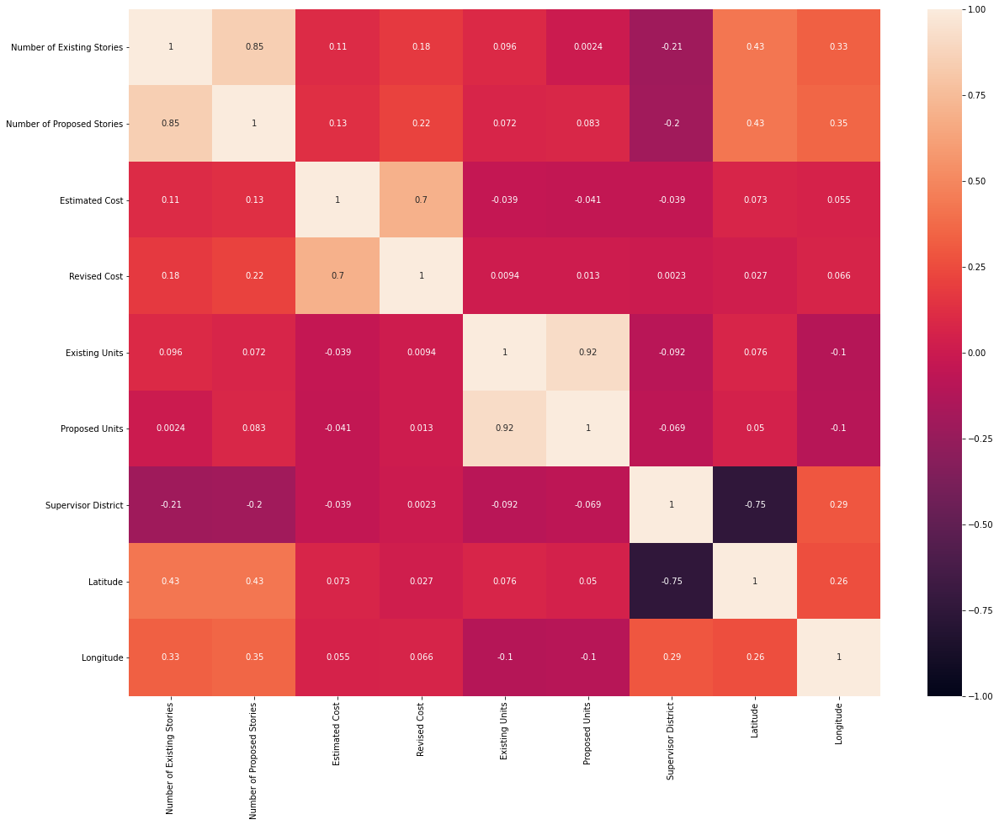

In [265]:
plt.figure(figsize=(20,15))
sns.heatmap(df.corr(),annot=True,vmin = -1, vmax=1)
plt.show()

<b> Inference: </b>
1. From above correlarion graph, we can interpret that, there is high positive correlation between columns Existing Units - Proposed Units and Number of Existing Stories - Number of Proposed Stories
2. There is also slight high positive correlation between Estimated Cost and Revised Cost
3. There also seems a negative correlation between Supervisor District and Latitude

<a id="pair"></a>
## 15. Pairplot

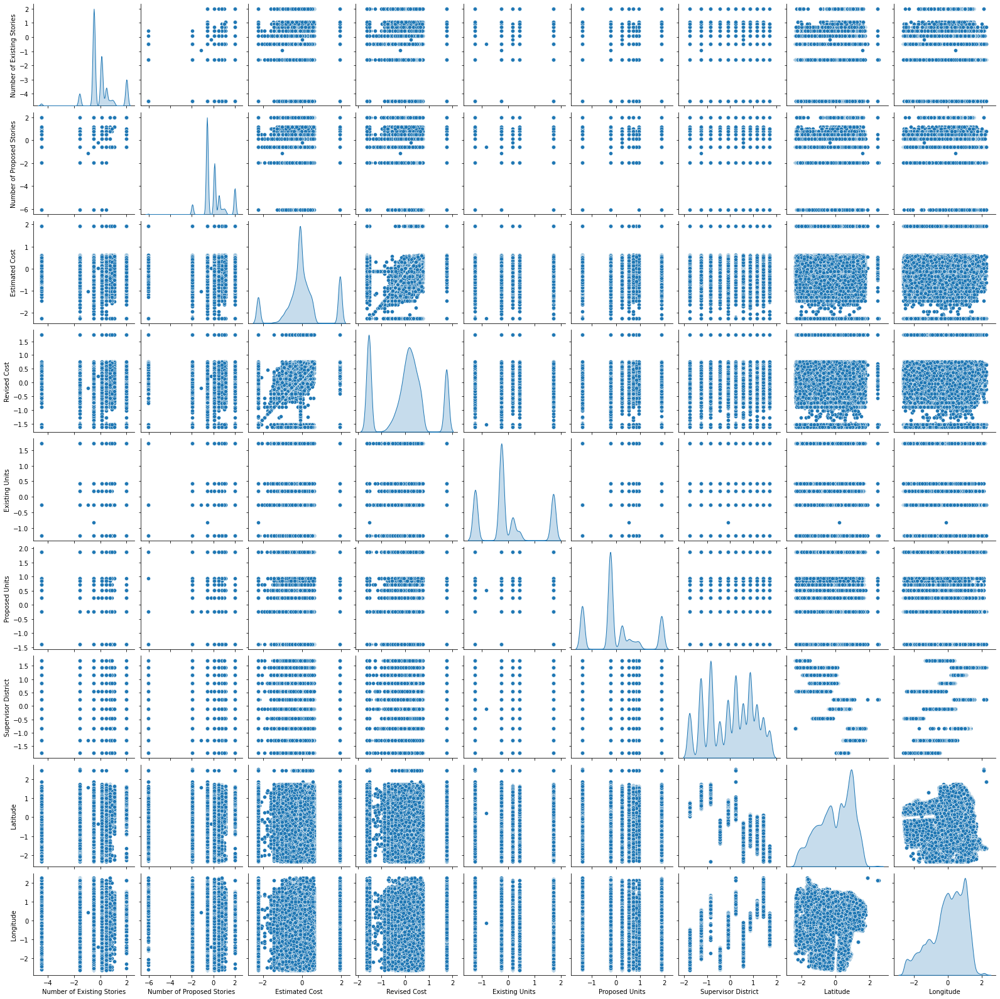

In [267]:
sns.pairplot(df.select_dtypes(include=np.number),diag_kind='kde')
plt.show()

<a id="lab"></a>
## 16. Label Encoding

In [269]:
df_encode = df.copy()

In [271]:
var1 = df['Existing Use'].value_counts(1)
var2 = df['Proposed Use'].value_counts(1)
var3 = df['Street Suffix'].value_counts(1)
var4 = df['Neighborhoods - Analysis Boundaries'].value_counts(1)
var5 = df['Current Status'].value_counts(1)
var6 = df['Plansets'].value_counts(1)

In [272]:
df['Existing Use'] = df['Existing Use'].apply(lambda x : var1[x])
df['Proposed Use'] = df['Proposed Use'].apply(lambda x : var2[x])
df['Street Suffix'] = df['Street Suffix'].apply(lambda x : var3[x])
df['Neighborhoods - Analysis Boundaries'] = df['Neighborhoods - Analysis Boundaries'].apply(lambda x : var4[x])
df['Current Status'] = df['Current Status'].apply(lambda x : var5[x])
df['Plansets'] = df['Plansets'].apply(lambda x : var6[x])

In [273]:
df = pd.get_dummies(data=df,columns = ['Permit Type','Site Permit'],drop_first=True)

In [274]:
df

,Street Suffix,Current Status,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Use,Existing Units,Proposed Use,Proposed Units,Plansets,Existing Construction Type,Proposed Construction Type,Supervisor District,Neighborhoods - Analysis Boundaries,Latitude,Longitude,Permit Type_2,Permit Type_3,Permit Type_4,Permit Type_5,Permit Type_6,Permit Type_7,Permit Type_8,Site Permit_Y
0,0.691718,0.007256,0.907671,-0.581928,-0.414727,-0.086628,0.009425,1.721509,0.439374,-0.241913,0.659765,3,5,-0.846558,0.023869,0.735283,0.822947,0,0,1,0,0,0,0,1
1,0.691718,0.380253,1.053253,-0.581928,-2.246285,-0.564517,0.009425,1.721509,0.439374,-0.241913,0.659765,3,5,-0.846558,0.023869,0.806464,0.751011,0,0,1,0,0,0,0,1
2,0.231399,0.008937,0.907671,0.998882,0.146537,0.338957,0.041408,1.721509,0.028566,1.874726,0.659765,1,1,-0.846558,0.024783,1.131473,0.353925,0,1,0,0,0,0,0,0
3,0.231399,0.521566,-0.490369,-0.581928,-0.634037,-0.254451,0.426377,-0.252262,0.439374,-0.241913,0.659765,5,5,-0.846558,0.027398,1.189895,0.584119,0,0,0,0,0,0,1,1
4,0.691718,0.380253,0.718908,0.800657,-0.414727,-0.086628,0.196912,1.721509,0.207561,1.874726,0.659765,1,1,1.425849,0.021600,-0.388752,1.398434,0,0,0,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161798,0.691718,0.521566,2.009894,2.004752,0.107431,0.454641,0.196912,1.721509,0.207561,1.874726,0.339901,1,1,-0.846558,0.120844,1.024417,0.995593,0,0,0,0,0,0,1,1
161799,0.231399,0.521566,-1.582628,-1.958873,0.146537,0.338957,0.426377,-0.252262,0.439374,-0.241913,0.339901,5,5,-0.846558,0.120844,1.024417,0.995593,0,0,0,0,0,0,1,1
161800,0.691718,0.380253,0.094352,0.108447,0.540116,0.523749,0.196912,1.721509,0.207561,0.839190,0.659765,5,5,-0.846558,0.120844,1.024417,0.995593,0,0,0,0,0,0,1,1
161801,0.691718,0.521566,0.094352,0.108447,-0.529175,-0.174093,0.196912,0.425848,0.207561,0.520635,0.339901,5,5,-0.846558,0.120844,1.024417,0.995593,0,0,0,0,0,0,1,1


In [275]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161803 entries, 0 to 161802
Data columns (total 25 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   Street Suffix                        161803 non-null  float64
 1   Current Status                       161803 non-null  float64
 2   Number of Existing Stories           161803 non-null  float64
 3   Number of Proposed Stories           161803 non-null  float64
 4   Estimated Cost                       161803 non-null  float64
 5   Revised Cost                         161803 non-null  float64
 6   Existing Use                         161803 non-null  float64
 7   Existing Units                       161803 non-null  float64
 8   Proposed Use                         161803 non-null  float64
 9   Proposed Units                       161803 non-null  float64
 10  Plansets                             161803 non-null  float64
 11  Existing Cons

In [276]:
df.isnull().sum()

Street Suffix                          0
Current Status                         0
Number of Existing Stories             0
Number of Proposed Stories             0
Estimated Cost                         0
Revised Cost                           0
Existing Use                           0
Existing Units                         0
Proposed Use                           0
Proposed Units                         0
Plansets                               0
Existing Construction Type             0
Proposed Construction Type             0
Supervisor District                    0
Neighborhoods - Analysis Boundaries    0
Latitude                               0
Longitude                              0
Permit Type_2                          0
Permit Type_3                          0
Permit Type_4                          0
Permit Type_5                          0
Permit Type_6                          0
Permit Type_7                          0
Permit Type_8                          0
Site Permit_Y   

<a id="scale"></a>
## 17. Scaling

In [277]:
df_scale = df.copy()

In [278]:
df['Existing Construction Type'] = df['Existing Construction Type'].astype('int64')
df['Proposed Construction Type'] = df['Proposed Construction Type'].astype('int64')

In [280]:
X = df.drop('Site Permit_Y',axis=1)
y = df['Site Permit_Y']

In [281]:
sc = StandardScaler()
X_sc = pd.DataFrame(sc.fit_transform(X) , columns = X.columns)
X_sc.head(2)

,Street Suffix,Current Status,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Use,Existing Units,Proposed Use,Proposed Units,Plansets,Existing Construction Type,Proposed Construction Type,Supervisor District,Neighborhoods - Analysis Boundaries,Latitude,Longitude,Permit Type_2,Permit Type_3,Permit Type_4,Permit Type_5,Permit Type_6,Permit Type_7,Permit Type_8
0,0.652122,-2.941333,0.907671,-0.581928,-0.414727,-0.086628,-1.508121,1.721509,1.065798,-0.241913,0.717517,-0.80691,0.525387,-0.846558,-0.646098,0.735283,0.822649,-0.067783,-0.285277,7.99882,-0.022518,-0.056231,-0.053279,-2.94267
1,0.652122,-0.290477,1.053253,-0.581928,-2.246285,-0.564517,-1.508121,1.721509,1.065798,-0.241913,0.717517,-0.80691,0.525387,-0.846558,-0.646098,0.806464,0.750713,-0.067783,-0.285277,7.99882,-0.022518,-0.056231,-0.053279,-2.94267


<a id="clus"></a>
## 18. Clustering

In [282]:
X_sc.isnull().sum()

Street Suffix                          0
Current Status                         0
Number of Existing Stories             0
Number of Proposed Stories             0
Estimated Cost                         0
Revised Cost                           0
Existing Use                           0
Existing Units                         0
Proposed Use                           0
Proposed Units                         0
Plansets                               0
Existing Construction Type             0
Proposed Construction Type             0
Supervisor District                    0
Neighborhoods - Analysis Boundaries    0
Latitude                               0
Longitude                              0
Permit Type_2                          0
Permit Type_3                          0
Permit Type_4                          0
Permit Type_5                          0
Permit Type_6                          0
Permit Type_7                          0
Permit Type_8                          0
dtype: int64

In [283]:
num = range(1,15)
cluster_inertia = []
for i in num:
    cluster = KMeans(n_clusters = i, init = 'k-means++', n_init=10)
    cluster.fit(X_sc)
    cluster_inertia.append(cluster.inertia_)
    
cluster_info = pd.DataFrame({'Numberofclusters': num, 'cluster_inertia': cluster_inertia})
cluster_info

,Numberofclusters,cluster_inertia
0,1,3.883272e+06
1,2,3.234223e+06
2,3,2.905737e+06
3,4,2.614121e+06
4,5,2.430359e+06
5,6,2.265381e+06
6,7,2.106335e+06
7,8,1.982035e+06
8,9,1.891820e+06
9,10,1.710283e+06


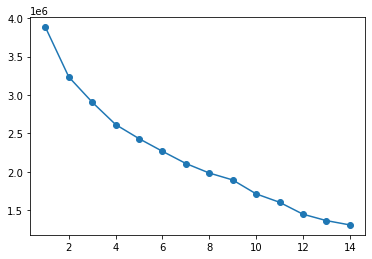

In [284]:
plt.plot(cluster_info.Numberofclusters, cluster_info.cluster_inertia, marker = 'o')

In [285]:
c=[2,3,4,5]
score = []
for i in c:
    cluster = KMeans(n_clusters = i)
    l = cluster.fit_predict(X_sc)
    score.append(silhouette_score(X_sc, l, random_state = 10))
    print('The silhouette score for', i, 'is:', silhouette_score(X_sc, l, random_state = 10))

The silhouette score for 2 is: 0.26631176086478814
The silhouette score for 3 is: 0.28790367470497624
The silhouette score for 4 is: 0.20013915924786427
The silhouette score for 5 is: 0.21463055580892512


In [286]:
cluster = KMeans(n_clusters = 3)
l_k = cluster.fit_predict(X_sc)
df_k = X_sc.copy()
df_k['Labels'] = l_k
df_k.head()

,Street Suffix,Current Status,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Use,Existing Units,Proposed Use,Proposed Units,Plansets,Existing Construction Type,Proposed Construction Type,Supervisor District,Neighborhoods - Analysis Boundaries,Latitude,Longitude,Permit Type_2,Permit Type_3,Permit Type_4,Permit Type_5,Permit Type_6,Permit Type_7,Permit Type_8,Labels
0,0.652122,-2.941333,0.907671,-0.581928,-0.414727,-0.086628,-1.508121,1.721509,1.065798,-0.241913,0.717517,-0.806910,0.525387,-0.846558,-0.646098,0.735283,0.822649,-0.067783,-0.285277,7.998820,-0.022518,-0.056231,-0.053279,-2.942670,1
1,0.652122,-0.290477,1.053253,-0.581928,-2.246285,-0.564517,-1.508121,1.721509,1.065798,-0.241913,0.717517,-0.806910,0.525387,-0.846558,-0.646098,0.806464,0.750713,-0.067783,-0.285277,7.998820,-0.022518,-0.056231,-0.053279,-2.942670,1
2,-1.241174,-2.929386,0.907671,0.998882,0.146537,0.338957,-1.308386,1.721509,-1.454530,1.874726,0.717517,-2.141794,-2.142405,-0.846558,-0.617577,1.131473,0.353627,-0.067783,3.505366,-0.125018,-0.022518,-0.056231,-0.053279,-2.942670,1
3,-1.241174,0.713828,-0.490369,-0.581928,-0.634037,-0.254451,1.095717,-0.252262,1.065798,-0.241913,0.717517,0.527975,0.525387,-0.846558,-0.536060,1.189895,0.583821,-0.067783,-0.285277,-0.125018,-0.022518,-0.056231,-0.053279,0.339827,0
4,0.652122,-0.290477,0.718908,0.800657,-0.414727,-0.086628,-0.337274,1.721509,-0.356385,1.874726,0.717517,-2.141794,-2.142405,1.425849,-0.716823,-0.388752,1.398136,-0.067783,-0.285277,-0.125018,-0.022518,-0.056231,-0.053279,0.339827,1


In [287]:
df_k['Labels'].unique()

array([1, 0, 2])

In [288]:
df.to_csv('df.csv') 

<a id="und"></a>
## 19. Undersampling

In [89]:
df1 = pd.read_csv('df.csv')
df1 = df1.drop('Unnamed: 0',axis=1)
X = df1.drop('Site Permit_Y',axis=1)
y = df1['Site Permit_Y']
sc = StandardScaler()
X_sc = pd.DataFrame(sc.fit_transform(X) , columns = X.columns)
X_sc.head(2)

,Street Suffix,Current Status,Number of Existing Stories,Number of Proposed Stories,Estimated Cost,Revised Cost,Existing Use,Existing Units,Proposed Use,Proposed Units,Plansets,Existing Construction Type,Proposed Construction Type,Supervisor District,Neighborhoods - Analysis Boundaries,Latitude,Longitude,Permit Type_2,Permit Type_3,Permit Type_4,Permit Type_5,Permit Type_6,Permit Type_7,Permit Type_8
0,0.652122,-2.941333,0.907671,-0.581928,-0.414727,-0.086628,-1.508121,1.721509,1.065798,-0.241913,0.717517,-0.80691,0.525387,-0.846558,-0.646098,0.735283,0.822649,-0.067783,-0.285277,7.99882,-0.022518,-0.056231,-0.053279,-2.94267
1,0.652122,-0.290477,1.053253,-0.581928,-2.246285,-0.564517,-1.508121,1.721509,1.065798,-0.241913,0.717517,-0.80691,0.525387,-0.846558,-0.646098,0.806464,0.750713,-0.067783,-0.285277,7.99882,-0.022518,-0.056231,-0.053279,-2.94267


### 1. Tomek Links

1. A criticism of the Condensed Nearest Neighbor Rule is that examples are selected randomly, especially initially.
2. Two modifications to the CNN procedure were proposed by Ivan Tomek in his 1976 paper titled “Two modifications of CNN.” One of the modifications (Method2) is a rule that finds pairs of examples, one from each class; they together have the smallest Euclidean distance to each other in feature space.
3. This means that in a binary classification problem with classes 0 and 1, a pair would have an example from each class and would be closest neighbors across the dataset.
4. These cross-class pairs are now generally referred to as “Tomek Links” and are valuable as they define the class boundary.

In [94]:
# summarize class distribution
counter = Counter(y)
print(counter)
# define the undersampling method
undersample = TomekLinks()
# transform the dataset
X3, y3 = undersample.fit_resample(X_sc, y)
# summarize the new class distribution
counter = Counter(y3)
print(counter)

Counter({1: 133093, 0: 28710})
Counter({1: 131840, 0: 28710})


### 2. One sided selection for Undersampling

1. One-Sided Selection, or OSS for short, is an undersampling technique that combines Tomek Links and the Condensed Nearest Neighbor (CNN) Rule.
2. Specifically, Tomek Links are ambiguous points on the class boundary and are identified and removed in the majority class. The CNN method is then used to remove redundant examples from the majority class that are far from the decision boundary.

In [90]:
# define the undersampling method
undersample = OneSidedSelection(n_neighbors=1, n_seeds_S=200,random_state=1)

In [91]:
# summarize class distribution
counter = Counter(y)
print(counter)
# define the undersampling method
undersample = OneSidedSelection(n_neighbors=1, n_seeds_S=200,random_state=1)
# transform the dataset
X1, y1 = undersample.fit_resample(X_sc, y)
# summarize the new class distribution
counter = Counter(y1)
print(counter)

Counter({1: 133093, 0: 28710})
Counter({1: 56103, 0: 28710})


### 3. Neighborhood Cleaning Rule for Undersampling

1. The Neighborhood Cleaning Rule, or NCR for short, is an undersampling technique that combines both the Condensed Nearest Neighbor (CNN) Rule to remove redundant examples and the Edited Nearest Neighbors (ENN) Rule to remove noisy or ambiguous examples.
2. Like One-Sided Selection (OSS), the CSS method is applied in a one-step manner, then the examples that are misclassified according to a KNN classifier are removed, as per the ENN rule. Unlike OSS, less of the redundant examples are removed and more attention is placed on “cleaning” those examples that are retained.
3. The reason for this is to focus less on improving the balance of the class distribution and more on the quality (unambiguity) of the examples that are retained in the majority class.

In [93]:
# summarize class distribution
counter = Counter(y)
print(counter)
# define the undersampling method
undersample = NeighbourhoodCleaningRule(n_neighbors=3, threshold_cleaning=0.5)
# transform the dataset
X2, y2 = undersample.fit_resample(X_sc, y)
# summarize the new class distribution
counter = Counter(y2)
print(counter)

Counter({1: 133093, 0: 28710})
Counter({1: 129823, 0: 28710})


### 4. Near Miss Undersampling

1. Near Miss refers to a collection of undersampling methods that select examples based on the distance of majority class examples to minority class examples.
2. There are three versions of the technique, named NearMiss-1, NearMiss-2, and NearMiss-3.
3. NearMiss-1 selects examples from the majority class that have the smallest average distance to the three closest examples from the minority class. NearMiss-2 selects examples from the majority class that have the smallest average distance to the three furthest examples from the minority class. NearMiss-3 involves selecting a given number of majority class examples for each example in the minority class that are closest.
4. The NearMiss-3 seems desirable, given that it will only keep those majority class examples that are on the decision boundary.

In [100]:
## NearMiss-1
# summarize class distribution
counter = Counter(y)
print(counter)

# define the undersampling method
undersample = NearMiss(version=1, n_neighbors=3)

# transform the dataset
X4, y4 = undersample.fit_resample(X_sc, y)
# summarize the new class distribution
counter = Counter(y4)
print(counter)

Counter({1: 133093, 0: 28710})
Counter({0: 28710, 1: 28710})


In [105]:
## NearMiss-3
# summarize class distribution
counter = Counter(y)
print(counter)

# define the undersampling method
undersample = NearMiss(version=3, n_neighbors=3)

# transform the dataset
X7, y7 = undersample.fit_resample(X_sc, y)
# summarize the new class distribution
counter = Counter(y7)
print(counter)

Counter({1: 133093, 0: 28710})
Counter({0: 28710, 1: 6275})


### 5. Edited Nearest Neighbors Rule for Undersampling

1. Another rule for finding ambiguous and noisy examples in a dataset is called Edited Nearest Neighbors, or sometimes ENN for short.
2. This rule involves using k=3 nearest neighbors to locate those examples in a dataset that are misclassified and that are then removed before a k=1 classification rule is applied. 
3. When used as an undersampling procedure, the rule can be applied to each example in the majority class, allowing those examples that are misclassified as belonging to the minority class to be removed, and those correctly classified to remain.

In [103]:
# define the undersampling method
undersample = EditedNearestNeighbours(n_neighbors=3)

# summarize class distribution
counter = Counter(y)
print(counter)
# define the undersampling method
undersample = EditedNearestNeighbours(n_neighbors=3)
# transform the dataset
X6, y6 = undersample.fit_resample(X_sc, y)
# summarize the new class distribution
counter = Counter(y6)
print(counter)

Counter({1: 133093, 0: 28710})
Counter({1: 128261, 0: 28710})


As we can see from above outputs from various Undersampling techniques, the lowest sample was given by NearMiss-3 undersampling. Hence, we will be using the sample from NearMiss-3 for further processing

<a id="split"></a>
## 20. Performing Train Test split

In [109]:
X7.shape , y7.shape

((34985, 24), (34985,))

In [110]:
Xtrain , Xtest , ytrain , ytest = train_test_split(X7,y7,test_size=0.3,random_state=10)

<a id="base"></a>
## 21 . Building Base Models

In [111]:
df_base_acc = pd.DataFrame(columns = ['Model_Name','Training_Accuracy','Testing_Accuracy','Precision_Class_0',
                                      'Precision_Class_1','Recall_Class_0','Recall_Class_1','F1_Score_Class_0',
                                     'F1_Score_Class_1'])

<a id="lr"></a>
### 1. Logistic Regression

In [112]:
def logistic_base(Xtrain,Xtest,ytrain,ytest):
    global dict_lr
   ## adding constant
    inpc = sm.add_constant(Xtrain)

    ## Building base model using training set
    log_model = sm.Logit(ytrain,inpc).fit()

    ## checking summary
    print(log_model.summary() )

    #### Calculating accuracy score for training set
    y_pred_prob_train_lr = log_model.predict(inpc)
    y_pred_train_lr = [ 0 if x < 0.5 else 1 for x in y_pred_prob_train_lr]
    acc_score_train = accuracy_score(ytrain , y_pred_train_lr)
    print("The accuracy score for training set is ",acc_score_train)

    #### Calculating accuracy score for testing set
    inpc_test = sm.add_constant(Xtest)
    y_pred_prob_test_lr = log_model.predict(inpc_test)
    y_pred_test_lr = [ 0 if x < 0.5 else 1 for x in y_pred_prob_test_lr]
    acc_score_test = accuracy_score(ytest , y_pred_test_lr)
    print("The accuracy score for testing set is ",acc_score_test)

    #### Confusion matrix
    cm_lr = confusion_matrix(ytest, y_pred_test_lr)

    #### Precision for class 1
    prec_c1_lr  = cm_lr[1,1] / (cm_lr[1,1]+cm_lr[0,1])
    #### Precision for class 0
    prec_c0_lr = cm_lr[0,0] / (cm_lr[0,0] + cm_lr[1,0])

    #### Recall for class 0
    specificity_lr = cm_lr[0,0] /(cm_lr[0,0] + cm_lr[0,1])
    ## Recall for class 1
    sensitivity_lr = cm_lr[1,1] / (cm_lr[1,0] + cm_lr[1,1])

    ## F1-score for class 1
    f1_1_lr = 2*(prec_c1_lr * sensitivity_lr) / (prec_c1_lr + sensitivity_lr)
    ## F1-score for class 0
    f1_0_lr = 2*(prec_c0_lr * specificity_lr) / (prec_c0_lr + specificity_lr)
    
    dict_lr = {'Model_Name':'Logistic Regression','Training_Accuracy':acc_score_train,
                                 'Testing_Accuracy':acc_score_test,'Precision_Class_0':prec_c0_lr,
                                 'Precision_Class_1':prec_c1_lr,'Recall_Class_0':specificity_lr,
                                 'Recall_Class_1':sensitivity_lr,'F1_Score_Class_0':f1_0_lr,
                                 'F1_Score_Class_1':f1_1_lr}
    
    return dict_lr

In [113]:
logistic_base(Xtrain,Xtest,ytrain,ytest)
df_base_acc = df_base_acc.append(dict_lr,ignore_index=True)

Optimization terminated successfully.
         Current function value: 0.307271
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:          Site Permit_Y   No. Observations:                24489
Model:                          Logit   Df Residuals:                    24464
Method:                           MLE   Df Model:                           24
Date:                Wed, 08 Sep 2021   Pseudo R-squ.:                  0.3476
Time:                        22:12:40   Log-Likelihood:                -7524.8
converged:                       True   LL-Null:                       -11533.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                  -0.8052      0.059 

<a id="dt"></a>
### 2. Decision Tree

In [114]:
def decision_tree_base(Xtrain,Xtest,ytrain,ytest):
    global dict_dt
    dt = DecisionTreeClassifier(random_state=1)
    dt_model = dt.fit(Xtrain,ytrain)

    #### Calculating accuracy score for training set
    y_pred_train_dt = dt_model.predict(Xtrain)
    acc_score_train_dt = accuracy_score(ytrain , y_pred_train_dt)
    print("The accuracy score for training set is ",acc_score_train_dt)

    #### Calculating accuracy score for testing set
    y_pred_test_dt = dt_model.predict(Xtest)
    acc_score_test_dt = accuracy_score(ytest , y_pred_test_dt)
    print("The accuracy score for testing set is ",acc_score_test_dt)

    #### Confusion matrix
    cm_dt = confusion_matrix(ytest, y_pred_test_dt)

    #### Precision for class 0
    prec_c0_dt = cm_dt[0,0] / (cm_dt[0,0] + cm_dt[1,0])
    #### Precision for class 1
    prec_c1_dt  = cm_dt[1,1] / (cm_dt[1,1]+cm_dt[0,1])

    #### Recall for class 0
    specificity_dt = cm_dt[0,0] /(cm_dt[0,0] + cm_dt[0,1])
    ## Recall for class 1
    sensitivity_dt = cm_dt[1,1] / (cm_dt[1,0] + cm_dt[1,1])

    ## F1-score for class 0
    f1_0_dt = 2*(prec_c0_dt * specificity_dt) / (prec_c0_dt + specificity_dt)
    ## F1-score for class 1
    f1_1_dt = 2*(prec_c1_dt * sensitivity_dt) / (prec_c1_dt + sensitivity_dt)
    
    dict_dt = {'Model_Name':'Decision Tree','Training_Accuracy':acc_score_train_dt,
                                 'Testing_Accuracy':acc_score_test_dt,'Precision_Class_0':prec_c0_dt,
                                 'Precision_Class_1':prec_c1_dt,'Recall_Class_0':specificity_dt,
                                 'Recall_Class_1':sensitivity_dt,'F1_Score_Class_0':f1_0_dt,
                                 'F1_Score_Class_1':f1_1_dt}
    
    return dict_dt

In [115]:
decision_tree_base(Xtrain,Xtest,ytrain,ytest)
df_base_acc = df_base_acc.append(dict_dt,ignore_index=True)

The accuracy score for training set is  0.999183306790804
The accuracy score for testing set is  0.8947217987804879


<a id="rf"></a>
### 3. Random Forest

In [116]:
def random_forest_base(Xtrain,Xtest,ytrain,ytest):
    global dict_rf
    ### building a base model
    rf = RandomForestClassifier(random_state=1)
    rf_model = rf.fit(Xtrain,ytrain)
    
    #### Calculating accuracy score for training set
    y_pred_train_rf = rf_model.predict(Xtrain)
    acc_score_train_rf = accuracy_score(ytrain , y_pred_train_rf)
    print("The accuracy score for training set is ",acc_score_train_rf)

    #### Calculating accuracy score for testing set
    y_pred_test_rf = rf_model.predict(Xtest)
    acc_score_test_rf = accuracy_score(ytest , y_pred_test_rf)
    print("The accuracy score for testing set is ",acc_score_test_rf)
    
    #### Confusion matrix
    cm_rf = confusion_matrix(ytest, y_pred_test_rf)

    #### Precision for class 0
    prec_c0_rf = cm_rf[0,0] / (cm_rf[0,0] + cm_rf[1,0])
    #### Precision for class 1
    prec_c1_rf  = cm_rf[1,1] / (cm_rf[1,1]+cm_rf[0,1])

    #### Recall for class 0
    specificity_rf = cm_rf[0,0] /(cm_rf[0,0] + cm_rf[0,1])
    ## Recall for class 1
    sensitivity_rf = cm_rf[1,1] / (cm_rf[1,0] + cm_rf[1,1])

    ## F1-score for class 0
    f1_0_rf = 2*(prec_c0_rf * specificity_rf) / (prec_c0_rf + specificity_rf)
    ## F1-score for class 1
    f1_1_rf = 2*(prec_c1_rf * sensitivity_rf) / (prec_c1_rf + sensitivity_rf)
    
    dict_rf = {'Model_Name':'Random Forest','Training_Accuracy':acc_score_train_rf,
                                 'Testing_Accuracy':acc_score_test_rf,'Precision_Class_0':prec_c0_rf,
                                 'Precision_Class_1':prec_c1_rf,'Recall_Class_0':specificity_rf,
                                 'Recall_Class_1':sensitivity_rf,'F1_Score_Class_0':f1_0_rf,
                                 'F1_Score_Class_1':f1_1_rf}
    
    return dict_rf

In [117]:
random_forest_base(Xtrain,Xtest,ytrain,ytest)
df_base_acc = df_base_acc.append(dict_rf,ignore_index=True)

The accuracy score for training set is  0.999183306790804
The accuracy score for testing set is  0.9143483231707317


<a id="knn"></a>
### 4. K Nearest Neighbors

In [118]:
def knn_base(Xtrain,Xtest,ytrain,ytest):
    global dict_knn
    knn = KNeighborsClassifier()
    knn_model = knn.fit(Xtrain,ytrain)

    #### Calculating accuracy score for training set
    y_pred_train_knn = knn_model.predict(Xtrain)
    acc_score_train_knn = accuracy_score(ytrain , y_pred_train_knn)
    print("The accuracy score for training set is ",acc_score_train_knn)

    #### Calculating accuracy score for testing set
    y_pred_test_knn = knn_model.predict(Xtest)
    acc_score_test_knn = accuracy_score(ytest , y_pred_test_knn)
    print("The accuracy score for testing set is ",acc_score_test_knn)

    #### Confusion matrix
    cm_knn = confusion_matrix(ytest, y_pred_test_knn)

    #### Precision for class 0
    prec_c0_knn = cm_knn[0,0] / (cm_knn[0,0] + cm_knn[1,0])
    #### Precision for class 1
    prec_c1_knn  = cm_knn[1,1] / (cm_knn[1,1]+cm_knn[0,1])

    #### Recall for class 0
    specificity_knn = cm_knn[0,0] /(cm_knn[0,0] + cm_knn[0,1])
    ## Recall for class 1
    sensitivity_knn = cm_knn[1,1] / (cm_knn[1,0] + cm_knn[1,1])

    ## F1-score for class 0
    f1_0_knn = 2*(prec_c0_knn * specificity_knn) / (prec_c0_knn + specificity_knn)
    ## F1-score for class 1
    f1_1_knn = 2*(prec_c1_knn * sensitivity_knn) / (prec_c1_knn + sensitivity_knn)
    
    dict_knn = {'Model_Name':'KNN Model','Training_Accuracy':acc_score_train_knn,
                                 'Testing_Accuracy':acc_score_test_knn,'Precision_Class_0':prec_c0_knn,
                                 'Precision_Class_1':prec_c1_knn,'Recall_Class_0':specificity_knn,
                                 'Recall_Class_1':sensitivity_knn,'F1_Score_Class_0':f1_0_knn,
                                 'F1_Score_Class_1':f1_1_knn}
    
    return dict_knn

In [119]:
knn_base(Xtrain,Xtest,ytrain,ytest)
df_base_acc = df_base_acc.append(dict_knn,ignore_index=True)

The accuracy score for training set is  0.9112254481603985
The accuracy score for testing set is  0.862233231707317


<a id="gnb"></a>
### 5. Naive Bayes Algorithm

In [120]:
def naive_bayes_base(Xtrain,Xtest,ytrain,ytest):
    global dict_nb
    gnb = GaussianNB()
    gnb_model = gnb.fit(Xtrain,ytrain)

    #### Calculating accuracy score for training set
    y_pred_train_gnb = gnb_model.predict(Xtrain)
    acc_score_train_gnb = accuracy_score(ytrain , y_pred_train_gnb)
    print("The accuracy score for training set is ",acc_score_train_gnb)

    #### Calculating accuracy score for testing set
    y_pred_test_gnb = gnb_model.predict(Xtest)
    acc_score_test_gnb = accuracy_score(ytest , y_pred_test_gnb)
    print("The accuracy score for testing set is ",acc_score_test_gnb)

    #### Confusion matrix
    cm_gnb = confusion_matrix(ytest, y_pred_test_gnb)

    #### Precision for class 0
    prec_c0_gnb = cm_gnb[0,0] / (cm_gnb[0,0] + cm_gnb[1,0])
    #### Precision for class 1
    prec_c1_gnb  = cm_gnb[1,1] / (cm_gnb[1,1]+cm_gnb[0,1])

    #### Recall for class 0
    specificity_gnb = cm_gnb[0,0] /(cm_gnb[0,0] + cm_gnb[0,1])
    ## Recall for class 1
    sensitivity_gnb = cm_gnb[1,1] / (cm_gnb[1,0] + cm_gnb[1,1])

    ## F1-score for class 0
    f1_0_gnb = 2*(prec_c0_gnb * specificity_gnb) / (prec_c0_gnb + specificity_gnb)
    ## F1-score for class 1
    f1_1_gnb = 2*(prec_c1_gnb * sensitivity_gnb) / (prec_c1_gnb + sensitivity_gnb)
    
    dict_nb = {'Model_Name':'Naive Bayes','Training_Accuracy':acc_score_train_gnb,
                                 'Testing_Accuracy':acc_score_test_gnb,'Precision_Class_0':prec_c0_gnb,
                                 'Precision_Class_1':prec_c1_gnb,'Recall_Class_0':specificity_gnb,
                                 'Recall_Class_1':sensitivity_gnb,'F1_Score_Class_0':f1_0_gnb,
                                 'F1_Score_Class_1':f1_1_gnb}
    
    return dict_nb

In [121]:
naive_bayes_base(Xtrain,Xtest,ytrain,ytest)
df_base_acc = df_base_acc.append(dict_nb,ignore_index=True)

The accuracy score for training set is  0.8122830658663073
The accuracy score for testing set is  0.8094512195121951


<a id="ada"></a>
### 6. AdaBoost

In [122]:
def ada_base(Xtrain,Xtest,ytrain,ytest):
    global dict_ada
    ada = AdaBoostClassifier(random_state = 10)
    ada_model = ada.fit(Xtrain,ytrain)

    #### Calculating accuracy score for training set
    y_pred_train_ada = ada_model.predict(Xtrain)
    acc_score_train_ada = accuracy_score(ytrain , y_pred_train_ada)
    print("The accuracy score for training set is ",acc_score_train_ada)

    #### Calculating accuracy score for testing set
    y_pred_test_ada = ada_model.predict(Xtest)
    acc_score_test_ada = accuracy_score(ytest , y_pred_test_ada)
    print("The accuracy score for testing set is ",acc_score_test_ada)

    #### Confusion matrix
    cm_ada = confusion_matrix(ytest, y_pred_test_ada)

    #### Precision for class 0
    prec_c0_ada = cm_ada[0,0] / (cm_ada[0,0] + cm_ada[1,0])
    #### Precision for class 1
    prec_c1_ada  = cm_ada[1,1] / (cm_ada[1,1]+cm_ada[0,1])

    #### Recall for class 0
    specificity_ada = cm_ada[0,0] /(cm_ada[0,0] + cm_ada[0,1])
    ## Recall for class 1
    sensitivity_ada = cm_ada[1,1] / (cm_ada[1,0] + cm_ada[1,1])

    ## F1-score for class 0
    f1_0_ada = 2*(prec_c0_ada * specificity_ada) / (prec_c0_ada + specificity_ada)
    ## F1-score for class 1
    f1_1_ada = 2*(prec_c1_ada * sensitivity_ada) / (prec_c1_ada + sensitivity_ada)
    
    dict_ada = {'Model_Name':'AdaBoost','Training_Accuracy':acc_score_train_ada,
                                 'Testing_Accuracy':acc_score_test_ada,'Precision_Class_0':prec_c0_ada,
                                 'Precision_Class_1':prec_c1_ada,'Recall_Class_0':specificity_ada,
                                 'Recall_Class_1':sensitivity_ada,'F1_Score_Class_0':f1_0_ada,
                                 'F1_Score_Class_1':f1_1_ada}
    
    return dict_ada

In [123]:
ada_base(Xtrain,Xtest,ytrain,ytest)
df_base_acc = df_base_acc.append(dict_ada,ignore_index=True)

The accuracy score for training set is  0.8848054228429091
The accuracy score for testing set is  0.8819550304878049


<a id="gbs"></a>
### 7. Gradient Boosting

In [124]:
def grad_base(Xtrain,Xtest,ytrain,ytest):
    global dict_grad
    gbs = GradientBoostingClassifier(random_state = 10)
    gbs_model = gbs.fit(Xtrain,ytrain)

    #### Calculating accuracy score for training set
    y_pred_train_gbs = gbs_model.predict(Xtrain)
    acc_score_train_gbs = accuracy_score(ytrain , y_pred_train_gbs)
    print("The accuracy score for training set is ",acc_score_train_gbs)

    #### Calculating accuracy score for testing set
    y_pred_test_gbs = gbs_model.predict(Xtest)
    acc_score_test_gbs = accuracy_score(ytest , y_pred_test_gbs)
    print("The accuracy score for testing set is ",acc_score_test_gbs)

    #### Confusion matrix
    cm_gbs = confusion_matrix(ytest, y_pred_test_gbs)

    #### Precision for class 0
    prec_c0_gbs = cm_gbs[0,0] / (cm_gbs[0,0] + cm_gbs[1,0])
    #### Precision for class 1
    prec_c1_gbs  = cm_gbs[1,1] / (cm_gbs[1,1]+cm_gbs[0,1])

    #### Recall for class 0
    specificity_gbs = cm_gbs[0,0] /(cm_gbs[0,0] + cm_gbs[0,1])
    ## Recall for class 1
    sensitivity_gbs = cm_gbs[1,1] / (cm_gbs[1,0] + cm_gbs[1,1])

    ## F1-score for class 0
    f1_0_gbs = 2*(prec_c0_gbs * specificity_gbs) / (prec_c0_gbs + specificity_gbs)
    ## F1-score for class 1
    f1_1_gbs = 2*(prec_c1_gbs * sensitivity_gbs) / (prec_c1_gbs + sensitivity_gbs)
    
    dict_grad = {'Model_Name':'Gradient Boosting','Training_Accuracy':acc_score_train_gbs,
                                 'Testing_Accuracy':acc_score_test_gbs,'Precision_Class_0':prec_c0_gbs,
                                 'Precision_Class_1':prec_c1_gbs,'Recall_Class_0':specificity_gbs,
                                 'Recall_Class_1':sensitivity_gbs,'F1_Score_Class_0':f1_0_gbs,
                                 'F1_Score_Class_1':f1_1_gbs}
    
    return dict_grad

In [125]:
grad_base(Xtrain,Xtest,ytrain,ytest)
df_base_acc = df_base_acc.append(dict_grad,ignore_index=True)

The accuracy score for training set is  0.9261300992282249
The accuracy score for testing set is  0.921875


<a id="xgb"></a>
### 8. XGBoost

In [126]:
def xgboost_base(Xtrain,Xtest,ytrain,ytest):
    global dict_xgb
    xgb = XGBClassifier()
    xgb_model = xgb.fit(Xtrain, ytrain)

    #### Calculating accuracy score for training set
    y_pred_train_xgb = xgb_model.predict(Xtrain)
    acc_score_train_xgb = accuracy_score(ytrain , y_pred_train_xgb)
    print("The accuracy score for training set is ",acc_score_train_xgb)

    #### Calculating accuracy score for testing set
    y_pred_test_xgb = xgb_model.predict(Xtest)
    acc_score_test_xgb = accuracy_score(ytest , y_pred_test_xgb)
    print("The accuracy score for testing set is ",acc_score_test_xgb)

    #### Confusion matrix
    cm_xgb = confusion_matrix(ytest, y_pred_test_xgb)

    #### Precision for class 0
    prec_c0_xgb = cm_xgb[0,0] / (cm_xgb[0,0] + cm_xgb[1,0])
    #### Precision for class 1
    prec_c1_xgb  = cm_xgb[1,1] / (cm_xgb[1,1]+cm_xgb[0,1])

    #### Recall for class 0
    specificity_xgb = cm_xgb[0,0] /(cm_xgb[0,0] + cm_xgb[0,1])
    ## Recall for class 1
    sensitivity_xgb = cm_xgb[1,1] / (cm_xgb[1,0] + cm_xgb[1,1])

    ## F1-score for class 0
    f1_0_xgb = 2*(prec_c0_xgb * specificity_xgb) / (prec_c0_xgb + specificity_xgb)
    ## F1-score for class 1
    f1_1_xgb = 2*(prec_c1_xgb * sensitivity_xgb) / (prec_c1_xgb + sensitivity_xgb)
    
    dict_xgb = {'Model_Name':'XGBoost','Training_Accuracy':acc_score_train_xgb,
                                 'Testing_Accuracy':acc_score_test_xgb,'Precision_Class_0':prec_c0_xgb,
                                 'Precision_Class_1':prec_c1_xgb,'Recall_Class_0':specificity_xgb,
                                 'Recall_Class_1':sensitivity_xgb,'F1_Score_Class_0':f1_0_xgb,
                                 'F1_Score_Class_1':f1_1_xgb}
    
    return dict_xgb

In [127]:
xgboost_base(Xtrain,Xtest,ytrain,ytest)
df_base_acc = df_base_acc.append(dict_xgb,ignore_index=True)

[22:13:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
The accuracy score for training set is  0.9678631222181387
The accuracy score for testing set is  0.916920731707317


### Accuracy of all Base Models

In [128]:
df_base_acc

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
0,Logistic Regression,0.849524,0.843274,0.888864,0.575082,0.924843,0.467983,0.906497,0.516034
1,Decision Tree,0.999183,0.894722,0.936882,0.703117,0.934818,0.710245,0.935849,0.706663
2,Random Forest,0.999183,0.914348,0.939456,0.785255,0.957434,0.716115,0.948360,0.749093
3,KNN Model,0.911225,0.862233,0.917501,0.612513,0.914521,0.621665,0.916008,0.617055
4,Naive Bayes,0.812283,0.809451,0.933150,0.477910,0.827302,0.727321,0.877044,0.576809
5,AdaBoost,0.884805,0.881955,0.917449,0.692075,0.940965,0.610459,0.929058,0.648710
6,Gradient Boosting,0.926130,0.921875,0.943598,0.809636,0.962422,0.735326,0.952917,0.770694
7,XGBoost,0.967863,0.916921,0.943465,0.784983,0.956159,0.736393,0.949770,0.759912


<a id="fs"></a>
## 22. Performing Feature Selection 

<b> NOTE: </b>
1. The best base models obtained above are Random Forest and Decision Tree, which has highest values in all features.
2. Since, Random Forest has in-built feature selection technique, we will be using Decision Tree Classifier as our estimator for other feature selection techniques

In [141]:
df_feat_sel = pd.DataFrame(columns = ['Model_Name','Training_Accuracy','Testing_Accuracy','Precision_Class_0',
                                      'Precision_Class_1','Recall_Class_0','Recall_Class_1','F1_Score_Class_0',
                                     'F1_Score_Class_1'])

<a id="vif"></a>
### I. Multi-collinearity

In [129]:
vif_pc=pd.DataFrame()  ##creating a dataframe that contains VIF for all columns in scaled data
vif_pc['VIF']=[variance_inflation_factor(Xtrain.values,i) for i in range(Xtrain.shape[1])] # list comprehension to apply for all columns
vif_pc['Feature']=Xtrain.columns
vif_pc.sort_values('VIF',ascending=False)

,VIF,Feature
23,143.607571,Permit Type_8
18,114.731798,Permit Type_3
19,23.426054,Permit Type_4
6,17.136246,Existing Use
8,16.612505,Proposed Use
11,13.589628,Existing Construction Type
12,11.131593,Proposed Construction Type
21,9.370041,Permit Type_6
22,8.897944,Permit Type_7
7,8.717742,Existing Units


1. By considering the VIF threshold as 10, we can see from above data, that there are many features with VIF value greater than 10.
2. Hence, we will be dropping those columns one by one, and select those features who have VIF values under 10
3. First, we will be dropping the column with high VIF value, i.e., Permit Type_8

In [130]:
X_1 = Xtrain.drop('Permit Type_8',axis=1)
vif_pc=pd.DataFrame()  
vif_pc['VIF']=[variance_inflation_factor(X_1.values,i) for i in range(X_1.shape[1])] 
vif_pc['Feature']=X_1.columns
vif_pc.sort_values('VIF',ascending=False)

,VIF,Feature
6,16.547147,Existing Use
8,16.121215,Proposed Use
11,13.338103,Existing Construction Type
12,10.892271,Proposed Construction Type
7,8.713581,Existing Units
9,8.090150,Proposed Units
2,6.056170,Number of Existing Stories
13,5.934293,Supervisor District
15,5.496480,Latitude
3,5.146639,Number of Proposed Stories


Dropping column Existing Use

In [131]:
X_2 = X_1.drop('Existing Use',axis=1)
vif_pc=pd.DataFrame()  
vif_pc['VIF']=[variance_inflation_factor(X_2.values,i) for i in range(X_2.shape[1])] 
vif_pc['Feature']=X_2.columns
vif_pc.sort_values('VIF',ascending=False)

,VIF,Feature
10,12.710410,Existing Construction Type
11,10.594849,Proposed Construction Type
6,8.606424,Existing Units
8,8.043214,Proposed Units
12,5.932230,Supervisor District
14,5.484713,Latitude
2,5.454849,Number of Existing Stories
3,4.805816,Number of Proposed Stories
5,4.165821,Revised Cost
7,3.015766,Proposed Use


Dropping column Existing Construction Type

In [132]:
X_3 = X_2.drop('Existing Construction Type',axis=1)
vif_pc=pd.DataFrame()  
vif_pc['VIF']=[variance_inflation_factor(X_3.values,i) for i in range(X_3.shape[1])] 
vif_pc['Feature']=X_3.columns
vif_pc.sort_values('VIF',ascending=False)

,VIF,Feature
6,8.605357,Existing Units
8,7.993513,Proposed Units
11,5.928326,Supervisor District
13,5.479454,Latitude
3,4.772987,Number of Proposed Stories
2,4.445012,Number of Existing Stories
5,4.162994,Revised Cost
9,3.011208,Plansets
7,3.010793,Proposed Use
10,2.846575,Proposed Construction Type


Now, all the above columns have VIF values less than our threshold value 10. So, those columns will be selected as our final set of features using Variance Inflation Factor

In [133]:
VIF_list = list(vif_pc['Feature'])

In [142]:
decision_tree_base(Xtrain[VIF_list],Xtest[VIF_list],ytrain,ytest)
dict_dt['Model_Name'] = 'Decision Tree using VIF'
df_feat_sel = df_feat_sel.append(dict_dt,ignore_index=True)

The accuracy score for training set is  0.9991016374698845
The accuracy score for testing set is  0.8919588414634146


<a id="for"></a>
### II. Forward Selection

In [135]:
## forward selection
dt = DecisionTreeClassifier(random_state=1)
sfs_for_dt = sfs(dt,k_features='best',forward=True)
sfs_for_dt_model = sfs_for_dt.fit(Xtrain,ytrain)
list_for = list(sfs_for_dt_model.k_feature_names_)
print("Best features :",list_for)

Best features : ['Current Status', 'Revised Cost', 'Proposed Units', 'Plansets', 'Permit Type_2', 'Permit Type_3', 'Permit Type_4', 'Permit Type_6', 'Permit Type_7', 'Permit Type_8']


In [143]:
decision_tree_base(Xtrain[list_for],Xtest[list_for],ytrain,ytest)
dict_dt['Model_Name'] = 'Decision Tree using Forward Selection'
df_feat_sel = df_feat_sel.append(dict_dt,ignore_index=True)

The accuracy score for training set is  0.9373187961942097
The accuracy score for testing set is  0.9115853658536586


<a id="back"></a>
### III. Backward Elimination

In [136]:
## backward elimination
dt = DecisionTreeClassifier(random_state=1)
sfs_back_dt = sfs(dt,k_features='best',forward=False)
sfs_back_dt_model = sfs_back_dt.fit(Xtrain,ytrain)
list_back = list(sfs_back_dt_model.k_feature_names_)
print("Best features :",list_back)

Best features : ['Current Status', 'Estimated Cost', 'Existing Units', 'Permit Type_8']


In [144]:
decision_tree_base(Xtrain[list_back],Xtest[list_back],ytrain,ytest)
dict_dt['Model_Name'] = 'Decision Tree using Backward Elimination'
df_feat_sel = df_feat_sel.append(dict_dt,ignore_index=True)

The accuracy score for training set is  0.9327453142227122
The accuracy score for testing set is  0.9117759146341463


<a id="rfe"></a>
### IV. Recursive Feature Elimination

In [137]:
## recursive feature elimination
dt = DecisionTreeClassifier(random_state=1)
rfe_dt = RFECV(estimator=dt)
rfe_dt_model = rfe_dt.fit(Xtrain,ytrain)

## to get column name along with rank
rank=pd.DataFrame()
rank['Feature']=Xtrain.columns
rank['Rank'] = rfe_dt_model.ranking_
list_rfe=list(rank[rank['Rank']==1]['Feature'])
print(list_rfe)

['Current Status', 'Number of Existing Stories', 'Number of Proposed Stories', 'Estimated Cost', 'Revised Cost', 'Existing Use', 'Proposed Use', 'Proposed Units', 'Neighborhoods - Analysis Boundaries', 'Latitude', 'Longitude', 'Permit Type_3', 'Permit Type_8']


In [145]:
decision_tree_base(Xtrain[list_rfe],Xtest[list_rfe],ytrain,ytest)
dict_dt['Model_Name'] = 'Decision Tree using RFE'
df_feat_sel = df_feat_sel.append(dict_dt,ignore_index=True)

The accuracy score for training set is  0.9991424721303442
The accuracy score for testing set is  0.8952934451219512


<a id="feat"></a>
### V. Feature Importances

In [138]:
## feature importances
dt = DecisionTreeClassifier(random_state=1)
dt_model_f = dt.fit(Xtrain,ytrain)
dt_model_f.feature_importances_

array([9.17254371e-03, 1.56229555e-01, 1.41869686e-02, 1.56763708e-02,
       6.68479651e-02, 3.54880515e-01, 1.58274251e-02, 6.53854429e-03,
       8.02240055e-02, 1.68953367e-02, 3.56031497e-03, 5.71430483e-03,
       5.38591637e-03, 1.17989577e-02, 2.50010358e-02, 8.63080119e-02,
       8.55372136e-02, 1.25211307e-03, 1.42564973e-02, 3.42694108e-04,
       4.88490846e-04, 6.62482128e-04, 0.00000000e+00, 2.32127373e-02])

<AxesSubplot:xlabel='Importances', ylabel='Features'>

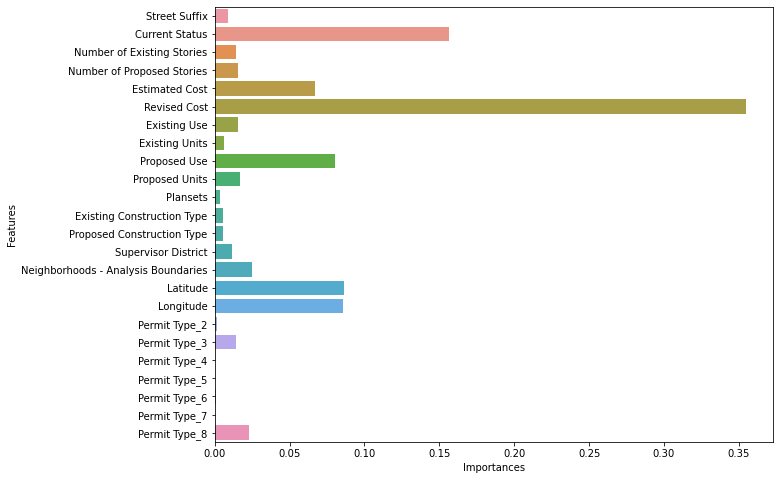

In [139]:
df_feature_dt = pd.DataFrame({'Features':Xtrain.columns,'Importances':dt_model_f.feature_importances_})
plt.figure(figsize=(10,8))
sns.barplot(y=df_feature_dt['Features'],x=df_feature_dt['Importances'])

From above graph, we can interpret that, only columns Street Suffix, Current Status, Number of Existing Stories, Number of Proposed Stories, Estimated Cost, Revised Cost, Existing Use, Existing Units, Proposed Use, Proposed Units, Plansets, Existing Construction Type, Proposed Construction Type, Supervisor District, Neighborhoods-Analysis Boundaries, Latitude, Longitude, Permit Type_3 and Permit Type_8 have feature importances greater than zero. So, we will build a model using those features only.

In [140]:
list_features =['Street Suffix', 'Current Status', 'Number of Existing Stories', 'Number of Proposed Stories', 'Estimated Cost', 
                 'Revised Cost', 'Existing Use', 'Existing Units' , 'Proposed Use', 'Proposed Units', 'Plansets',
                    'Existing Construction Type', 'Proposed Construction Type', 'Supervisor District', 
                    'Neighborhoods - Analysis Boundaries', 'Latitude', 'Longitude', 'Permit Type_3' , 'Permit Type_8' ]

In [147]:
decision_tree_base(Xtrain[list_features],Xtest[list_features],ytrain,ytest)
dict_dt['Model_Name'] = 'Decision Tree using Feature Importances'
df_feat_sel = df_feat_sel.append(dict_dt,ignore_index=True)

The accuracy score for training set is  0.999183306790804
The accuracy score for testing set is  0.8939596036585366


### Scores after performing various Feature Selection techniques

In [148]:
df_feat_sel

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
0,Decision Tree using VIF,0.999102,0.891959,0.936364,0.693111,0.931802,0.708645,0.934077,0.700792
1,Decision Tree using Forward Selection,0.937319,0.911585,0.932636,0.794888,0.961842,0.680363,0.947014,0.733180
2,Decision Tree using Backward Elimination,0.932745,0.911776,0.941588,0.765993,0.951635,0.728388,0.946585,0.746718
3,Decision Tree using RFE,0.999142,0.895293,0.935914,0.707552,0.936674,0.704909,0.936294,0.706228
4,Decision Tree using Feature Importances,0.999183,0.893960,0.936316,0.701216,0.934470,0.707577,0.935392,0.704382


In [151]:
print(df_feat_sel[df_feat_sel['Training_Accuracy'] == df_feat_sel['Training_Accuracy'].max()]['Model_Name'])
print(df_feat_sel[df_feat_sel['Testing_Accuracy'] == df_feat_sel['Testing_Accuracy'].max()]['Model_Name'])
print(df_feat_sel[df_feat_sel['Precision_Class_0'] == df_feat_sel['Precision_Class_0'].max()]['Model_Name'])
print(df_feat_sel[df_feat_sel['Precision_Class_1'] == df_feat_sel['Precision_Class_1'].max()]['Model_Name'])
print(df_feat_sel[df_feat_sel['Recall_Class_0'] == df_feat_sel['Recall_Class_0'].max()]['Model_Name'])
print(df_feat_sel[df_feat_sel['Recall_Class_1'] == df_feat_sel['Recall_Class_1'].max()]['Model_Name'])
print(df_feat_sel[df_feat_sel['F1_Score_Class_0'] == df_feat_sel['F1_Score_Class_0'].max()]['Model_Name'])
print(df_feat_sel[df_feat_sel['F1_Score_Class_1'] == df_feat_sel['F1_Score_Class_1'].max()]['Model_Name'])

4    Decision Tree using Feature Importances
Name: Model_Name, dtype: object
2    Decision Tree using Backward Elimination
Name: Model_Name, dtype: object
2    Decision Tree using Backward Elimination
Name: Model_Name, dtype: object
1    Decision Tree using Forward Selection
Name: Model_Name, dtype: object
1    Decision Tree using Forward Selection
Name: Model_Name, dtype: object
2    Decision Tree using Backward Elimination
Name: Model_Name, dtype: object
1    Decision Tree using Forward Selection
Name: Model_Name, dtype: object
2    Decision Tree using Backward Elimination
Name: Model_Name, dtype: object


Since, the Decision Tree model built using Backward Elimination has the maximum scores, we will be using the features obtained from Backward Elimination while tuning the hyperparameters 

### Comparing above results with the results obtained from Base Model

#### Using feature selection technique

In [155]:
df_base_acc[df_base_acc['Model_Name'] == 'Decision Tree']

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
1,Decision Tree,0.999183,0.894722,0.936882,0.703117,0.934818,0.710245,0.935849,0.706663


#### Base model

In [156]:
df_feat_sel[df_feat_sel['Model_Name'] == 'Decision Tree using Backward Elimination']

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
2,Decision Tree using Backward Elimination,0.932745,0.911776,0.941588,0.765993,0.951635,0.728388,0.946585,0.746718


From above data, we can see that, the best score is obtained by the Decsion tree model built using features obtained from Backward Elimination. Since, the model is more accurately explained using less number of features, we will be further using features obtained from Backward Elimination for various processes.

<a id="tuneall"></a>
## 23. Tuning the hyperparameters using all features

In [189]:
df_grid_all = pd.DataFrame(columns = ['Model_Name','Training_Accuracy','Testing_Accuracy','Precision_Class_0',
                                      'Precision_Class_1','Recall_Class_0','Recall_Class_1','F1_Score_Class_0',
                                     'F1_Score_Class_1'])

<a id="lra"></a>
### 1. Logistic Regression

In [1]:
params_lr = [{'penalty': ['l1', 'l2'], 
                     'C': [0.01,0.1,1.0,10]}]
lr = LogisticRegression(random_state=1 , class_weight = 'balanced',multi_class = 'ovr')
grid_lr = GridSearchCV(estimator = lr , param_grid=params_lr , cv = 5)
grid_lr_model = grid_lr.fit(Xtrain,ytrain)
print('Best parameters using GridSearchCV are: ', grid_lr_model.best_params_)

Best parameters using GridSearchCV are:  {'C': 10, 'penalty': 'l2'}


In [2]:
lr_grid = LogisticRegression(penalty = 'l2',
                                  C = 10,
                                  random_state=1 , class_weight = 'balanced',multi_class = 'ovr')

lr_model_grid = lr_grid.fit(Xtrain, ytrain)

In [4]:
#### Calculating accuracy score for training set
y_pred_train_grid_lr = lr_model_grid.predict(Xtrain)
acc_score_train_grid_lr = accuracy_score(ytrain , y_pred_train_grid_lr)
print("The accuracy score for training set is ",acc_score_train_grid_lr)

#### Calculating accuracy score for testing set
y_pred_test_grid_lr = lr_model_grid.predict(Xtest)
acc_score_test_grid_lr = accuracy_score(ytest , y_pred_test_grid_lr)
print("The accuracy score for testing set is ",acc_score_test_grid_lr)

The accuracy score for training set is  0.849524
The accuracy score for testing set is  0.843274


In [5]:
#### Confusion matrix
cm_lr = confusion_matrix(ytest, y_pred_test_grid_lr)

#### Precision for class 0
prec_c0_lr = cm_lr[0,0] / (cm_lr[0,0] + cm_lr[1,0])
#### Precision for class 1
prec_c1_lr  = cm_lr[1,1] / (cm_lr[1,1]+cm_lr[0,1])

#### Recall for class 0
specificity_lr = cm_lr[0,0] /(cm_lr[0,0] + cm_lr[0,1])
## Recall for class 1
specificity_lr = cm_lr[1,1] / (cm_lr[1,0] + cm_lr[1,1])

## F1-score for class 0
f1_0_lr = 2*(prec_c0_lr * specificity_lr) / (prec_c0_lr + specificity_lr)
## F1-score for class 1
f1_1_lr = 2*(prec_c1_lr * sensitivity_lr) / (prec_c1_lr + sensitivity_lr)

In [6]:
df_grid_all = df_grid_all.append({'Model_Name':'Logistics Regression','Training_Accuracy':acc_score_train_grid_lr,
                                 'Testing_Accuracy':acc_score_test_grid_lr,'Precision_Class_0':prec_c0_lr,
                                 'Precision_Class_1':prec_c1_lr,'Recall_Class_0':specificity_lr,
                                 'Recall_Class_1':sensitivity_lr,'F1_Score_Class_0':f1_0_lr,
                                 'F1_Score_Class_1':f1_1_lr},ignore_index=True)

<a id="dta"></a>
### 2. Decision Tree

In [191]:
params_dt = [{'criterion': ['entropy', 'gini'], 
                     'max_depth': range(2, 5),
                     'min_samples_split': range(2,5),
                     'min_samples_leaf': range(1,5),
                     'max_leaf_nodes': range(1, 5)}]
dt = DecisionTreeClassifier(random_state=1 , class_weight = 'balanced')
grid_dt = GridSearchCV(estimator = dt , param_grid=params_dt , cv = 5)
grid_dt_model = grid_dt.fit(Xtrain,ytrain)
print('Best parameters using GridSearchCV are: ', grid_dt_model.best_params_)

Best parameters using GridSearchCV are:  {'criterion': 'entropy', 'max_depth': 2, 'max_leaf_nodes': 2, 'min_samples_leaf': 1, 'min_samples_split': 2}


In [192]:
dt_grid = DecisionTreeClassifier(criterion = 'entropy',
                                  max_depth = 2,
                                  max_leaf_nodes = 2,
                                  min_samples_leaf = 1,
                                  min_samples_split = 2,
                                  random_state = 1,class_weight = 'balanced')

dt_model_grid = dt_grid.fit(Xtrain, ytrain)

In [193]:
#### Calculating accuracy score for training set
y_pred_train_grid_dt = dt_model_grid.predict(Xtrain)
acc_score_train_grid_dt = accuracy_score(ytrain , y_pred_train_grid_dt)
print("The accuracy score for training set is ",acc_score_train_grid_dt)

#### Calculating accuracy score for testing set
y_pred_test_grid_dt = dt_model_grid.predict(Xtest)
acc_score_test_grid_dt = accuracy_score(ytest , y_pred_test_grid_dt)
print("The accuracy score for testing set is ",acc_score_test_grid_dt)

The accuracy score for training set is  0.8414390134346033
The accuracy score for testing set is  0.8326981707317073


In [194]:
#### Confusion matrix
cm_dt = confusion_matrix(ytest, y_pred_test_grid_dt)

#### Precision for class 0
prec_c0_dt = cm_dt[0,0] / (cm_dt[0,0] + cm_dt[1,0])
#### Precision for class 1
prec_c1_dt  = cm_dt[1,1] / (cm_dt[1,1]+cm_dt[0,1])

#### Recall for class 0
specificity_dt = cm_dt[0,0] /(cm_dt[0,0] + cm_dt[0,1])
## Recall for class 1
sensitivity_dt = cm_dt[1,1] / (cm_dt[1,0] + cm_dt[1,1])

## F1-score for class 0
f1_0_dt = 2*(prec_c0_dt * specificity_dt) / (prec_c0_dt + specificity_dt)
## F1-score for class 1
f1_1_dt = 2*(prec_c1_dt * sensitivity_dt) / (prec_c1_dt + sensitivity_dt)

In [195]:
df_grid_all = df_grid_all.append({'Model_Name':'Decision Tree','Training_Accuracy':acc_score_train_grid_dt,
                                 'Testing_Accuracy':acc_score_test_grid_dt,'Precision_Class_0':prec_c0_dt,
                                 'Precision_Class_1':prec_c1_dt,'Recall_Class_0':specificity_dt,
                                 'Recall_Class_1':sensitivity_dt,'F1_Score_Class_0':f1_0_dt,
                                 'F1_Score_Class_1':f1_1_dt},ignore_index=True)

<a id="rfa"></a>
### 3. Random Forest

In [196]:
params_rf = [{'criterion': ['entropy', 'gini'],
                     'n_estimators': [10, 30, 50],
                     'max_depth': [10, 15, 20],
                     'min_samples_split': [2, 5, 8],
                     'min_samples_leaf': [1, 5, 9],
                     'max_leaf_nodes': [2, 5, 8]}]
rf = RandomForestClassifier(random_state=1,class_weight='balanced') 
grid_rf = GridSearchCV(estimator = rf , param_grid=params_rf , cv = 5)
grid_rf_model = grid_rf.fit(Xtrain,ytrain)
print('Best parameters using GridSearchCV are: ', grid_rf_model.best_params_)

Best parameters using GridSearchCV are:  {'criterion': 'entropy', 'max_depth': 10, 'max_leaf_nodes': 5, 'min_samples_leaf': 5, 'min_samples_split': 2, 'n_estimators': 10}


In [197]:
rf_grid = RandomForestClassifier(criterion = 'entropy', 
                                  n_estimators = 10,
                                  max_depth = 10,
                                  max_leaf_nodes = 5,
                                  min_samples_leaf = 5,
                                  min_samples_split = 2,
                                  random_state = 1,class_weight='balanced')

rf_model_grid = rf_grid.fit(Xtrain, ytrain)

In [198]:
#### Calculating accuracy score for training set
y_pred_train_grid_rf = rf_model_grid.predict(Xtrain)
acc_score_train_grid_rf = accuracy_score(ytrain , y_pred_train_grid_rf)
print("The accuracy score for training set is ",acc_score_train_grid_rf)

#### Calculating accuracy score for testing set
y_pred_test_grid_rf = rf_model_grid.predict(Xtest)
acc_score_test_grid_rf = accuracy_score(ytest , y_pred_test_grid_rf)
print("The accuracy score for testing set is ",acc_score_test_grid_rf)

The accuracy score for training set is  0.7986851239331945
The accuracy score for testing set is  0.7906821646341463


In [199]:
#### Confusion matrix
cm_rf = confusion_matrix(ytest, y_pred_test_grid_rf)

#### Precision for class 0
prec_c0_rf = cm_rf[0,0] / (cm_rf[0,0] + cm_rf[1,0])
#### Precision for class 1
prec_c1_rf  = cm_rf[1,1] / (cm_rf[1,1]+cm_rf[0,1])

#### Recall for class 0
specificity_rf = cm_rf[0,0] /(cm_rf[0,0] + cm_rf[0,1])
## Recall for class 1
sensitivity_rf = cm_rf[1,1] / (cm_rf[1,0] + cm_rf[1,1])

## F1-score for class 0
f1_0_rf = 2*(prec_c0_rf * specificity_rf) / (prec_c0_rf + specificity_rf)
## F1-score for class 1
f1_1_rf = 2*(prec_c1_rf * sensitivity_rf) / (prec_c1_rf + sensitivity_rf)

In [200]:
df_grid_all = df_grid_all.append({'Model_Name':'Random Forest','Training_Accuracy':acc_score_train_grid_rf,
                                 'Testing_Accuracy':acc_score_test_grid_rf,'Precision_Class_0':prec_c0_rf,
                                 'Precision_Class_1':prec_c1_rf,'Recall_Class_0':specificity_rf,
                                 'Recall_Class_1':sensitivity_rf,'F1_Score_Class_0':f1_0_rf,
                                 'F1_Score_Class_1':f1_1_rf},ignore_index=True)

<a id="knna"></a>
### 4. K Nearest Neighbors

In [201]:
params_knn = {'n_neighbors': np.arange(1, 15, 2),
                   'metric': ['hamming','euclidean','manhattan','Chebyshev']}
knn = KNeighborsClassifier()
grid_knn = GridSearchCV(estimator = knn , param_grid=params_knn , cv = 5)
grid_knn_model = grid_knn.fit(Xtrain,ytrain)
print('Best parameters using GridSearchCV are: ', grid_knn_model.best_params_)

Best parameters using GridSearchCV are:  {'metric': 'hamming', 'n_neighbors': 9}


In [202]:
knn_grid = KNeighborsClassifier(n_neighbors=9 , metric='hamming')
knn_model_grid = knn_grid.fit(Xtrain, ytrain)

In [203]:
#### Calculating accuracy score for training set
y_pred_train_grid_knn = knn_model_grid.predict(Xtrain)
acc_score_train_grid_knn = accuracy_score(ytrain , y_pred_train_grid_knn)
print("The accuracy score for training set is ",acc_score_train_grid_knn)

#### Calculating accuracy score for testing set
y_pred_test_grid_knn = knn_model_grid.predict(Xtest)
acc_score_test_grid_knn = accuracy_score(ytest , y_pred_test_grid_knn)
print("The accuracy score for testing set is ",acc_score_test_grid_knn)

The accuracy score for training set is  0.8992200579852179
The accuracy score for testing set is  0.8708079268292683


In [204]:
#### Confusion matrix
cm_knn = confusion_matrix(ytest, y_pred_test_grid_knn)

#### Precision for class 0
prec_c0_knn= cm_knn[0,0] / (cm_knn[0,0] + cm_knn[1,0])
#### Precision for class 1
prec_c1_knn  = cm_knn[1,1] / (cm_knn[1,1]+cm_knn[0,1])

#### Recall for class 0
specificity_knn = cm_knn[0,0] /(cm_knn[0,0] + cm_knn[0,1])
## Recall for class 1
sensitivity_knn = cm_knn[1,1] / (cm_knn[1,0] + cm_knn[1,1])

## F1-score for class 0
f1_0_knn = 2*(prec_c0_knn * specificity_knn) / (prec_c0_knn + specificity_knn)
## F1-score for class 1
f1_1_knn = 2*(prec_c1_knn * sensitivity_knn) / (prec_c1_knn + sensitivity_knn)

In [205]:
df_grid_all = df_grid_all.append({'Model_Name':'KNN','Training_Accuracy':acc_score_train_grid_knn,
                                 'Testing_Accuracy':acc_score_test_grid_knn,'Precision_Class_0':prec_c0_knn,
                                 'Precision_Class_1':prec_c1_knn,'Recall_Class_0':specificity_knn,
                                 'Recall_Class_1':sensitivity_knn,'F1_Score_Class_0':f1_0_knn,
                                 'F1_Score_Class_1':f1_1_knn},ignore_index=True)

<a id="adaa"></a>
### 5. AdaBoost

In [207]:
params_ada = {'learning_rate': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6],
                'n_estimators' : [10,30,50,70]}
ada = AdaBoostClassifier(random_state = 10)
grid_ada = GridSearchCV(estimator = ada , param_grid=params_ada , cv = 5)
grid_ada_model = grid_ada.fit(Xtrain,ytrain)
print('Best parameters using GridSearchCV are: ', grid_ada_model.best_params_)

Best parameters using GridSearchCV are:  {'learning_rate': 0.6, 'n_estimators': 70}


In [208]:
ada_grid = AdaBoostClassifier(learning_rate=0.6 , n_estimators=70)
ada_model_grid = ada_grid.fit(Xtrain, ytrain)

In [209]:
#### Calculating accuracy score for training set
y_pred_train_grid_ada = ada_model_grid.predict(Xtrain)
acc_score_train_grid_ada = accuracy_score(ytrain , y_pred_train_grid_ada)
print("The accuracy score for training set is ",acc_score_train_grid_ada)

#### Calculating accuracy score for testing set
y_pred_test_grid_ada = ada_model_grid.predict(Xtest)
acc_score_test_grid_ada = accuracy_score(ytest , y_pred_test_grid_ada)
print("The accuracy score for testing set is ",acc_score_test_grid_ada)

The accuracy score for training set is  0.877741026583364
The accuracy score for testing set is  0.8733803353658537


In [210]:
#### Confusion matrix
cm_ada = confusion_matrix(ytest, y_pred_test_grid_ada)

#### Precision for class 0
prec_c0_ada= cm_ada[0,0] / (cm_ada[0,0] + cm_ada[1,0])
#### Precision for class 1
prec_c1_ada  = cm_ada[1,1] / (cm_ada[1,1]+cm_ada[0,1])

#### Recall for class 0
specificity_ada = cm_ada[0,0] /(cm_ada[0,0] + cm_ada[0,1])
## Recall for class 1
sensitivity_ada = cm_ada[1,1] / (cm_ada[1,0] + cm_ada[1,1])

## F1-score for class 0
f1_0_ada = 2*(prec_c0_ada * specificity_ada) / (prec_c0_ada + specificity_ada)
## F1-score for class 1
f1_1_ada = 2*(prec_c1_ada * sensitivity_ada) / (prec_c1_ada + sensitivity_ada)

In [211]:
df_grid_all = df_grid_all.append({'Model_Name':'AdaBoost','Training_Accuracy':acc_score_train_grid_ada,
                                 'Testing_Accuracy':acc_score_test_grid_ada,'Precision_Class_0':prec_c0_ada,
                                 'Precision_Class_1':prec_c1_ada,'Recall_Class_0':specificity_ada,
                                 'Recall_Class_1':sensitivity_ada,'F1_Score_Class_0':f1_0_ada,
                                 'F1_Score_Class_1':f1_1_ada},ignore_index=True)

<a id="gbsa"></a>
### 6. Gradient Boosting

In [213]:
params_gbs = {'learning_rate': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6],
                'n_estimators' : [10,30,50,70],
                'max_depth': range(2, 5),
                'min_samples_split': range(2,5),
                'min_samples_leaf': range(1,5),
                'max_leaf_nodes': range(1, 5)}
gbs = GradientBoostingClassifier(random_state = 10)
grid_gbs = GridSearchCV(estimator = gbs , param_grid=params_gbs , cv = 5)
grid_gbs_model = grid_gbs.fit(Xtrain,ytrain)
print('Best parameters using GridSearchCV are: ', grid_gbs_model.best_params_)

Best parameters using GridSearchCV are:  {'learning_rate': 0.5, 'max_depth': 3, 'max_leaf_nodes': 4, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 50}


In [214]:
gbs_grid = GradientBoostingClassifier(learning_rate=0.5 , n_estimators=50, max_depth = 3 , min_samples_split = 2,
                                     min_samples_leaf= 1 , max_leaf_nodes = 4 , random_state = 10)
gbs_model_grid = gbs_grid.fit(Xtrain, ytrain)

In [215]:
#### Calculating accuracy score for training set
y_pred_train_grid_gbs = gbs_model_grid.predict(Xtrain)
acc_score_train_grid_gbs = accuracy_score(ytrain , y_pred_train_grid_gbs)
print("The accuracy score for training set is ",acc_score_train_grid_gbs)

#### Calculating accuracy score for testing set
y_pred_test_grid_gbs = gbs_model_grid.predict(Xtest)
acc_score_test_grid_gbs = accuracy_score(ytest , y_pred_test_grid_gbs)
print("The accuracy score for testing set is ",acc_score_test_grid_gbs)

The accuracy score for training set is  0.9251500673771897
The accuracy score for testing set is  0.9193978658536586


In [216]:
#### Confusion matrix
cm_gbs = confusion_matrix(ytest, y_pred_test_grid_gbs)

#### Precision for class 0
prec_c0_gbs= cm_gbs[0,0] / (cm_gbs[0,0] + cm_gbs[1,0])
#### Precision for class 1
prec_c1_gbs  = cm_gbs[1,1] / (cm_gbs[1,1]+cm_gbs[0,1])

#### Recall for class 0
specificity_gbs = cm_gbs[0,0] /(cm_gbs[0,0] + cm_gbs[0,1])
## Recall for class 1
sensitivity_gbs = cm_gbs[1,1] / (cm_gbs[1,0] + cm_gbs[1,1])

## F1-score for class 0
f1_0_gbs = 2*(prec_c0_gbs * specificity_gbs) / (prec_c0_gbs + specificity_gbs)
## F1-score for class 1
f1_1_gbs = 2*(prec_c1_gbs * sensitivity_gbs) / (prec_c1_gbs + sensitivity_gbs)

In [217]:
df_grid_all = df_grid_all.append({'Model_Name':'Gradient Boosting','Training_Accuracy':acc_score_train_grid_gbs,
                                 'Testing_Accuracy':acc_score_test_grid_gbs,'Precision_Class_0':prec_c0_gbs,
                                 'Precision_Class_1':prec_c1_gbs,'Recall_Class_0':specificity_gbs,
                                 'Recall_Class_1':sensitivity_gbs,'F1_Score_Class_0':f1_0_gbs,
                                 'F1_Score_Class_1':f1_1_gbs},ignore_index=True)

<a id="xgba"></a>
### 7. XGBoost

In [218]:
params_xgb = {'learning_rate': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6],
                     'max_depth': range(3,10),
                     'gamma': [0, 1, 2, 3, 4]}
xgb = XGBClassifier()
grid_xgb = GridSearchCV(estimator = xgb , param_grid=params_xgb , cv = 5)
grid_xgb_model = grid_xgb.fit(Xtrain,ytrain)
print('Best parameters using GridSearchCV are: ', grid_xgb_model.best_params_)

[02:35:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:35:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:35:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:35:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:35:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:35:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:35:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:35:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:36:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:36:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:36:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:36:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:36:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:36:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:36:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:36:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:37:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:37:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:37:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:37:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:37:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:37:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:37:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:37:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:38:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:38:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:38:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:38:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:38:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:38:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:38:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:38:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:39:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:39:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:39:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:39:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:39:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:39:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:39:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:39:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:40:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:40:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:40:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:40:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:40:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:40:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:40:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:40:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:41:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:41:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:41:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:41:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:41:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:41:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:41:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:41:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:42:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:42:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:42:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:42:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:42:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:42:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:42:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:42:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:43:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:43:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:43:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:43:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:43:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:43:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:43:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:43:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:44:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:44:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:44:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:44:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:44:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:44:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:44:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:44:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:45:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:45:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:45:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:45:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:45:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:45:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:45:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:45:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:46:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:46:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:46:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:46:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:46:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:46:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:46:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:46:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:46:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:46:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:46:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:47:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:47:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:47:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:47:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:47:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:47:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:47:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:48:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:48:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:48:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:48:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:48:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:48:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:48:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:48:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:48:55] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:48:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:49:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:49:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:49:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:49:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:49:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:49:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:49:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:49:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:50:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:50:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:50:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:50:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:50:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:50:47] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:50:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:50:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:51:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:51:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:51:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:51:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:51:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:51:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:51:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:51:46] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:52:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:52:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:52:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:52:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:52:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:52:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:52:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:52:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:53:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:53:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:53:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:53:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[02:53:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:53:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:53:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:53:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

In [219]:
xgb_grid = XGBClassifier(learning_rate=0.1 , max_depth = 7, gamma=4)
xgb_model_grid = xgb_grid.fit(Xtrain, ytrain)

[02:56:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [220]:
#### Calculating accuracy score for training set
y_pred_train_grid_xgb = xgb_model_grid.predict(Xtrain)
acc_score_train_grid_xgb = accuracy_score(ytrain , y_pred_train_grid_xgb)
print("The accuracy score for training set is ",acc_score_train_grid_xgb)

#### Calculating accuracy score for testing set
y_pred_test_grid_xgb = xgb_model_grid.predict(Xtest)
acc_score_test_grid_xgb = accuracy_score(ytest , y_pred_test_grid_xgb)
print("The accuracy score for testing set is ",acc_score_test_grid_xgb)

The accuracy score for training set is  0.9356037404548981
The accuracy score for testing set is  0.9235899390243902


In [221]:
#### Confusion matrix
cm_xgb = confusion_matrix(ytest, y_pred_test_grid_xgb)

#### Precision for class 0
prec_c0_xgb= cm_xgb[0,0] / (cm_xgb[0,0] + cm_xgb[1,0])
#### Precision for class 1
prec_c1_xgb  = cm_xgb[1,1] / (cm_xgb[1,1]+cm_xgb[0,1])

#### Recall for class 0
specificity_xgb = cm_xgb[0,0] /(cm_xgb[0,0] + cm_xgb[0,1])
## Recall for class 1
sensitivity_xgb = cm_xgb[1,1] / (cm_xgb[1,0] + cm_xgb[1,1])

## F1-score for class 0
f1_0_xgb = 2*(prec_c0_xgb * specificity_xgb) / (prec_c0_xgb + specificity_xgb)
## F1-score for class 1
f1_1_xgb = 2*(prec_c1_xgb * sensitivity_xgb) / (prec_c1_xgb + sensitivity_xgb)

In [222]:
df_grid_all = df_grid_all.append({'Model_Name':'XGBoost','Training_Accuracy':acc_score_train_grid_xgb,
                                 'Testing_Accuracy':acc_score_test_grid_xgb,'Precision_Class_0':prec_c0_xgb,
                                 'Precision_Class_1':prec_c1_xgb,'Recall_Class_0':specificity_xgb,
                                 'Recall_Class_1':sensitivity_xgb,'F1_Score_Class_0':f1_0_xgb,
                                 'F1_Score_Class_1':f1_1_xgb},ignore_index=True)

In [223]:
df_grid_all

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
0,Logistic Regression,0.849524,0.843274,0.888864,0.575082,0.924843,0.467983,0.906497,0.516034
1,Decision Tree,0.841439,0.832698,0.938330,0.522147,0.852354,0.742263,0.893278,0.613045
2,Random Forest,0.798685,0.790682,0.972079,0.456245,0.767223,0.898613,0.857587,0.605211
3,KNN,0.899220,0.870808,0.907287,0.664340,0.938645,0.558698,0.922700,0.606957
4,AdaBoost,0.877741,0.873380,0.913576,0.662299,0.934238,0.593383,0.923792,0.625950
5,Gradient Boosting,0.925150,0.919398,0.943026,0.798837,0.959870,0.733191,0.951374,0.764608
6,XGBoost,0.935604,0.923590,0.946143,0.809469,0.961726,0.748132,0.953871,0.777593


<a id="tune"></a>
## 24. Tuning the hyperparameters with Feature Selection

Hyperparameters will be tuned by using the features obtained from Backward Elimination in above process

In [152]:
df_grid = pd.DataFrame(columns = ['Model_Name','Training_Accuracy','Testing_Accuracy','Precision_Class_0',
                                      'Precision_Class_1','Recall_Class_0','Recall_Class_1','F1_Score_Class_0',
                                     'F1_Score_Class_1'])

<a id="lrt"></a>
### 1. Logistic Regression

In [1]:
params_lr = [{'penalty': ['l1', 'l2'], 
                     'C': [0.01,0.1,1.0,10]}]
lr = LogisticRegression(random_state=1 , class_weight = 'balanced',multi_class = 'ovr')
grid_lr = GridSearchCV(estimator = lr , param_grid=params_lr , cv = 5)
grid_lr_model = grid_lr.fit(Xtrain,ytrain)
print('Best parameters using GridSearchCV are: ', grid_lr_model.best_params_)

Best parameters using GridSearchCV are:  {'C': 10, 'penalty': 'l2'}


In [2]:
lr_grid = LogisticRegression(penalty = 'l2',
                                  C = 10,
                                  random_state=1 , class_weight = 'balanced',multi_class = 'ovr')

lr_model_grid = lr_grid.fit(Xtrain, ytrain)

In [7]:
#### Calculating accuracy score for training set
y_pred_train_grid_lr = lr_model_grid.predict(Xtrain)
acc_score_train_grid_lr = accuracy_score(ytrain , y_pred_train_grid_lr)
print("The accuracy score for training set is ",acc_score_train_grid_lr)

#### Calculating accuracy score for testing set
y_pred_test_grid_lr = lr_model_grid.predict(Xtest)
acc_score_test_grid_lr = accuracy_score(ytest , y_pred_test_grid_lr)
print("The accuracy score for testing set is ",acc_score_test_grid_lr)

The accuracy score for training set is  0.8266568663481563
The accuracy score for testing set is  0.82421875


In [5]:
#### Confusion matrix
cm_lr = confusion_matrix(ytest, y_pred_test_grid_lr)

#### Precision for class 0
prec_c0_lr = cm_lr[0,0] / (cm_lr[0,0] + cm_lr[1,0])
#### Precision for class 1
prec_c1_lr  = cm_lr[1,1] / (cm_lr[1,1]+cm_lr[0,1])

#### Recall for class 0
specificity_lr = cm_lr[0,0] /(cm_lr[0,0] + cm_lr[0,1])
## Recall for class 1
specificity_lr = cm_lr[1,1] / (cm_lr[1,0] + cm_lr[1,1])

## F1-score for class 0
f1_0_lr = 2*(prec_c0_lr * specificity_lr) / (prec_c0_lr + specificity_lr)
## F1-score for class 1
f1_1_lr = 2*(prec_c1_lr * sensitivity_lr) / (prec_c1_lr + sensitivity_lr)

In [6]:
df_grid_all = df_grid_all.append({'Model_Name':'Logistics Regression','Training_Accuracy':acc_score_train_grid_lr,
                                 'Testing_Accuracy':acc_score_test_grid_lr,'Precision_Class_0':prec_c0_lr,
                                 'Precision_Class_1':prec_c1_lr,'Recall_Class_0':specificity_lr,
                                 'Recall_Class_1':sensitivity_lr,'F1_Score_Class_0':f1_0_lr,
                                 'F1_Score_Class_1':f1_1_lr},ignore_index=True)

<a id="dtt"></a>
### 2. Decision Tree

In [157]:
params_dt = [{'criterion': ['entropy', 'gini'], 
                     'max_depth': range(2, 5),
                     'min_samples_split': range(2,5),
                     'min_samples_leaf': range(1,5),
                     'max_leaf_nodes': range(1, 5)}]
dt = DecisionTreeClassifier(random_state=1 , class_weight = 'balanced')
grid_dt = GridSearchCV(estimator = dt , param_grid=params_dt , cv = 5)
grid_dt_model = grid_dt.fit(Xtrain[list_back],ytrain)
print('Best parameters using GridSearchCV are: ', grid_dt_model.best_params_)

Best parameters using GridSearchCV are:  {'criterion': 'entropy', 'max_depth': 3, 'max_leaf_nodes': 4, 'min_samples_leaf': 1, 'min_samples_split': 2}


In [158]:
dt_grid = DecisionTreeClassifier(criterion = 'entropy',
                                  max_depth = 3,
                                  max_leaf_nodes = 4,
                                  min_samples_leaf = 1,
                                  min_samples_split = 2,
                                  random_state = 1,class_weight = 'balanced')

dt_model_grid = dt_grid.fit(Xtrain[list_back], ytrain)

In [159]:
#### Calculating accuracy score for training set
y_pred_train_grid_dt = dt_model_grid.predict(Xtrain[list_back])
acc_score_train_grid_dt = accuracy_score(ytrain , y_pred_train_grid_dt)
print("The accuracy score for training set is ",acc_score_train_grid_dt)

#### Calculating accuracy score for testing set
y_pred_test_grid_dt = dt_model_grid.predict(Xtest[list_back])
acc_score_test_grid_dt = accuracy_score(ytest , y_pred_test_grid_dt)
print("The accuracy score for testing set is ",acc_score_test_grid_dt)

The accuracy score for training set is  0.7737759810527175
The accuracy score for testing set is  0.7715320121951219


In [160]:
#### Confusion matrix
cm_dt = confusion_matrix(ytest, y_pred_test_grid_dt)

#### Precision for class 0
prec_c0_dt = cm_dt[0,0] / (cm_dt[0,0] + cm_dt[1,0])
#### Precision for class 1
prec_c1_dt  = cm_dt[1,1] / (cm_dt[1,1]+cm_dt[0,1])

#### Recall for class 0
specificity_dt = cm_dt[0,0] /(cm_dt[0,0] + cm_dt[0,1])
## Recall for class 1
sensitivity_dt = cm_dt[1,1] / (cm_dt[1,0] + cm_dt[1,1])

## F1-score for class 0
f1_0_dt = 2*(prec_c0_dt * specificity_dt) / (prec_c0_dt + specificity_dt)
## F1-score for class 1
f1_1_dt = 2*(prec_c1_dt * sensitivity_dt) / (prec_c1_dt + sensitivity_dt)

In [161]:
df_grid = df_grid.append({'Model_Name':'Decision Tree','Training_Accuracy':acc_score_train_grid_dt,
                                 'Testing_Accuracy':acc_score_test_grid_dt,'Precision_Class_0':prec_c0_dt,
                                 'Precision_Class_1':prec_c1_dt,'Recall_Class_0':specificity_dt,
                                 'Recall_Class_1':sensitivity_dt,'F1_Score_Class_0':f1_0_dt,
                                 'F1_Score_Class_1':f1_1_dt},ignore_index=True)

<a id="rft"></a>
### 3. Random Forest

In [162]:
params_rf = [{'criterion': ['entropy', 'gini'],
                     'n_estimators': [10, 30, 50],
                     'max_depth': [10, 15, 20],
                     'min_samples_split': [2, 5, 8],
                     'min_samples_leaf': [1, 5, 9],
                     'max_leaf_nodes': [2, 5, 8]}]
rf = RandomForestClassifier(random_state=1,class_weight='balanced') 
grid_rf = GridSearchCV(estimator = rf , param_grid=params_rf , cv = 5)
grid_rf_model = grid_rf.fit(Xtrain[list_back],ytrain)
print('Best parameters using GridSearchCV are: ', grid_rf_model.best_params_)

Best parameters using GridSearchCV are:  {'criterion': 'gini', 'max_depth': 10, 'max_leaf_nodes': 8, 'min_samples_leaf': 9, 'min_samples_split': 2, 'n_estimators': 30}


In [163]:
rf_grid = RandomForestClassifier(criterion = 'gini', 
                                  n_estimators = 30,
                                  max_depth = 10,
                                  max_leaf_nodes = 8,
                                  min_samples_leaf = 9,
                                  min_samples_split = 2,
                                  random_state = 1,class_weight='balanced')

rf_model_grid = rf_grid.fit(Xtrain[list_back], ytrain)

In [164]:
#### Calculating accuracy score for training set
y_pred_train_grid_rf = rf_model_grid.predict(Xtrain[list_back])
acc_score_train_grid_rf = accuracy_score(ytrain , y_pred_train_grid_rf)
print("The accuracy score for training set is ",acc_score_train_grid_rf)

#### Calculating accuracy score for testing set
y_pred_test_grid_rf = rf_model_grid.predict(Xtest[list_back])
acc_score_test_grid_rf = accuracy_score(ytest , y_pred_test_grid_rf)
print("The accuracy score for testing set is ",acc_score_test_grid_rf)

The accuracy score for training set is  0.8066478827228551
The accuracy score for testing set is  0.8039253048780488


In [165]:
#### Confusion matrix
cm_rf = confusion_matrix(ytest, y_pred_test_grid_rf)

#### Precision for class 0
prec_c0_rf = cm_rf[0,0] / (cm_rf[0,0] + cm_rf[1,0])
#### Precision for class 1
prec_c1_rf  = cm_rf[1,1] / (cm_rf[1,1]+cm_rf[0,1])

#### Recall for class 0
specificity_rf = cm_rf[0,0] /(cm_rf[0,0] + cm_rf[0,1])
## Recall for class 1
sensitivity_rf = cm_rf[1,1] / (cm_rf[1,0] + cm_rf[1,1])

## F1-score for class 0
f1_0_rf = 2*(prec_c0_rf * specificity_rf) / (prec_c0_rf + specificity_rf)
## F1-score for class 1
f1_1_rf = 2*(prec_c1_rf * sensitivity_rf) / (prec_c1_rf + sensitivity_rf)

In [166]:
df_grid = df_grid.append({'Model_Name':'Random Forest','Training_Accuracy':acc_score_train_grid_rf,
                                 'Testing_Accuracy':acc_score_test_grid_rf,'Precision_Class_0':prec_c0_rf,
                                 'Precision_Class_1':prec_c1_rf,'Recall_Class_0':specificity_rf,
                                 'Recall_Class_1':sensitivity_rf,'F1_Score_Class_0':f1_0_rf,
                                 'F1_Score_Class_1':f1_1_rf},ignore_index=True)

<a id="knnt"></a>
### 4. K Nearest Neighbors

In [167]:
params_knn = {'n_neighbors': np.arange(1, 15, 2),
                   'metric': ['hamming','euclidean','manhattan','Chebyshev']}
knn = KNeighborsClassifier()
grid_knn = GridSearchCV(estimator = knn , param_grid=params_knn , cv = 5)
grid_knn_model = grid_knn.fit(Xtrain[list_back],ytrain)
print('Best parameters using GridSearchCV are: ', grid_knn_model.best_params_)

Best parameters using GridSearchCV are:  {'metric': 'hamming', 'n_neighbors': 13}


In [168]:
knn_grid = KNeighborsClassifier(n_neighbors=13 , metric='hamming')
knn_model_grid = knn_grid.fit(Xtrain[list_back], ytrain)

In [170]:
#### Calculating accuracy score for training set
y_pred_train_grid_knn = knn_model_grid.predict(Xtrain[list_back])
acc_score_train_grid_knn = accuracy_score(ytrain , y_pred_train_grid_knn)
print("The accuracy score for training set is ",acc_score_train_grid_knn)

#### Calculating accuracy score for testing set
y_pred_test_grid_knn = knn_model_grid.predict(Xtest[list_back])
acc_score_test_grid_knn = accuracy_score(ytest , y_pred_test_grid_knn)
print("The accuracy score for testing set is ",acc_score_test_grid_knn)

The accuracy score for training set is  0.9142880476948834
The accuracy score for testing set is  0.9115853658536586


In [171]:
#### Confusion matrix
cm_knn = confusion_matrix(ytest, y_pred_test_grid_knn)

#### Precision for class 0
prec_c0_knn= cm_knn[0,0] / (cm_knn[0,0] + cm_knn[1,0])
#### Precision for class 1
prec_c1_knn  = cm_knn[1,1] / (cm_knn[1,1]+cm_knn[0,1])

#### Recall for class 0
specificity_knn = cm_knn[0,0] /(cm_knn[0,0] + cm_knn[0,1])
## Recall for class 1
sensitivity_knn = cm_knn[1,1] / (cm_knn[1,0] + cm_knn[1,1])

## F1-score for class 0
f1_0_knn = 2*(prec_c0_knn * specificity_knn) / (prec_c0_knn + specificity_knn)
## F1-score for class 1
f1_1_knn = 2*(prec_c1_knn * sensitivity_knn) / (prec_c1_knn + sensitivity_knn)

In [172]:
df_grid = df_grid.append({'Model_Name':'KNN','Training_Accuracy':acc_score_train_grid_knn,
                                 'Testing_Accuracy':acc_score_test_grid_knn,'Precision_Class_0':prec_c0_knn,
                                 'Precision_Class_1':prec_c1_knn,'Recall_Class_0':specificity_knn,
                                 'Recall_Class_1':sensitivity_knn,'F1_Score_Class_0':f1_0_knn,
                                 'F1_Score_Class_1':f1_1_knn},ignore_index=True)

<a id="adat"></a>
### 5. AdaBoost

In [173]:
params_ada = {'learning_rate': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6],
                'n_estimators' : [10,30,50,70]}
ada = AdaBoostClassifier(random_state = 10)
grid_ada = GridSearchCV(estimator = ada , param_grid=params_ada , cv = 5)
grid_ada_model = grid_ada.fit(Xtrain[list_back],ytrain)
print('Best parameters using GridSearchCV are: ', grid_ada_model.best_params_)

Best parameters using GridSearchCV are:  {'learning_rate': 0.5, 'n_estimators': 70}


In [174]:
ada_grid = AdaBoostClassifier(learning_rate=0.5 , n_estimators=70)
ada_model_grid = ada_grid.fit(Xtrain[list_back], ytrain)

In [175]:
#### Calculating accuracy score for training set
y_pred_train_grid_ada = ada_model_grid.predict(Xtrain[list_back])
acc_score_train_grid_ada = accuracy_score(ytrain , y_pred_train_grid_ada)
print("The accuracy score for training set is ",acc_score_train_grid_ada)

#### Calculating accuracy score for testing set
y_pred_test_grid_ada = ada_model_grid.predict(Xtest[list_back])
acc_score_test_grid_ada = accuracy_score(ytest , y_pred_test_grid_ada)
print("The accuracy score for testing set is ",acc_score_test_grid_ada)

The accuracy score for training set is  0.8830903671035976
The accuracy score for testing set is  0.8843368902439024


In [176]:
#### Confusion matrix
cm_ada = confusion_matrix(ytest, y_pred_test_grid_ada)

#### Precision for class 0
prec_c0_ada= cm_ada[0,0] / (cm_ada[0,0] + cm_ada[1,0])
#### Precision for class 1
prec_c1_ada  = cm_ada[1,1] / (cm_ada[1,1]+cm_ada[0,1])

#### Recall for class 0
specificity_ada = cm_ada[0,0] /(cm_ada[0,0] + cm_ada[0,1])
## Recall for class 1
sensitivity_ada = cm_ada[1,1] / (cm_ada[1,0] + cm_ada[1,1])

## F1-score for class 0
f1_0_ada = 2*(prec_c0_ada * specificity_ada) / (prec_c0_ada + specificity_ada)
## F1-score for class 1
f1_1_ada = 2*(prec_c1_ada * sensitivity_ada) / (prec_c1_ada + sensitivity_ada)

In [177]:
df_grid = df_grid.append({'Model_Name':'AdaBoost','Training_Accuracy':acc_score_train_grid_ada,
                                 'Testing_Accuracy':acc_score_test_grid_ada,'Precision_Class_0':prec_c0_ada,
                                 'Precision_Class_1':prec_c1_ada,'Recall_Class_0':specificity_ada,
                                 'Recall_Class_1':sensitivity_ada,'F1_Score_Class_0':f1_0_ada,
                                 'F1_Score_Class_1':f1_1_ada},ignore_index=True)

<a id="gbst"></a>
### 6. Gradient Boosting

In [178]:
params_gbs = {'learning_rate': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6],
                'n_estimators' : [10,30,50,70],
                'max_depth': range(2, 5),
                'min_samples_split': range(2,5),
                'min_samples_leaf': range(1,5),
                'max_leaf_nodes': range(1, 5)}
gbs = GradientBoostingClassifier(random_state = 10)
grid_gbs = GridSearchCV(estimator = gbs , param_grid=params_gbs , cv = 5)
grid_gbs_model = grid_gbs.fit(Xtrain[list_back],ytrain)
print('Best parameters using GridSearchCV are: ', grid_gbs_model.best_params_)

Best parameters using GridSearchCV are:  {'learning_rate': 0.6, 'max_depth': 3, 'max_leaf_nodes': 4, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 70}


In [179]:
gbs_grid = GradientBoostingClassifier(learning_rate=0.6 , n_estimators=70, max_depth = 3 , min_samples_split = 2,
                                     min_samples_leaf= 1 , max_leaf_nodes = 4 , random_state = 10)
gbs_model_grid = gbs_grid.fit(Xtrain[list_back], ytrain)

In [180]:
#### Calculating accuracy score for training set
y_pred_train_grid_gbs = gbs_model_grid.predict(Xtrain[list_back])
acc_score_train_grid_gbs = accuracy_score(ytrain , y_pred_train_grid_gbs)
print("The accuracy score for training set is ",acc_score_train_grid_gbs)

#### Calculating accuracy score for testing set
y_pred_test_grid_gbs = gbs_model_grid.predict(Xtest[list_back])
acc_score_test_grid_gbs = accuracy_score(ytest , y_pred_test_grid_gbs)
print("The accuracy score for testing set is ",acc_score_test_grid_gbs)

The accuracy score for training set is  0.9215566172567276
The accuracy score for testing set is  0.9141577743902439


In [181]:
#### Confusion matrix
cm_gbs = confusion_matrix(ytest, y_pred_test_grid_gbs)

#### Precision for class 0
prec_c0_gbs= cm_gbs[0,0] / (cm_gbs[0,0] + cm_gbs[1,0])
#### Precision for class 1
prec_c1_gbs  = cm_gbs[1,1] / (cm_gbs[1,1]+cm_gbs[0,1])

#### Recall for class 0
specificity_gbs = cm_gbs[0,0] /(cm_gbs[0,0] + cm_gbs[0,1])
## Recall for class 1
sensitivity_gbs = cm_gbs[1,1] / (cm_gbs[1,0] + cm_gbs[1,1])

## F1-score for class 0
f1_0_gbs = 2*(prec_c0_gbs * specificity_gbs) / (prec_c0_gbs + specificity_gbs)
## F1-score for class 1
f1_1_gbs = 2*(prec_c1_gbs * sensitivity_gbs) / (prec_c1_gbs + sensitivity_gbs)

In [182]:
df_grid = df_grid.append({'Model_Name':'Gradient Boosting','Training_Accuracy':acc_score_train_grid_gbs,
                                 'Testing_Accuracy':acc_score_test_grid_gbs,'Precision_Class_0':prec_c0_gbs,
                                 'Precision_Class_1':prec_c1_gbs,'Recall_Class_0':specificity_gbs,
                                 'Recall_Class_1':sensitivity_gbs,'F1_Score_Class_0':f1_0_gbs,
                                 'F1_Score_Class_1':f1_1_gbs},ignore_index=True)

<a id="xgbt"></a>
### 7. XGBoost

In [183]:
params_xgb = {'learning_rate': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6],
                     'max_depth': range(3,10),
                     'gamma': [0, 1, 2, 3, 4]}
xgb = XGBClassifier()
grid_xgb = GridSearchCV(estimator = xgb , param_grid=params_xgb , cv = 5)
grid_xgb_model = grid_xgb.fit(Xtrain[list_back],ytrain)
print('Best parameters using GridSearchCV are: ', grid_xgb_model.best_params_)

[01:07:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:07:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:07:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:07:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:07:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:08:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:08] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:08:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:08:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:08:35] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:08:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:08:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:09:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:09:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:09:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:26] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:09:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:09:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:09:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:54] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:09:54] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:10:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:10:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:10:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:10:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:10:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:10:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:11:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:11:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:11:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:11:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:11:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:11:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:11:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:12:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:12:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:12:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:12:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:12:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:41] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:12:50] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:12:51] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:13:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:13:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:13:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:21] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:13:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:30] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

[01:13:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:39] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[01:13:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

Best parameters using GridSearchCV are:  {'gamma': 4, 'learning_rate': 0.2, 'max_depth': 8}


In [184]:
xgb_grid = XGBClassifier(learning_rate=0.2 , max_depth = 8, gamma=4)
xgb_model_grid = xgb_grid.fit(Xtrain[list_back], ytrain)

[01:14:33] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [185]:
#### Calculating accuracy score for training set
y_pred_train_grid_xgb = xgb_model_grid.predict(Xtrain[list_back])
acc_score_train_grid_xgb = accuracy_score(ytrain , y_pred_train_grid_xgb)
print("The accuracy score for training set is ",acc_score_train_grid_xgb)

#### Calculating accuracy score for testing set
y_pred_test_grid_xgb = xgb_model_grid.predict(Xtest[list_back])
acc_score_test_grid_xgb = accuracy_score(ytest , y_pred_test_grid_xgb)
print("The accuracy score for testing set is ",acc_score_test_grid_xgb)

The accuracy score for training set is  0.9207399240475316
The accuracy score for testing set is  0.9161585365853658


In [186]:
#### Confusion matrix
cm_xgb = confusion_matrix(ytest, y_pred_test_grid_xgb)

#### Precision for class 0
prec_c0_xgb= cm_xgb[0,0] / (cm_xgb[0,0] + cm_xgb[1,0])
#### Precision for class 1
prec_c1_xgb  = cm_xgb[1,1] / (cm_xgb[1,1]+cm_xgb[0,1])

#### Recall for class 0
specificity_xgb = cm_xgb[0,0] /(cm_xgb[0,0] + cm_xgb[0,1])
## Recall for class 1
sensitivity_xgb = cm_xgb[1,1] / (cm_xgb[1,0] + cm_xgb[1,1])

## F1-score for class 0
f1_0_xgb = 2*(prec_c0_xgb * specificity_xgb) / (prec_c0_xgb + specificity_xgb)
## F1-score for class 1
f1_1_xgb = 2*(prec_c1_xgb * sensitivity_xgb) / (prec_c1_xgb + sensitivity_xgb)

In [187]:
df_grid = df_grid.append({'Model_Name':'XGBoost','Training_Accuracy':acc_score_train_grid_xgb,
                                 'Testing_Accuracy':acc_score_test_grid_xgb,'Precision_Class_0':prec_c0_xgb,
                                 'Precision_Class_1':prec_c1_xgb,'Recall_Class_0':specificity_xgb,
                                 'Recall_Class_1':sensitivity_xgb,'F1_Score_Class_0':f1_0_xgb,
                                 'F1_Score_Class_1':f1_1_xgb},ignore_index=True)

In [188]:
df_grid

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
0,Logistic Regression using Backward Elimination...,0.826657,0.824219,0.847788,0.519256,0.958014,0.208645,0.899537,0.297678
1,Decision Tree,0.773776,0.771532,0.998398,0.438382,0.723034,0.994664,0.838692,0.608554
2,Random Forest,0.806648,0.803925,0.996370,0.476313,0.764092,0.987193,0.864907,0.642584
3,KNN,0.914288,0.911585,0.929832,0.805951,0.965205,0.664888,0.947189,0.728655
4,AdaBoost,0.883090,0.884337,0.911373,0.721180,0.951751,0.574173,0.931124,0.639335
5,Gradient Boosting,0.921557,0.914158,0.941049,0.779116,0.955347,0.724653,0.948144,0.750899
6,XGBoost,0.920740,0.916159,0.939188,0.795482,0.960102,0.713981,0.949530,0.752531


<a id="scores"></a>
## 25. All scores

### Base Model scores

In [224]:
df_base_acc

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
0,Logistic Regression,0.849524,0.843274,0.888864,0.575082,0.924843,0.467983,0.906497,0.516034
1,Decision Tree,0.999183,0.894722,0.936882,0.703117,0.934818,0.710245,0.935849,0.706663
2,Random Forest,0.999183,0.914348,0.939456,0.785255,0.957434,0.716115,0.948360,0.749093
3,KNN Model,0.911225,0.862233,0.917501,0.612513,0.914521,0.621665,0.916008,0.617055
4,Naive Bayes,0.812283,0.809451,0.933150,0.477910,0.827302,0.727321,0.877044,0.576809
5,AdaBoost,0.884805,0.881955,0.917449,0.692075,0.940965,0.610459,0.929058,0.648710
6,Gradient Boosting,0.926130,0.921875,0.943598,0.809636,0.962422,0.735326,0.952917,0.770694
7,XGBoost,0.967863,0.916921,0.943465,0.784983,0.956159,0.736393,0.949770,0.759912


### Tuning the hyperparameters using all features

In [226]:
df_grid_all

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
0,Logistic Regression,0.849524,0.843274,0.888864,0.575082,0.924843,0.467983,0.906497,0.516034
1,Decision Tree,0.841439,0.832698,0.938330,0.522147,0.852354,0.742263,0.893278,0.613045
2,Random Forest,0.798685,0.790682,0.972079,0.456245,0.767223,0.898613,0.857587,0.605211
3,KNN,0.899220,0.870808,0.907287,0.664340,0.938645,0.558698,0.922700,0.606957
4,AdaBoost,0.877741,0.873380,0.913576,0.662299,0.934238,0.593383,0.923792,0.625950
5,Gradient Boosting,0.925150,0.919398,0.943026,0.798837,0.959870,0.733191,0.951374,0.764608
6,XGBoost,0.935604,0.923590,0.946143,0.809469,0.961726,0.748132,0.953871,0.777593


### Tuning the hyperparamaters with Feature Selection

In [227]:
df_grid

,Model_Name,Training_Accuracy,Testing_Accuracy,Precision_Class_0,Precision_Class_1,Recall_Class_0,Recall_Class_1,F1_Score_Class_0,F1_Score_Class_1
0,Logistic Regression using Backward Elimination...,0.826657,0.824219,0.847788,0.519256,0.958014,0.208645,0.899537,0.297678
1,Decision Tree,0.773776,0.771532,0.998398,0.438382,0.723034,0.994664,0.838692,0.608554
2,Random Forest,0.806648,0.803925,0.996370,0.476313,0.764092,0.987193,0.864907,0.642584
3,KNN,0.914288,0.911585,0.929832,0.805951,0.965205,0.664888,0.947189,0.728655
4,AdaBoost,0.883090,0.884337,0.911373,0.721180,0.951751,0.574173,0.931124,0.639335
5,Gradient Boosting,0.921557,0.914158,0.941049,0.779116,0.955347,0.724653,0.948144,0.750899
6,XGBoost,0.920740,0.916159,0.939188,0.795482,0.960102,0.713981,0.949530,0.752531


<a id="final"></a>
## 26. Final Model Selection

1. In the base models, there is considerable difference between the training and testing accuracies, which indicates presence of Over-fitting issue in the models. Hence, we cannot select our final model from the same
2. The accuracies of models built using Tuned Hyperparameters with all features and with selected features, is quite similar. But, if the model is accurately predicting the target using less number of features, so we can use the models built using Tuned hyperparameters with selected best features.
3. The evaluation metric which is to be used for finalizing the model is F1-score, because it considers both the Precision and Recall rate. Also, as per our business requirement, we need to minimize both the False Negative and False Positive scores and the same can be achieved with good F1-score.
4. After comparing all the F1-scores obtained above, the best performance is given by the XGBoost model built using Tuned Hyperparameters along with the features selected from best Feature Selection technique

<a id="summ"></a>
## 27. Summarizing the overall fit of the final model

1. The final XGBoost model was built using tuned hyperparameters, which are learning_rate = 0.2, max_depth = 8 and gamma = 4, and by using the features obtained from Backward Elimination technique, which are 'Current Status', 'Estimated Cost', 'Existing Units' and 'Permit Type_8'
2. The training and testing accuracy of the final XGBoost model is 92.07% and 91.61% respectively. Since, there is not much difference, it indicates that the model does not over-fit
3. The precision rate for class 0 for the final model is 93.91% and for class 1 is 79.54%. Similarly, the recall rate for class 0 is 96.01% and for class 1 is 71.39%.
4. The f1-score for class 0 for the final model is 94.95% and for class 1 is 75.25%

<a id="buss"></a>
## 28. Business Interpretation

1. According to the business requirement, the False Positive outputs indicates that the end-user or the contractor will be risking time and money both as well as, at some point, people's lives can also be at stake. Similarly, the False Negative outputs indicates the delaying of the business opportunity for the builder.
2. Both the above cases are not favorable according to our business requirement. Hence, we need to find the model with less False Positive and False Negative scores. This can be achieved in good F1-score.
3. Hence, F1-score is used as the model evaluation metric to select the final model.
4. F1-score is calculated by combining the precision and recall rates. The f1-score for class 0 for the final model is 94.95% and for class 1 is 75.25%. Since, both the f1-scores are high, we can say that the scores are significant
5. The accuracy of the final XGBoost model is around 92%, which indicates that the model predicts the target variable with around 92% accuracy. It means, it will predict whether the contractor or the end-user will receive the Site-Permit or not, with 92% accuracy.
6. Precision is a measure of quality. The precision rate for class 0 for the final model is 93.91% and for class 1 is 79.54%. It means, the number of records which are predicted with the Site Permit status as 'Y' is predicted with 79.54% precision, from the records that will actually receive the Site Permit. Similarly, the number of records which are predicted with the Site Permit status as 'N' is predicted with 93.91% precision, from the records that will actually not receive the Site Permit.
7. Recall is a measure of quantity. The recall rate for class 0 is 96.01% and for class 1 is 71.39%.

<a id="change"></a>
## 29. Changes done in Base Model to achieve Final Model

1. Firstly, the dataset count was reduced by performing Under-sampling. The count of records was reduced from 1.5 lakhs to around 39000
2. Feature selection technique was applied to select the best features amongst the list of all features. Features obtained from Backward Elimination was used while building final model
3. The hyperparameters of the XGBoost model were tuned using GridSearchCV algorithm. The best values were selected for the hyperparameters and they were used while building the final model.

<a id="key"></a>
## 30. Key Risks in interpreting the Final Model

1. All the models were built using the sample obtained from Under-sampling technique. This might be first risk in our final model, because the complete dataset was not used for building the model
2. There is presence of class imbalance in the dataset. It indicates the dominance of one class over other. It will predict the data with target value of dominant class more accurately as compared to the other class.
3. The final model was built using only the selected features obtained from Backward Elimination feature selection technique. All the features were not used while building the model. This might possess another risk while interpreting the final model. Beacuse, there might be a possibility, that the remaining features will predict the Site Permit status more accurately.
4. While performing hyperparameter tuning, only small range of values were used. The best values can be present beyond those range as well.
<br>
Above are all the key risks that can occur while interpreting the final model